https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSE128565
## Requirements and Imports

In [660]:
import copy
import os
from pathlib import Path
from itertools import combinations
import gc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import scanpy as sc
from numba import jit
from sklearn.metrics import roc_auc_score , pairwise_distances
import torch
import torch
from scipy import sparse
from sklearn.decomposition import PCA
from sklearn.preprocessing import normalize
# from pygsp import graphs, filters, plotting
import models, metrics
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

# Assuming that we are on a CUDA machine, this should print a CUDA device:
from scipy.stats import linregress
print(device)
from sklearn.linear_model import LinearRegression


cpu


In [661]:
sns.set_theme()

plt.rcParams.update({'font.size': 18,
                     'xtick.labelsize' : 18,
                     'ytick.labelsize' : 18})

mpl.rcParams['figure.facecolor'] = 'white'
mpl.rcParams['axes.facecolor'] = 'white'


In [662]:
# Read raw data and process it
adata = sc.read('GSE128565_adata_processed.h5ad.h5')
adata

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 32888 × 18210
    obs: 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'groups', 'treatment', 'groups_named_broad', 'S_score', 'G2M_score', 'phase', 'proliferation', 'proliferation_man', 'doublet_score', 'groups_named_fine', 'groups_named_beta_dpt', 'Ins-Gcg-Sst', 'groups_named_broad_cond'
    var: 'n_cells', 'highly_variable_genes'
    uns: 'groups_named_beta_dpt_colors', 'groups_named_broad_colors', 'groups_named_fine_colors', 'proliferation_colors', 'proliferation_man_colors', 'rank_genes_groups', 'treatment_colors', 'treatment_colors_rgb'
    obsm: 'X_umap'

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


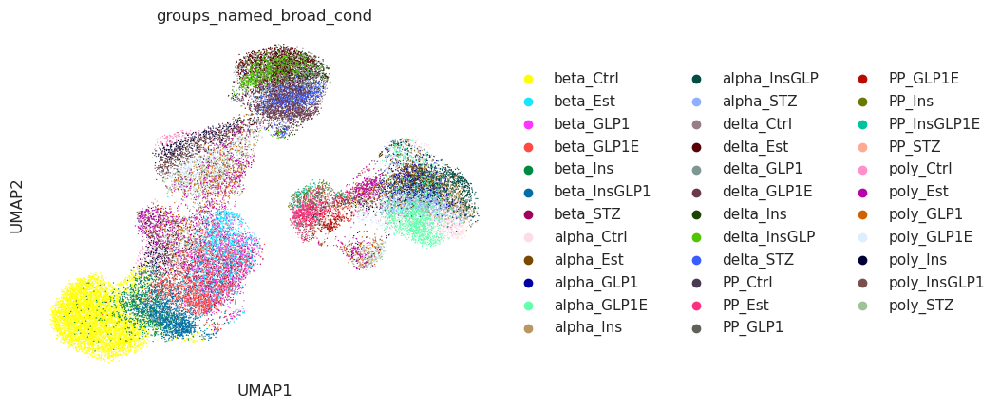

In [597]:
sc.pl.umap(adata,color='groups_named_broad_cond')

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


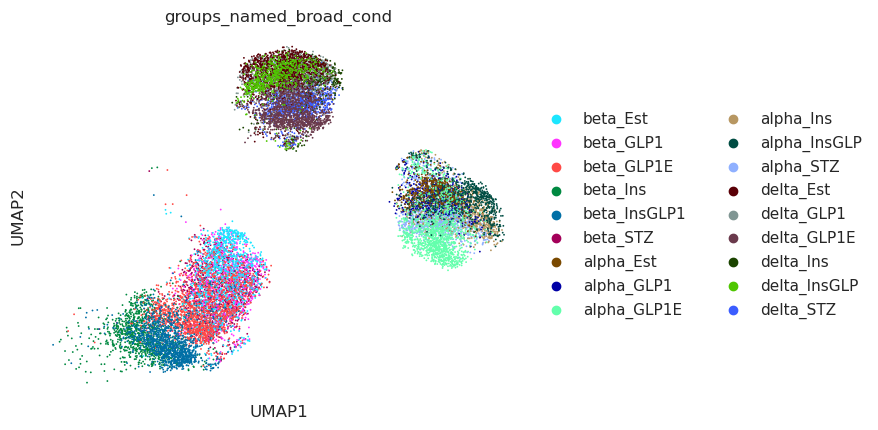

/tmp/ipykernel_48085/3167989771.py:5: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_stz.obs['cond']='stz'
/tmp/ipykernel_48085/3167989771.py:8: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_ctrl.obs['cond']='ctrl'
/tmp/ipykernel_48085/3167989771.py:9: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_stz_ctrl = adata_stz.concatenate(adata_ctrl)


In [598]:
adata_stz = adata[adata.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_GLP1','beta_Ins','beta_InsGLP1','beta_Est','beta_GLP1E',
                                                             'alpha_STZ','alpha_GLP1','alpha_Ins','alpha_InsGLP','alpha_Est','alpha_GLP1E',
                                                             'delta_STZ','delta_GLP1','delta_Ins','delta_InsGLP','delta_Est','delta_GLP1E',])]
sc.pl.umap(adata_stz,color='groups_named_broad_cond')
adata_stz.obs['cond']='stz'
adata_ctrl = adata[adata.obs['groups_named_broad_cond'].isin(['beta_Ctrl','alpha_Ctrl'
                                                                  ,'delta_Ctrl'])]
adata_ctrl.obs['cond']='ctrl'
adata_stz_ctrl = adata_stz.concatenate(adata_ctrl)


In [599]:
sc.pp.filter_genes_dispersion(adata_stz_ctrl,n_top_genes=3000)
sc.pp.filter_genes(adata_stz_ctrl, min_counts=20)
sc.pp.normalize_per_cell(adata_stz_ctrl, counts_per_cell_after=1e4)
sc.pp.log1p(adata_stz_ctrl)


/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/preprocessing/_deprecated/highly_variable_genes.py:152: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersion']


/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


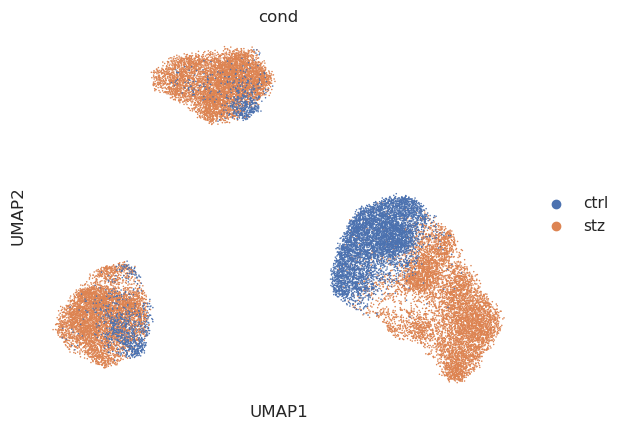

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


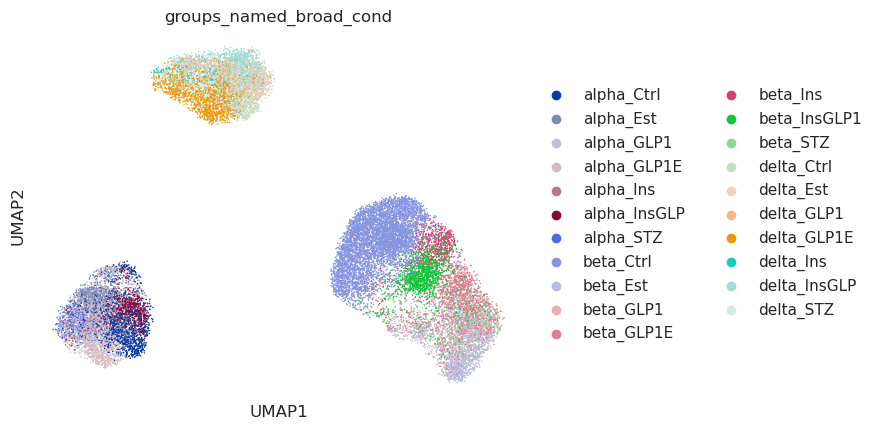

In [600]:
sc.pp.pca(adata_stz_ctrl)
sc.pp.neighbors(adata_stz_ctrl)
sc.tl.umap(adata_stz_ctrl)
sc.pl.umap(adata_stz_ctrl,color=['cond'])
sc.pl.umap(adata_stz_ctrl,color=['groups_named_broad_cond' ])


In [691]:
epoch_num=30
prob_list = models.follow_training_dyn_neural_net(adata_stz_ctrl, label_key='cond',iterNum=epoch_num, device='cpu')

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/sklearn/preprocessing/_encoders.py:975: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(
/cs/labs/ravehb/reshem/dynamicks/models.py:265: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if adata.obs[label_key][i] == t:
/cs/labs/ravehb/reshem/dynamicks/models.py:51: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  output = F.log_softmax(x)


[1,     2] loss: 0.141
[1,    12] loss: 0.685
[1,    22] loss: 0.626
[1,    32] loss: 0.557
[1,    42] loss: 0.500
[1,    52] loss: 0.442
[1,    62] loss: 0.414
[1,    72] loss: 0.379
[1,    82] loss: 0.346
[1,    92] loss: 0.322
[2,     2] loss: 0.062
[2,    12] loss: 0.290
[2,    22] loss: 0.292
[2,    32] loss: 0.273
[2,    42] loss: 0.252
[2,    52] loss: 0.246
[2,    62] loss: 0.231
[2,    72] loss: 0.213
[2,    82] loss: 0.212
[2,    92] loss: 0.198
[3,     2] loss: 0.044
[3,    12] loss: 0.205
[3,    22] loss: 0.189
[3,    32] loss: 0.185
[3,    42] loss: 0.172
[3,    52] loss: 0.176
[3,    62] loss: 0.163
[3,    72] loss: 0.173
[3,    82] loss: 0.164
[3,    92] loss: 0.169
[4,     2] loss: 0.034
[4,    12] loss: 0.158
[4,    22] loss: 0.153
[4,    32] loss: 0.154
[4,    42] loss: 0.152
[4,    52] loss: 0.139
[4,    62] loss: 0.140
[4,    72] loss: 0.142
[4,    82] loss: 0.135
[4,    92] loss: 0.145
[5,     2] loss: 0.028
[5,    12] loss: 0.136
[5,    22] loss: 0.122
[5,    32] 

In [692]:
all_conf , all_var = models.probability_list_to_confidence_and_var(prob_list, n_obs= adata_stz_ctrl.n_obs, epoch_num=epoch_num)

In [870]:
#pickle
import pickle
with open('all_conf_all_var_v4.pkl', 'wb') as f:
    pickle.dump((all_conf,all_var), f)
#open pikcle
# import pickle
# with open('all_conf_all_var_v2.pkl', 'rb') as f:
#     all_conf,all_var = pickle.load(f)

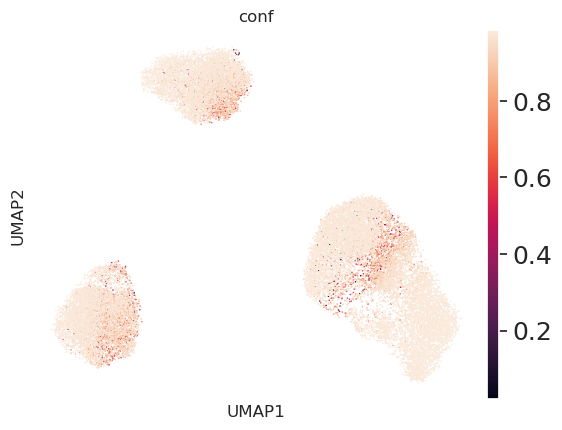

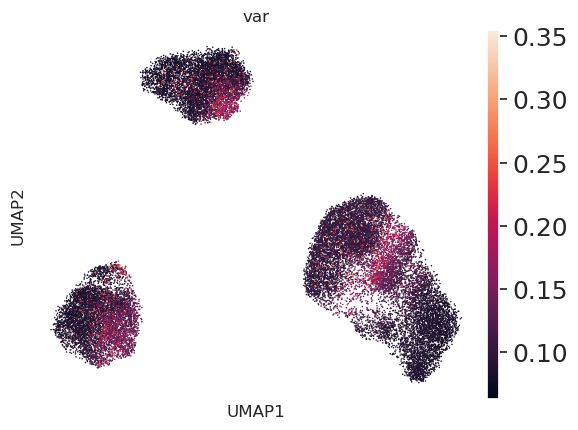

In [788]:
adata_stz_ctrl.obs['conf'] = all_conf.detach().numpy()
adata_stz_ctrl.obs['var'] = all_var.detach().numpy()
sc.pl.umap(adata_stz_ctrl , color='conf')
sc.pl.umap(adata_stz_ctrl , color='var')


[[0.        0.        0.        ... 0.        3.7561376 3.9019372]
 [0.        0.        0.        ... 0.        4.067851  3.8244739]
 [0.        0.        0.        ... 0.        3.898129  3.53452  ]
 ...
 [0.        0.        0.        ... 0.        3.6557083 2.6952295]
 [0.        0.        3.2278516 ... 0.        3.9143136 3.9143136]
 [0.        0.        0.        ... 0.        4.2171707 4.5239124]]


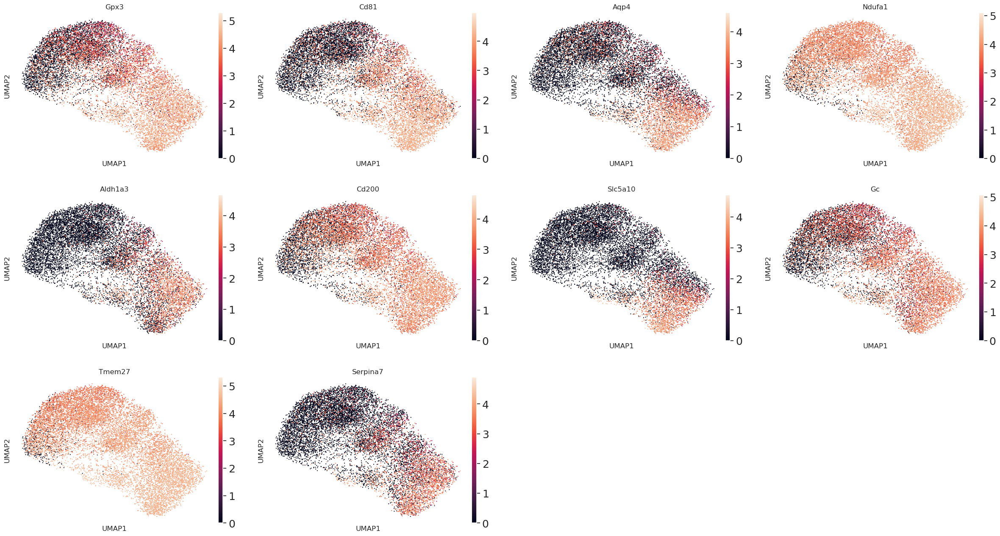

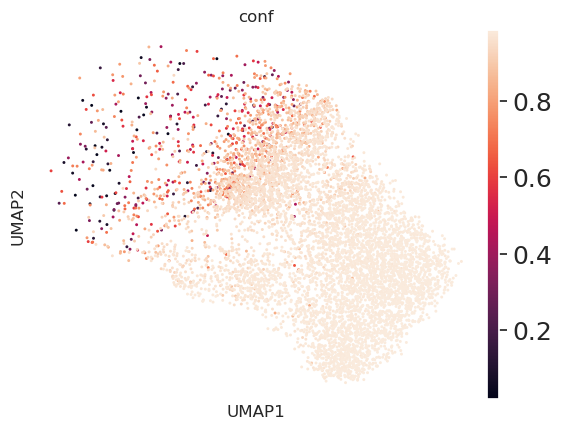

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


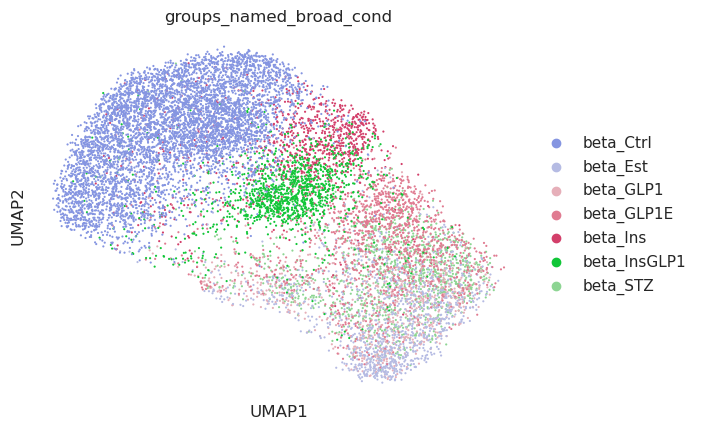

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


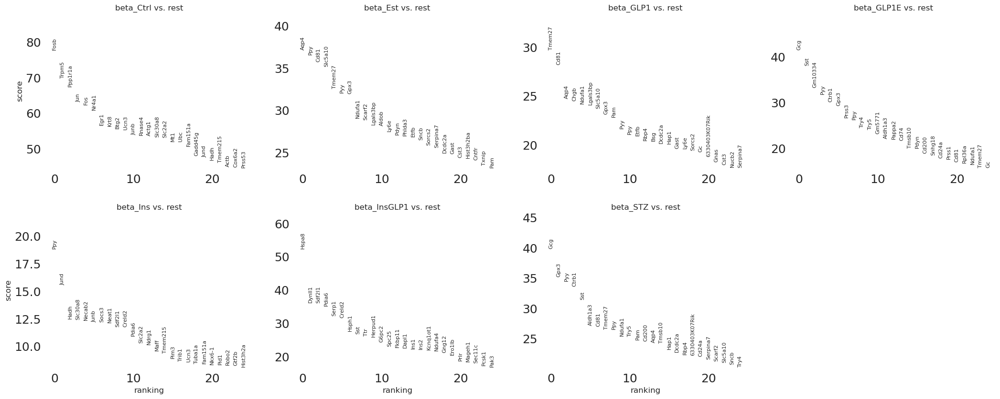

[[0.        0.        0.        ... 0.        3.9999564 3.8566396]
 [0.        0.        0.        ... 0.        4.118727  4.118727 ]
 [0.        0.        0.        ... 0.        4.4919505 4.1563506]
 ...
 [0.        3.856743  0.        ... 0.        3.6406024 3.6406024]
 [0.        0.        0.        ... 0.        4.1591816 4.2364335]
 [0.        0.        0.        ... 0.        3.912708  3.8448353]]


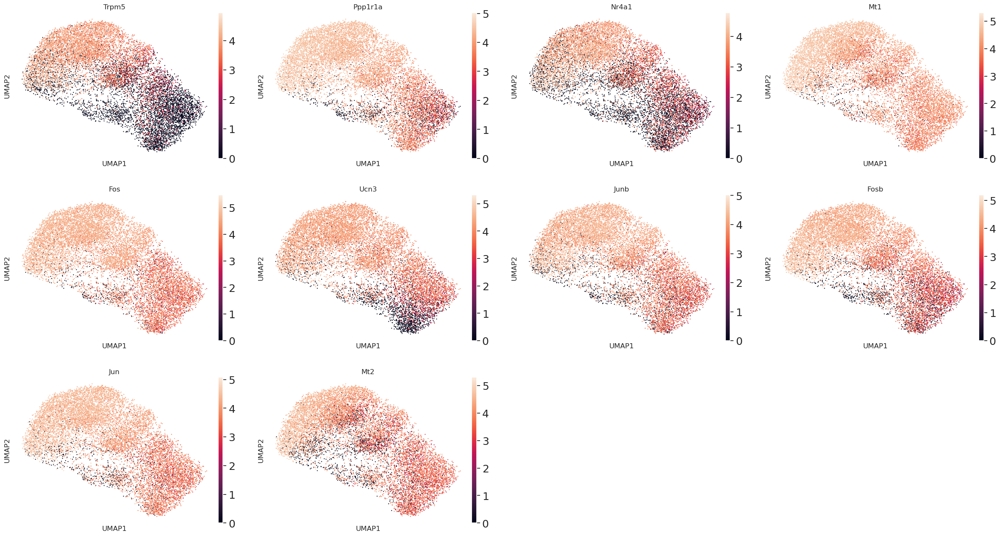

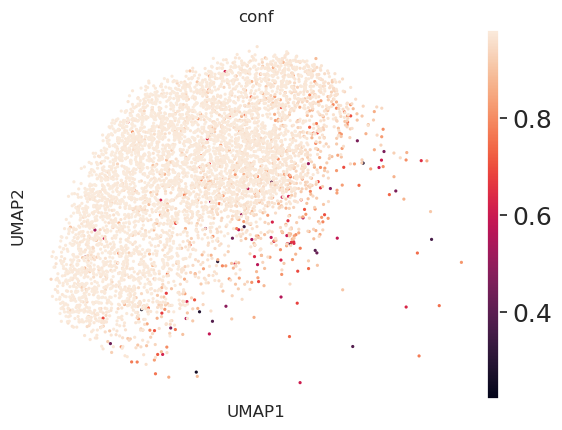

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


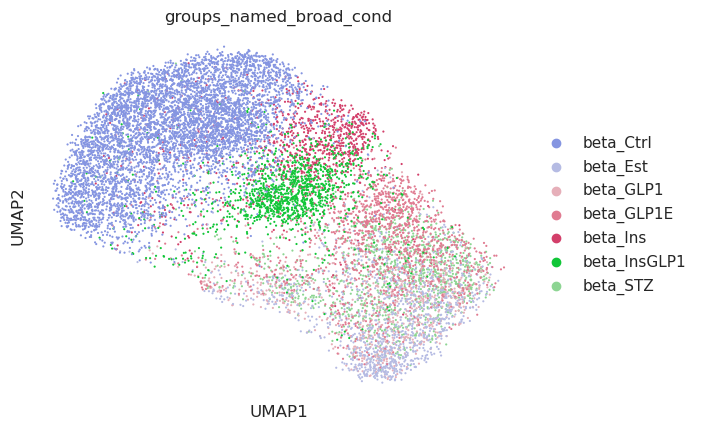

In [789]:
#here because the    in  A = scaled_adata.X.toarray() the toarray()  is needed
def rank_genes_conf_min_counts(adata, power=1, power_low=1, min_counts=100):
    """
    Rank genes based on confidence scores and specified parameters.

    Parameters
    ----------
    adata : AnnData
        Anndata object containing the data and annotations.
    power : float, optional
        Power for calculating confidence score for high confidence, by default 1.
    power_low : float, optional
        Power for calculating confidence score for low confidence, by default 1.
    min_counts : int, optional
        Minimum counts for filtering genes, by default 100.

    Returns
    -------
    scaled_adata : AnnData
        Anndata object with additional gene-wise confidence scores.
    """
    scaled_adata = adata.copy()

    # Filter genes based on minimum counts
    sc.pp.filter_genes(scaled_adata, min_counts=min_counts)

    A = scaled_adata.X.toarray()
    print(A)
    mean = np.mean(A, axis=0)
    A = A - mean
    A = normalize(A, axis=0)

    conf_vector = np.array(scaled_adata.obs['conf'])
    low_conf_vector = 1 - conf_vector

    # Normalize confidence vectors
    conf_vector = conf_vector / np.sum(conf_vector)
    low_conf_vector = low_conf_vector / np.sum(low_conf_vector)

    # Create an indicator for ambiguous confidence scores
    ambiguous_indicator = metrics.create_ambiguous_indicator(conf_vector)

    # Calculate confidence scores for high, low, and mid confidence
    scaled_adata.var['conf_score_high'] = A.T @ np.power(conf_vector, power)
    scaled_adata.var['conf_score_low'] = A.T @ np.power(low_conf_vector, power_low)
    scaled_adata.var['conf_score_mid'] = A.T @ ambiguous_indicator

    return scaled_adata
temp_list_r=['beta_STZ','beta_GLP1','beta_Ins','beta_InsGLP1','beta_Est','beta_GLP1E']

adata_tmp = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(temp_list_r)]
adata_beta_ranked = rank_genes_conf_min_counts(adata_tmp, 1,1)
sc.pl.umap(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(temp_list_r+["beta_Ctrl"])],color=adata_beta_ranked.var['conf_score_high'].sort_values(ascending=False).index[:10])
sc.pl.umap(adata_tmp,color=['conf'])
sc.pl.umap(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(temp_list_r+["beta_Ctrl"])],color=['groups_named_broad_cond'])

adata_tmp = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(temp_list_r+["beta_Ctrl"])]
sc.tl.rank_genes_groups(adata_tmp, 'groups_named_broad_cond' ,method='wilcoxon')
sc.pl.rank_genes_groups(adata_tmp, n_genes=25, sharey=False)


temp_list_r=['beta_STZ','beta_GLP1','beta_Ins','beta_InsGLP1','beta_Est','beta_GLP1E']

adata_tmp = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])]
adata_beta_ranked = rank_genes_conf_min_counts(adata_tmp, 1,1)
sc.pl.umap(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(temp_list_r+["beta_Ctrl"])],color=adata_beta_ranked.var['conf_score_high'].sort_values(ascending=False).index[:10])
sc.pl.umap(adata_tmp,color=['conf'])
sc.pl.umap(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(temp_list_r+["beta_Ctrl"])],color=['groups_named_broad_cond'])

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca


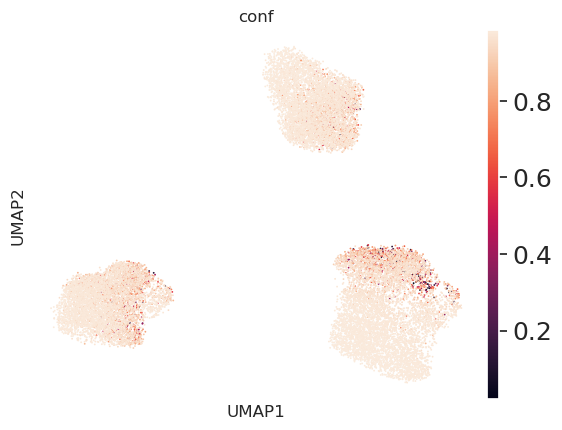

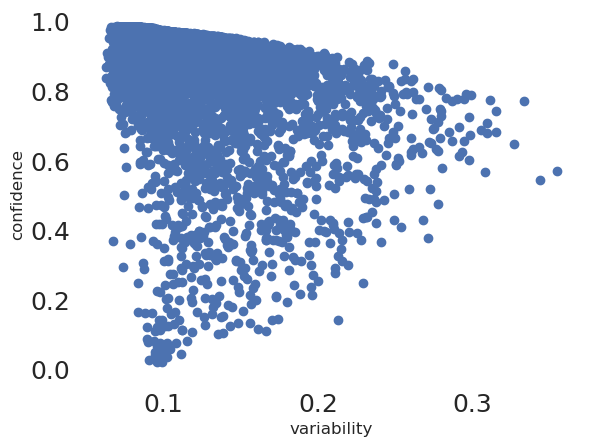

In [790]:
adata_stz = adata_stz_ctrl[adata_stz_ctrl.obs['cond'].isin(['stz'])]
adata_ctrl = adata_stz_ctrl[adata_stz_ctrl.obs['cond'].isin(['ctrl'])]
sc.pp.pca(adata_stz)
sc.pp.neighbors(adata_stz)
sc.tl.umap(adata_stz )
sc.pl.umap(adata_stz , color='conf')
plt.scatter( adata_stz.obs['var'],adata_stz.obs['conf'])#,c=adata.obs['conf_binaries'])
plt.xlabel('variability')
plt.ylabel('confidence')
plt.show()


In [791]:
# adata_beta_stz
adata_beta_ctrl = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_Ctrl'])]
adata_beta_ctrl

View of AnnData object with n_obs × n_vars = 5664 × 2319
    obs: 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'groups', 'treatment', 'groups_named_broad', 'S_score', 'G2M_score', 'phase', 'proliferation', 'proliferation_man', 'doublet_score', 'groups_named_fine', 'groups_named_beta_dpt', 'Ins-Gcg-Sst', 'groups_named_broad_cond', 'cond', 'batch', 'conf', 'var', 'var_position', 'conf_position'
    var: 'n_cells', 'highly_variable_genes', 'means', 'dispersions', 'dispersions_norm', 'n_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'cond_colors', 'groups_named_broad_cond_colors'
    obsm: 'X_umap', 'X_pca'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [792]:
adata_stz_ctrl.obs['groups_named_broad_cond']


index
AAACCTGAGAGTACCG-1_G2-0      beta_STZ
AAACCTGCACATTCGA-1_G2-0      beta_STZ
AAACCTGGTGAGGCTA-1_G2-0     delta_STZ
AAACCTGGTGATAAGT-1_G2-0     delta_STZ
AAACCTGTCATGTCCC-1_G2-0     alpha_STZ
                              ...    
TTTGTCAGTTACGACT-1_G1-1    delta_Ctrl
TTTGTCATCAACACCA-1_G1-1     beta_Ctrl
TTTGTCATCACATACG-1_G1-1     beta_Ctrl
TTTGTCATCCGAAGAG-1_G1-1     beta_Ctrl
TTTGTCATCTGTCTAT-1_G1-1     beta_Ctrl
Name: groups_named_broad_cond, Length: 24576, dtype: category
Categories (21, object): ['alpha_Ctrl', 'alpha_Est', 'alpha_GLP1', 'alpha_GLP1E', ..., 'delta_GLP1E', 'delta_Ins', 'delta_InsGLP', 'delta_STZ']

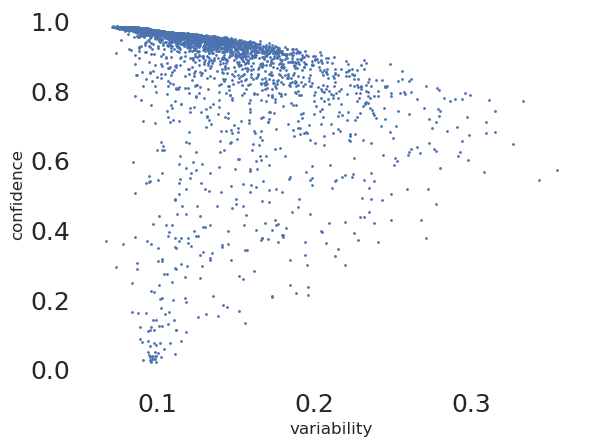

In [793]:
adata_beta_stz = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]
plt.scatter( adata_beta_stz.obs['var'],adata_beta_stz.obs['conf'],s=1)#,c=adata_beta_only_stz[:,'Ins2'].X.toarray())
plt.xlabel('variability')
plt.ylabel('confidence')
plt.show()


In [794]:
adata_beta_only_stz = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ'])]
adata_beta_only_ins = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_Ins'])]
adata_beta_only_glp1 = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_GLP1'])]
adata_beta_only_Insglp1 = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_InsGLP1'])]
adata_beta_only_Est = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_Est'])]
adata_beta_only_glp1e = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_GLP1E'])]


In [795]:
beta_cells_genes_dict= {
    'Beta cells activity':['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2',  'Slc30a8', 'Ucn3'], 
    'Beta cells dedifferentiation':['Aldh1a3', 'Serpina7']
                                    }
#'other':['Pdx1','Mafa','Nkx6-1']

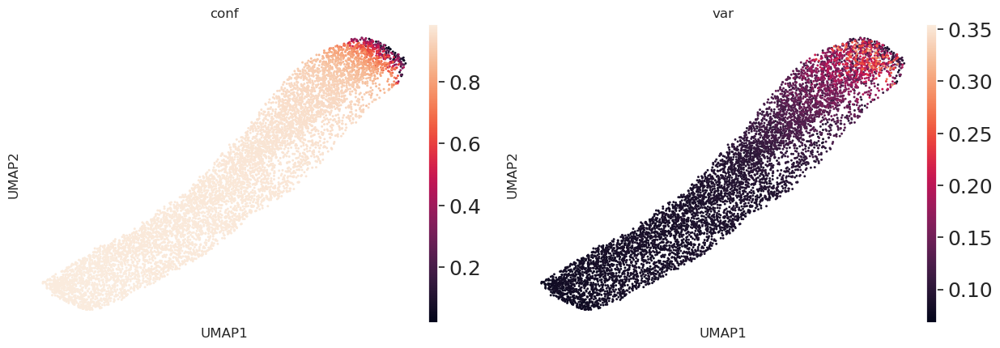

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


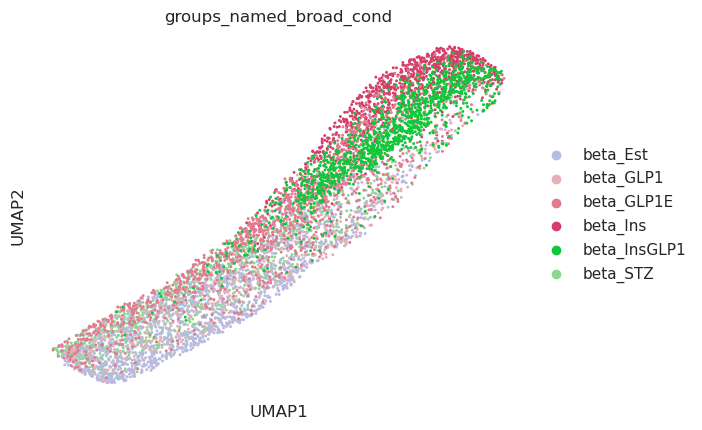

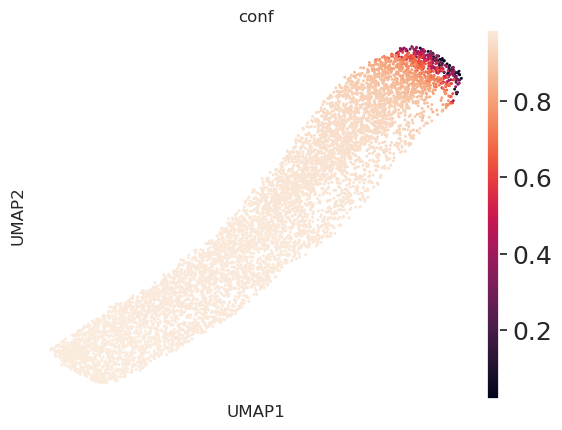

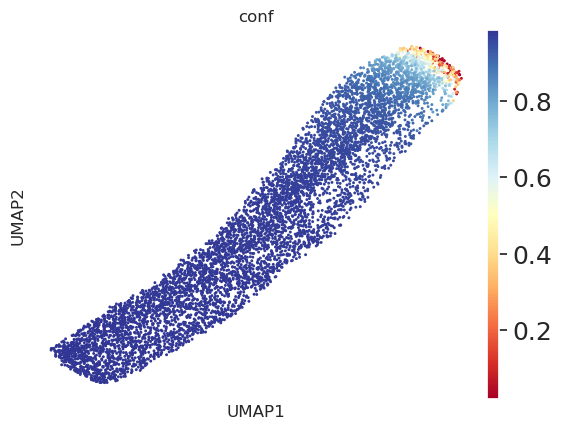

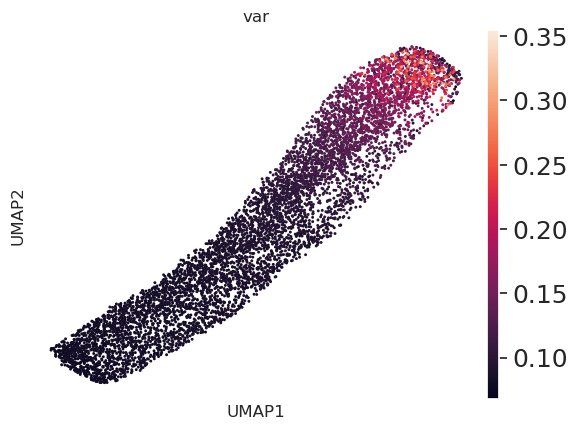

/tmp/ipykernel_48085/224556191.py:34: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_beta_stz.obs['var_position'] = positions_var/mean_distance_conf


In [796]:

adata_beta_stz_for_graph = adata_beta_stz.copy()

connectivities_graph , distance_graph  = metrics.make_conf_graph(adata_beta_stz_for_graph.copy(), alpha=0.65 , k=15)

adata_beta_stz_for_graph.obsp['connectivities']=sparse.csr_matrix(connectivities_graph)
sc.tl.umap(adata_beta_stz_for_graph)
sc.pl.umap(adata_beta_stz_for_graph, color=['conf','var'])
sc.pl.umap(adata_beta_stz_for_graph,color=['groups_named_broad_cond'])
sc.pl.umap(adata_beta_stz_for_graph,color=['conf'])
sc.pl.umap(adata_beta_stz_for_graph,color=['conf'],color_map='RdYlBu',save="conf_beta_stz.svg")
sc.pl.umap(adata_beta_stz_for_graph,color=['var'])
# sc.pl.umap(adata_beta_stz_for_graph,color=['annotation'])


sorted_indices_conf = np.argsort(adata_beta_stz_for_graph.obs['conf'])
positions_conf = np.empty_like(sorted_indices_conf)
positions_conf[sorted_indices_conf] = np.arange(len((adata_beta_stz_for_graph.obs['conf'])))
n = len(sorted_indices_conf)

mean_distance_conf = metrics.mean_absolute_distance(n)





sorted_indices_var = np.argsort(adata_beta_stz.obs['var'])
positions_var = np.empty_like(sorted_indices_var)
positions_var[sorted_indices_var] = np.arange(len((adata_beta_stz.obs['var'])))





adata_beta_stz.obs['var_position'] = positions_var/mean_distance_conf
adata_beta_stz.obs['conf_position'] = positions_conf/mean_distance_conf

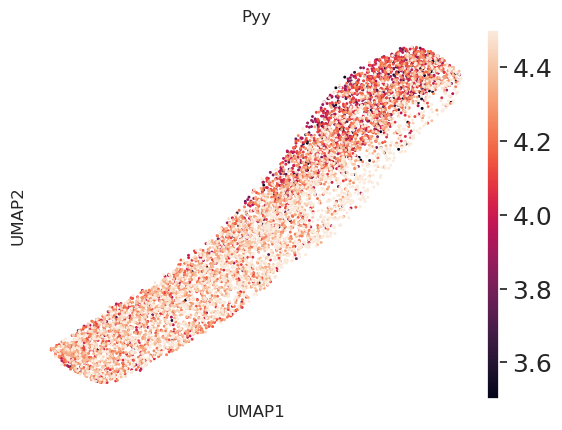

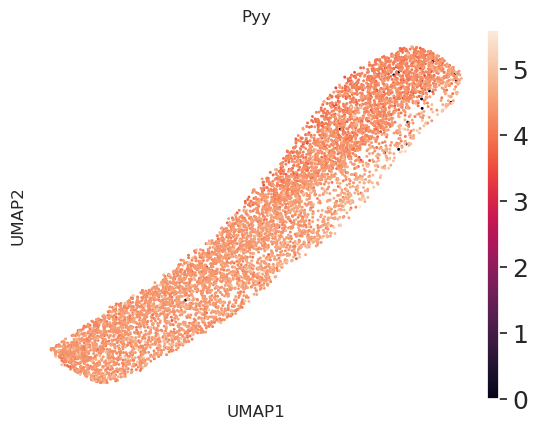

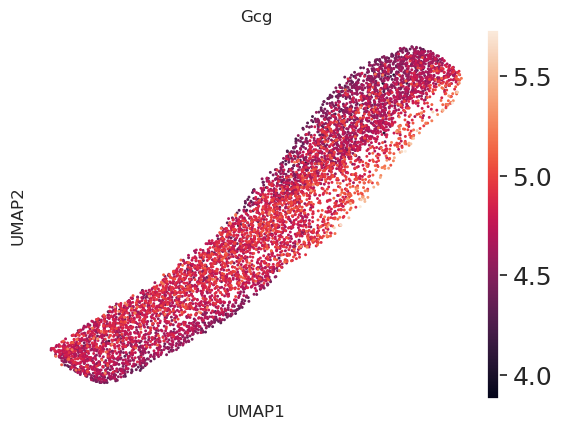

In [797]:
sc.pl.umap(adata_beta_stz_for_graph,color=['Pyy'],vmin=3.5,vmax=4.5)
sc.pl.umap(adata_beta_stz_for_graph,color=['Pyy'])
sc.pl.umap(adata_beta_stz_for_graph,color=['Gcg'])


(7,)
0
1
2
3
4
5
6


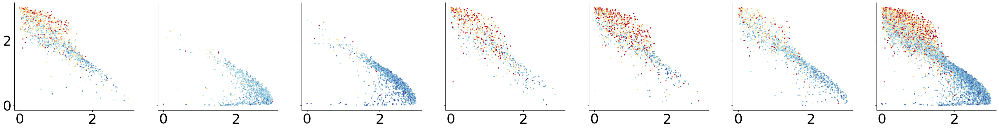

In [798]:
temp_list_r=['beta_STZ','beta_Ins','beta_InsGLP1','beta_GLP1','beta_Est','beta_GLP1E','all_beta']
adata_beta_stz_tmp = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]
# adata_beta_stz = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]

plt.rcParams.update(plt.rcParamsDefault)

fig, axes = plt.subplots(nrows=1, ncols=len(temp_list_r), figsize=(45, 5), sharex=True, sharey=True)
print(axes.shape)
for i,cond in enumerate(temp_list_r):
    if cond == 'all_beta':
        adata_tmp = adata_beta_stz[adata_beta_stz.obs['groups_named_broad_cond'].isin(temp_list_r[0:-1])]
    else:
        adata_tmp = adata_beta_stz[adata_beta_stz.obs['groups_named_broad_cond'].isin([cond])]


    gene_index = adata_tmp.var_names.get_loc('Ins1')
    gene_expression_values_ins1 = adata_tmp.X[:, gene_index]
    gene_name='Ins1'
    ax = axes[i]
    scatter = ax.scatter(adata_tmp.obs['var_position'], adata_tmp.obs['conf_position'], c=gene_expression_values_ins1.toarray(),s=5,cmap='RdYlBu',vmin=4.5,vmax=6)

    # if i == 0 :
        # ax.set_ylabel('confidence rank',fontsize=20)

    # if i == len(temp_list_r)-1:
    #     cbar = plt.colorbar(scatter, ax=ax)
    #     cbar.ax.tick_params(labelsize=20)
    #     #show less thiks on the color bar
    #     # cbar.locator = ticker.MaxNLocator(nbins=5)
    #     # cbar.update_ticks()
    #     cbar.set_ticks([4.5, 5,5.5, 6])  # Set specific ticks on the colorbar

    ax.tick_params(axis='both', labelsize=35)

    # ax.set_title(f'{cond}',fontsize=20)


    #change tikers font size
    # for tick in ax.xaxis.get_major_ticks():
    #     tick.label.set_fontsize(20)
    print(i)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    # ax.axhline(y=0, color='black', linestyle='-', linewidth=2)
    # ax.axvline(x=0, color='black', linestyle='-', linewidth=2)

    # ax.spines['left'].set_visible(True)
    # ax.spines['bottom'].set_visible(True)



plt.savefig(f'figures/a_v3.png',dpi=600)
plt.savefig(f'figures/a_v3.svg',dpi=600,format='svg')
# plt.savefig(f'figures/a_high_res.png',dpi=100)
plt.savefig(f'figures/temp.png',dpi=300)
# plt.savefig(f'figures/a_v3.svg',dpi=600,format='svg')
plt.show()

In [799]:
sns.set_theme()
# plt.rcParams.update(plt.rcParamsDefault)

plt.rcParams.update({'font.size': 18,
                     'xtick.labelsize' : 18,
                     'ytick.labelsize' : 18})

mpl.rcParams['figure.facecolor'] = 'white'
mpl.rcParams['axes.facecolor'] = 'white'

(7,)
0
1
2
3
4
5
6


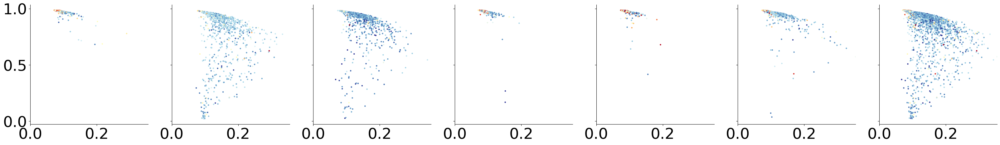

In [800]:
temp_list_r=['beta_STZ','beta_Ins','beta_InsGLP1','beta_GLP1','beta_Est','beta_GLP1E','all_beta']
adata_beta_stz_tmp = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]
# adata_beta_stz = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]
plt.rcParams.update(plt.rcParamsDefault)


fig, axes = plt.subplots(nrows=1, ncols=len(temp_list_r), figsize=(40, 5), sharex=True, sharey=True)
print(axes.shape)
for i,cond in enumerate(temp_list_r):
    if cond == 'all_beta':
        adata_tmp = adata_beta_stz[adata_beta_stz.obs['groups_named_broad_cond'].isin(temp_list_r[0:-1])]
    else:
        adata_tmp = adata_beta_stz[adata_beta_stz.obs['groups_named_broad_cond'].isin([cond])]


    gene_index = adata_tmp.var_names.get_loc('Ins1')
    gene_expression_values_ins1 = adata_tmp.X[:, gene_index]
    gene_name='Ins1'
    ax = axes[i]
    scatter = ax.scatter(adata_tmp.obs['var'], adata_tmp.obs['conf'], c=gene_expression_values_ins1.toarray(),s=5,cmap='RdYlBu',vmin=4.5,vmax=6)

    # if i == 0 :
    #     ax.set_ylabel('confidence rank',fontsize=20)

    # if i == len(temp_list_r)-1:
    #     cbar = plt.colorbar(scatter, ax=ax)
    #     cbar.ax.tick_params(labelsize=20)

    ax.tick_params(axis='both', labelsize=35)

    # ax.set_title(f'{cond}',fontsize=20)
    ax.set_xlim(0,max(adata_tmp.obs['var']))

    #change tikers font size
    # for tick in ax.xaxis.get_major_ticks():
    #     tick.label.set_fontsize(20)
    print(i)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

plt.savefig(f'figures/b_v3_sup.png',dpi=600)
plt.savefig(f'figures/b_v3_sup.svg',dpi=600,format='svg')

# plt.savefig(f'figures/a_high_res.png',dpi=100)
plt.show()

sns.set_theme()
# plt.rcParams.update(plt.rcParamsDefault)

plt.rcParams.update({'font.size': 18,
                     'xtick.labelsize' : 18,
                     'ytick.labelsize' : 18})

mpl.rcParams['figure.facecolor'] = 'white'
mpl.rcParams['axes.facecolor'] = 'white'

(7,)
0
1
2
3
4
5
6


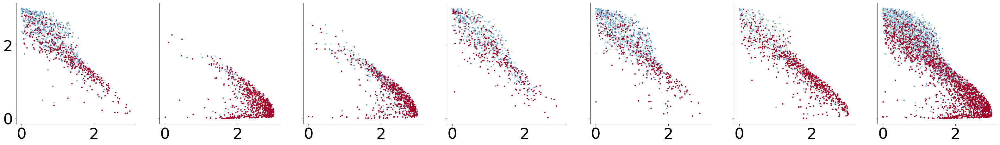

In [801]:
temp_list_r=['beta_STZ','beta_Ins','beta_InsGLP1','beta_GLP1','beta_Est','beta_GLP1E','all_beta']
adata_beta_stz_tmp = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]
# adata_beta_stz = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]

# mpl.rcParams['figure.facecolor'] = 'white'
# mpl.rcParams['axes.facecolor'] = 'white'
plt.rcParams.update(plt.rcParamsDefault)

fig, axes = plt.subplots(nrows=1, ncols=len(temp_list_r), figsize=(40, 5), sharex=True, sharey=True)
print(axes.shape)
for i,cond in enumerate(temp_list_r):
    if cond == 'all_beta':
        adata_tmp = adata_beta_stz[adata_beta_stz.obs['groups_named_broad_cond'].isin(temp_list_r[0:-1])]
    else:
        adata_tmp = adata_beta_stz[adata_beta_stz.obs['groups_named_broad_cond'].isin([cond])]


    gene_index = adata_tmp.var_names.get_loc('Serpina7')
    gene_expression_values_ser = adata_tmp.X[:, gene_index]
    gene_name='Serpina7'
    ax = axes[i]
    scatter = ax.scatter(adata_tmp.obs['var_position'], adata_tmp.obs['conf_position'], c=gene_expression_values_ser.toarray(),s=5,cmap='RdYlBu')
    #
    # if i == 0 :
    #     ax.set_ylabel('confidence rank',fontsize=20)

    # if i == len(temp_list_r)-1:
    #     cbar = plt.colorbar(scatter, ax=ax)
    #     cbar.ax.tick_params(labelsize=20)

    ax.tick_params(axis='both', labelsize=35)

    # ax.set_title(f'{cond}',fontsize=20)


    #change tikers font size
    # for tick in ax.xaxis.get_major_ticks():
    #     tick.label.set_fontsize(20)
    print(i)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

plt.savefig(f'figures/a_v3_sup.png',dpi=600)
plt.savefig(f'figures/a_v3_sup.svg',dpi=600,format='svg')
# plt.savefig(f'figures/a_high_res.png',dpi=100)
plt.show()

sns.set_theme()
# plt.rcParams.update(plt.rcParamsDefault)

plt.rcParams.update({'font.size': 18,
                     'xtick.labelsize' : 18,
                     'ytick.labelsize' : 18})

mpl.rcParams['figure.facecolor'] = 'white'
mpl.rcParams['axes.facecolor'] = 'white'

(7,)
0
1
2
3
4
5
6


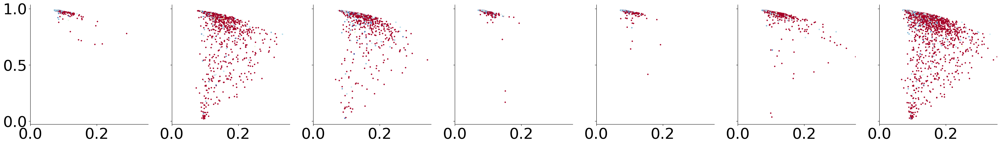

In [802]:
temp_list_r=['beta_STZ','beta_Ins','beta_InsGLP1','beta_GLP1','beta_Est','beta_GLP1E','all_beta']
adata_beta_stz_tmp = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]
# adata_beta_stz = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]
plt.rcParams.update(plt.rcParamsDefault)

fig, axes = plt.subplots(nrows=1, ncols=len(temp_list_r), figsize=(40, 5), sharex=True, sharey=True)
print(axes.shape)
for i,cond in enumerate(temp_list_r):
    if cond == 'all_beta':
        adata_tmp = adata_beta_stz[adata_beta_stz.obs['groups_named_broad_cond'].isin(temp_list_r[0:-1])]
    else:
        adata_tmp = adata_beta_stz[adata_beta_stz.obs['groups_named_broad_cond'].isin([cond])]


    gene_index = adata_tmp.var_names.get_loc('Serpina7')
    gene_expression_values_ins1 = adata_tmp.X[:, gene_index]
    gene_name='Serpina7'
    ax = axes[i]
    scatter = ax.scatter(adata_tmp.obs['var'], adata_tmp.obs['conf'], c=gene_expression_values_ins1.toarray(),s=5,cmap='RdYlBu')

    # if i == 0 :
    #     ax.set_ylabel('confidence rank',fontsize=20)
    #
    # if i == len(temp_list_r)-1:
    #     cbar = plt.colorbar(scatter, ax=ax)
    #     cbar.ax.tick_params(labelsize=20)

    ax.tick_params(axis='both', labelsize=35)

    # ax.set_title(f'{cond}',fontsize=20)
    ax.set_xlim(0,max(adata_tmp.obs['var']))

    #change tikers font size
    # for tick in ax.xaxis.get_major_ticks():
    #     tick.label.set_fontsize(20)
    print(i)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

plt.savefig(f'figures/c_v3_sup.png',dpi=600)
plt.savefig(f'figures/c_v3_sup.svg',dpi=600,format='svg')
# plt.savefig(f'figures/a_high_res.png',dpi=100)
plt.show()

sns.set_theme()
# plt.rcParams.update(plt.rcParamsDefault)

plt.rcParams.update({'font.size': 18,
                     'xtick.labelsize' : 18,
                     'ytick.labelsize' : 18})

mpl.rcParams['figure.facecolor'] = 'white'
mpl.rcParams['axes.facecolor'] = 'white'

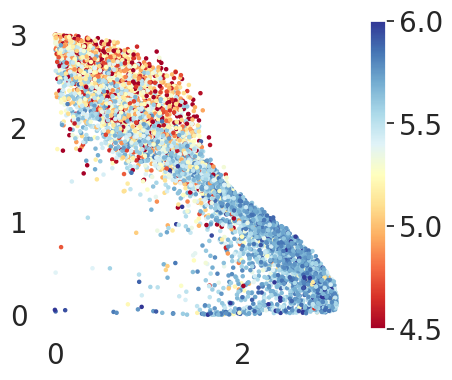

In [803]:
temp_list_r=['beta_STZ','beta_Ins','beta_InsGLP1','beta_GLP1','beta_Est','beta_GLP1E','all_beta']
adata_beta_stz_tmp = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]
# adata_beta_stz = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]


# fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(50, 50))
plt.figure(figsize=(5,4))
adata_tmp = adata_beta_stz[adata_beta_stz.obs['groups_named_broad_cond'].isin(temp_list_r[0:-1])]
gene_index = adata_tmp.var_names.get_loc('Ins1')
gene_expression_values_ins1 = adata_tmp.X[:, gene_index]
gene_name='Ins1'
scatter = plt.scatter(adata_tmp.obs['var_position'], adata_tmp.obs['conf_position'], c=gene_expression_values_ins1.toarray(),s=5,cmap='RdYlBu',vmin=4.5,vmax=6)

# plt.ylabel('confidence rank',fontsize=20)
# plt.xlabel('variability rank',fontsize=20)

cbar = plt.colorbar(scatter)
#cbar thiker font size
cbar.ax.tick_params(labelsize=20)
# cbar.set_label(f'Expression of {gene_name}',fontsize=20)
cbar.set_ticks([4.5, 5,5.5, 6])
plt.tick_params(axis='both', labelsize=20)

# plt.savefig(f'figures/a_v2.png',dpi=300)

    # cbar = plt.colorbar(scatter, ax=ax)

plt.savefig(f'figures/fig1_v5.png',dpi=600)
plt.savefig(f'figures/fig1_v5.svg',dpi=600,format='svg')

plt.show()


/tmp/ipykernel_48085/1688358221.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_beta_stz_ctrl.obs['conf_binaries'] = pd.Categorical((adata_beta_stz_ctrl.obs['conf'] > 0.15)
/tmp/ipykernel_48085/1688358221.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
/tmp/ipykernel_48085/1688358221.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  elif adata_beta_stz_ctrl.obs['conf_binaries'][i]==True:
/tmp/ipykernel_48085/1688358221.py:17: FutureWarning: Series.__getitem__ treating keys a

beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_GLP1E
beta_GLP1E
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1


/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' 

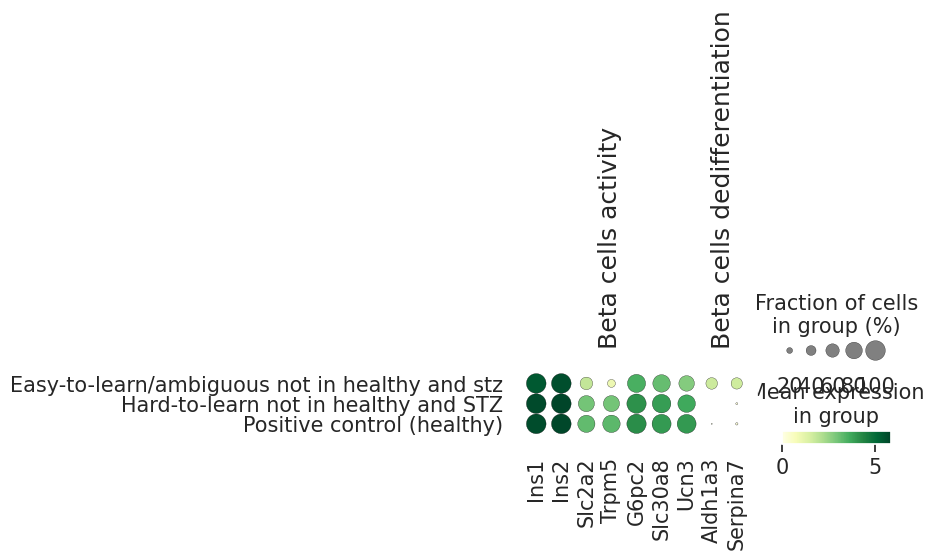

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' 

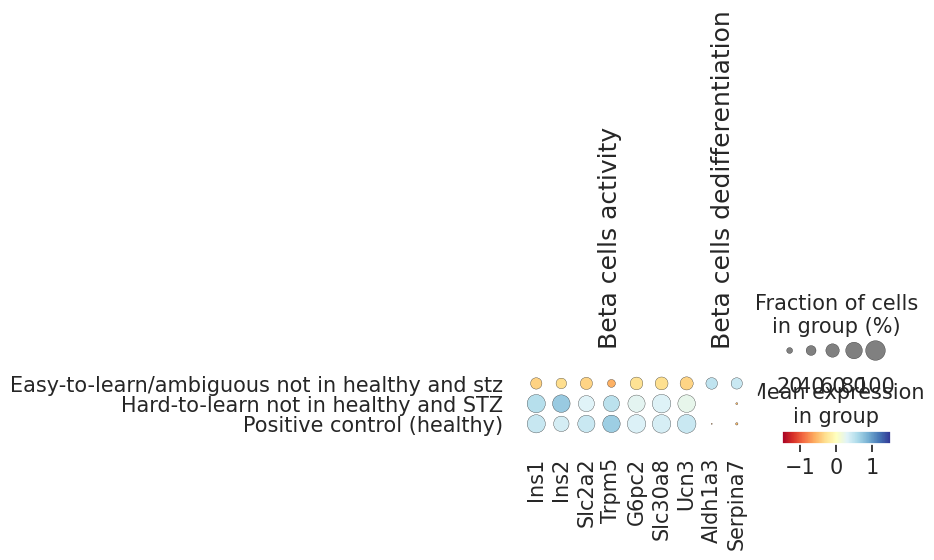

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' 

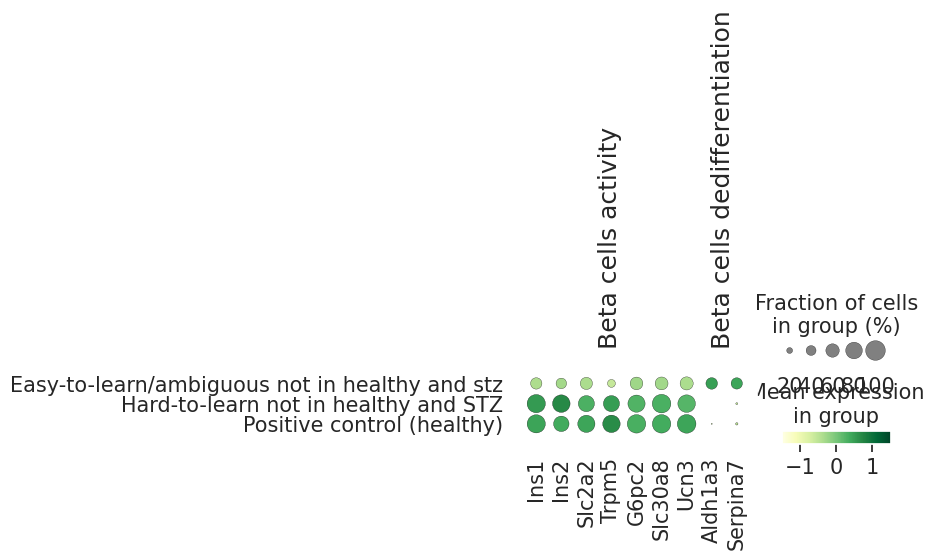

43

In [804]:

adata_beta_stz_ctrl = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E','beta_Ctrl'])]
adata_beta_stz_ctrl.obs['conf_binaries'] = pd.Categorical((adata_beta_stz_ctrl.obs['conf'] > 0.15)
                                                        | (adata_beta_stz_ctrl.obs['var'] > 0.15))

corr_classified_list =[]
count = 0
for i in range(adata_beta_stz_ctrl.n_obs):
    if adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
        corr_classified_list.append('Positive control (healthy)')
    # elif adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i]=='beta_STZ':
    #     corr_classified_list.append('Negative control (STZ)')
    elif adata_beta_stz_ctrl.obs['conf_binaries'][i]==True:
        corr_classified_list.append('Easy-to-learn/ambiguous not in healthy and stz')
    else:
        corr_classified_list.append('Hard-to-learn not in healthy and STZ')
        count +=1
        print(adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i])
adata_beta_stz_ctrl.obs['annotation']=corr_classified_list
order =['Positive control (healthy)','Easy-to-learn/ambiguous not in healthy and stz','Hard-to-learn not in healthy and STZ']
order=['Easy-to-learn/ambiguous not in healthy and stz','Hard-to-learn not in healthy and STZ','Positive control (healthy)']
ax = sc.pl.dotplot(adata_beta_stz_ctrl, beta_cells_genes_dict, groupby='annotation',cmap='YlGn',categories_order=order)
temp_annotation_scaled = adata_beta_stz_ctrl.copy()

sc.pp.scale(temp_annotation_scaled)
# ax = sc.pl.dotplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,categories_order=order,save='beta_cells_a.png')
ax = sc.pl.dotplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,categories_order=order,show=False)
ax['mainplot_ax'].get_figure().savefig('figures/beta_cells_K.png',dpi=600)
plt.show()

# plt.savefig('figures/test.png', dpi=600, bbox_inches='tight')
# plt.savefig('figures/i_v3.svg', format='svg', dpi=600)

# #
# ax = sc.pl.matrixplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,categories_order=order,save='beta_cells_b.png')

ax = sc.pl.dotplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='YlGn',categories_order=order,vmin=-1.5,vmax=1.5)
# print(len(corr_classified_list))
count

/tmp/ipykernel_48085/2820727404.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_beta_stz_ctrl.obs['conf_binaries'] = pd.Categorical((adata_beta_stz_ctrl.obs['conf'] > 0.15)
/tmp/ipykernel_48085/2820727404.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
/tmp/ipykernel_48085/2820727404.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  elif adata_beta_stz_ctrl.obs['conf_binaries'][i]==True:
/tmp/ipykernel_48085/2820727404.py:17: FutureWarning: Series.__getitem__ treating keys a

beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_GLP1E
beta_GLP1E
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1


/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' 

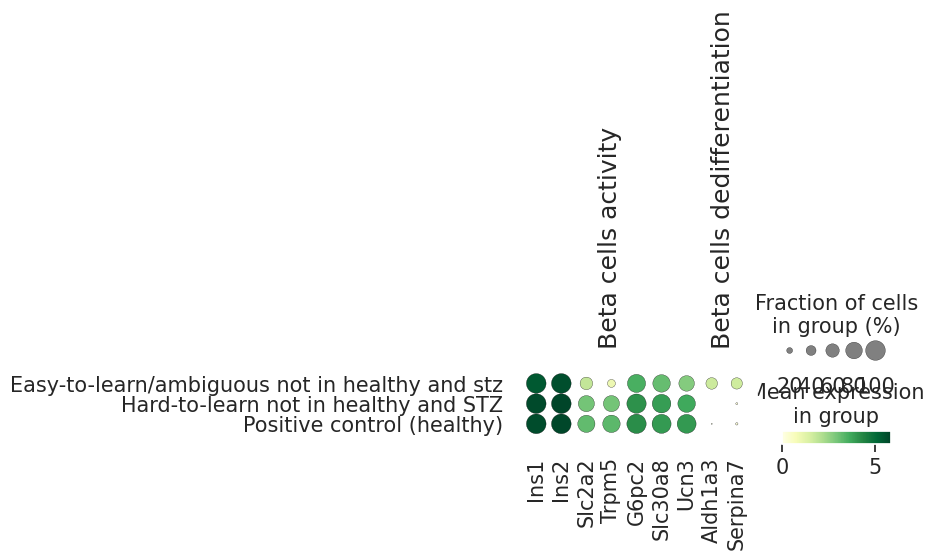

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' 

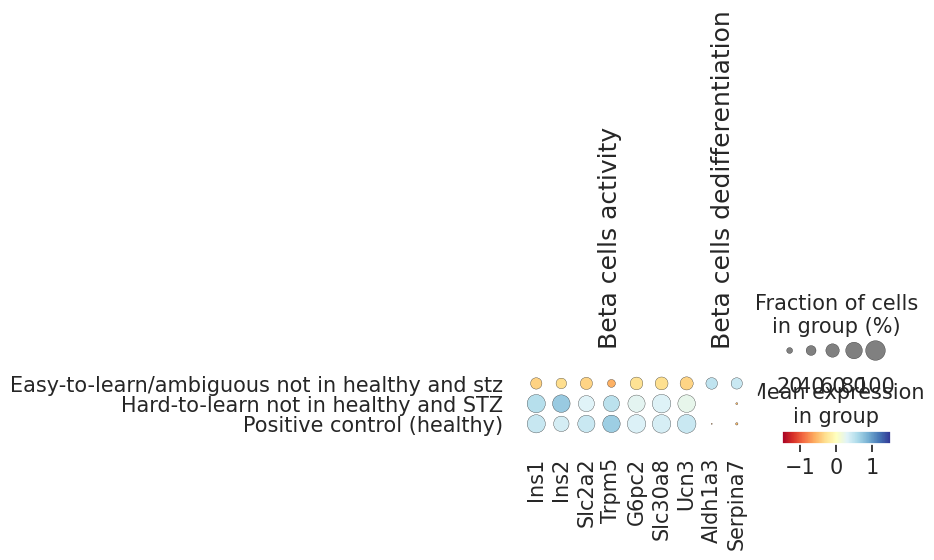

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' 

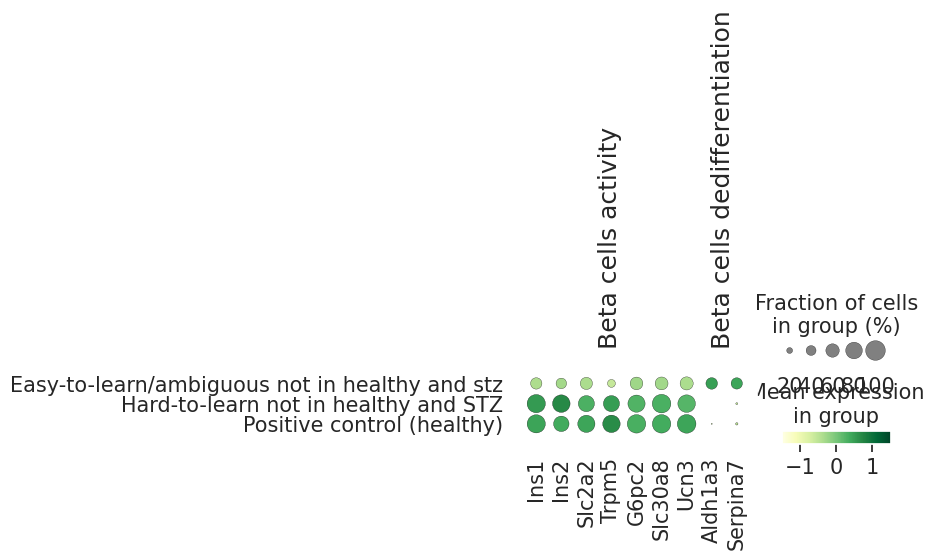

43

In [805]:

adata_beta_stz_ctrl = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E','beta_Ctrl'])]
adata_beta_stz_ctrl.obs['conf_binaries'] = pd.Categorical((adata_beta_stz_ctrl.obs['conf'] > 0.15)
                                                        | (adata_beta_stz_ctrl.obs['var'] > 0.15))

corr_classified_list =[]
count = 0
for i in range(adata_beta_stz_ctrl.n_obs):
    if adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
        corr_classified_list.append('Positive control (healthy)')
    # elif adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i]=='beta_STZ':
    #     corr_classified_list.append('Negative control (STZ)')
    elif adata_beta_stz_ctrl.obs['conf_binaries'][i]==True:
        corr_classified_list.append('Easy-to-learn/ambiguous not in healthy and stz')
    else:
        corr_classified_list.append('Hard-to-learn not in healthy and STZ')
        count +=1
        print(adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i])
adata_beta_stz_ctrl.obs['annotation']=corr_classified_list
order =['Positive control (healthy)','Easy-to-learn/ambiguous not in healthy and stz','Hard-to-learn not in healthy and STZ']
order=['Easy-to-learn/ambiguous not in healthy and stz','Hard-to-learn not in healthy and STZ','Positive control (healthy)']
ax = sc.pl.dotplot(adata_beta_stz_ctrl, beta_cells_genes_dict, groupby='annotation',cmap='YlGn',categories_order=order)
temp_annotation_scaled = adata_beta_stz_ctrl.copy()

sc.pp.scale(temp_annotation_scaled)
ax = sc.pl.dotplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,categories_order=order,save='beta_cells_a.png')
# plt.savefig('figures/test.png', dpi=600, bbox_inches='tight')
# plt.savefig('figures/i_v3.svg', format='svg', dpi=600)

# #
# ax = sc.pl.matrixplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,categories_order=order,save='beta_cells_b.png')

ax = sc.pl.dotplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='YlGn',categories_order=order,vmin=-1.5,vmax=1.5)
# print(len(corr_classified_list))
count

/tmp/ipykernel_48085/3123683170.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_beta_stz_ctrl.obs['conf_binaries'] = pd.Categorical((adata_beta_stz_ctrl.obs['conf'] > 0.15)
/tmp/ipykernel_48085/3123683170.py:11: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
/tmp/ipykernel_48085/3123683170.py:15: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  elif adata_beta_stz_ctrl.obs['conf_binaries'][i]==True:
/tmp/ipykernel_48085/3123683170.py:16: FutureWarning: Series.__getitem__ treating keys 

beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_Ins
beta_GLP1E
beta_GLP1E
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1
beta_InsGLP1


/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' 

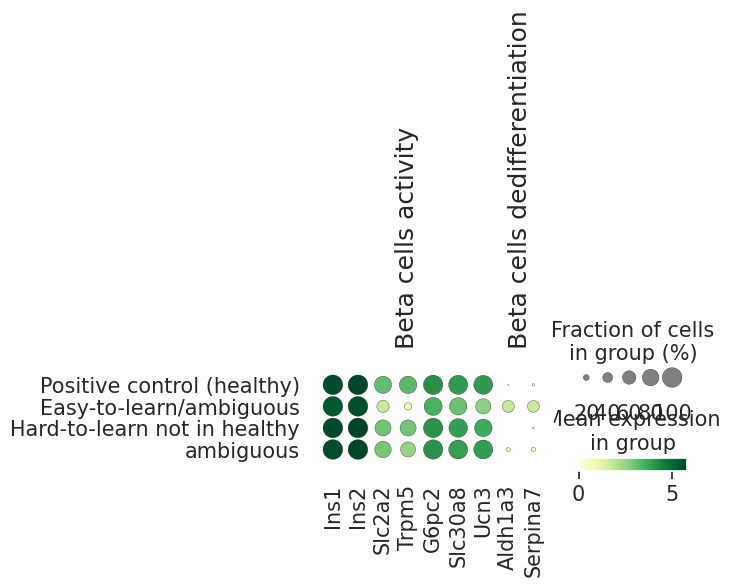

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


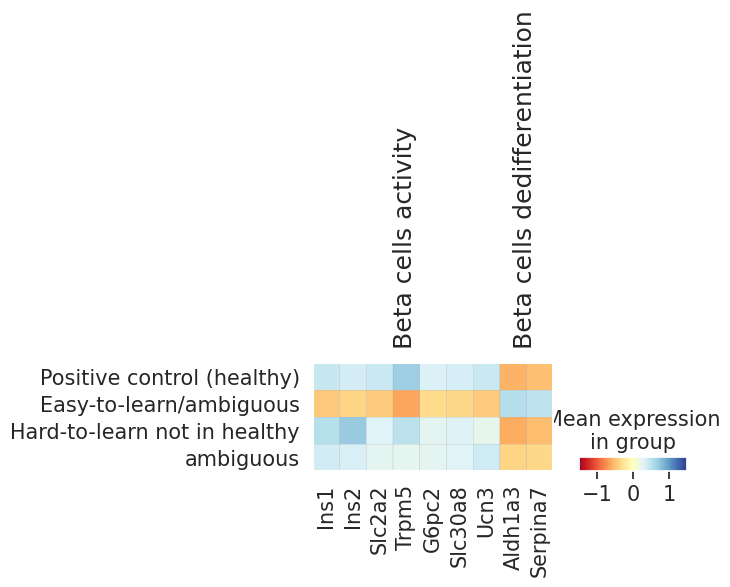

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' 

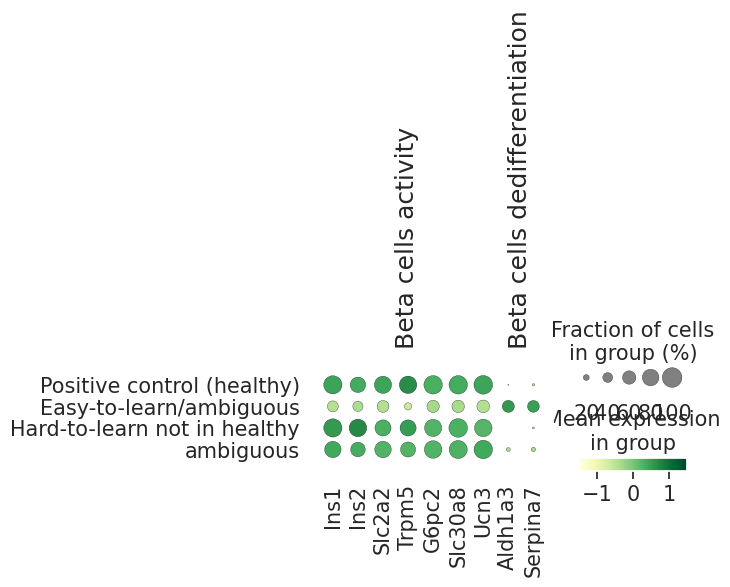

474


In [806]:
adata_beta_stz_ctrl = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E','beta_Ctrl'])]
adata_beta_stz_ctrl.obs['conf_binaries'] = pd.Categorical((adata_beta_stz_ctrl.obs['conf'] > 0.15)
                                                        | (adata_beta_stz_ctrl.obs['var'] > 0.15))
adata_beta_stz_ctrl.obs['conf_binaries_2'] = pd.Categorical((adata_beta_stz_ctrl.obs['conf'] < 0.8))


corr_classified_list =[]
count = 0
COUNT_2 = 0
for i in range(adata_beta_stz_ctrl.n_obs):
    if adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
        corr_classified_list.append('Positive control (healthy)')
    # elif adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i]=='beta_STZ':
    #     corr_classified_list.append('Negative control (STZ)')
    elif adata_beta_stz_ctrl.obs['conf_binaries'][i]==True:
        if adata_beta_stz_ctrl.obs['conf_binaries_2'][i]==True:
            corr_classified_list.append('ambiguous')
            COUNT_2 +=1
        else:
            corr_classified_list.append('Easy-to-learn/ambiguous')
    else:
        corr_classified_list.append('Hard-to-learn not in healthy')
        count +=1
        print(adata_beta_stz_ctrl.obs['groups_named_broad_cond'][i])
adata_beta_stz_ctrl.obs['annotation']=corr_classified_list
order =['Positive control (healthy)','Easy-to-learn/ambiguous','Hard-to-learn not in healthy','ambiguous']
ax = sc.pl.dotplot(adata_beta_stz_ctrl, beta_cells_genes_dict, groupby='annotation',cmap='YlGn',categories_order=order)
temp_annotation_scaled = adata_beta_stz_ctrl.copy()

sc.pp.scale(temp_annotation_scaled)
ax = sc.pl.matrixplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,categories_order=order)
#
# ax = sc.pl.matrixplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,categories_order=order,save='beta_cells_b.png')

ax = sc.pl.dotplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='YlGn',categories_order=order,vmin=-1.5,vmax=1.5)
# print(len(corr_classified_list))
print(COUNT_2)

In [807]:
adata_beta_ctrl

View of AnnData object with n_obs × n_vars = 5664 × 2319
    obs: 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'groups', 'treatment', 'groups_named_broad', 'S_score', 'G2M_score', 'phase', 'proliferation', 'proliferation_man', 'doublet_score', 'groups_named_fine', 'groups_named_beta_dpt', 'Ins-Gcg-Sst', 'groups_named_broad_cond', 'cond', 'batch', 'conf', 'var', 'var_position', 'conf_position'
    var: 'n_cells', 'highly_variable_genes', 'means', 'dispersions', 'dispersions_norm', 'n_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'cond_colors', 'groups_named_broad_cond_colors'
    obsm: 'X_umap', 'X_pca'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

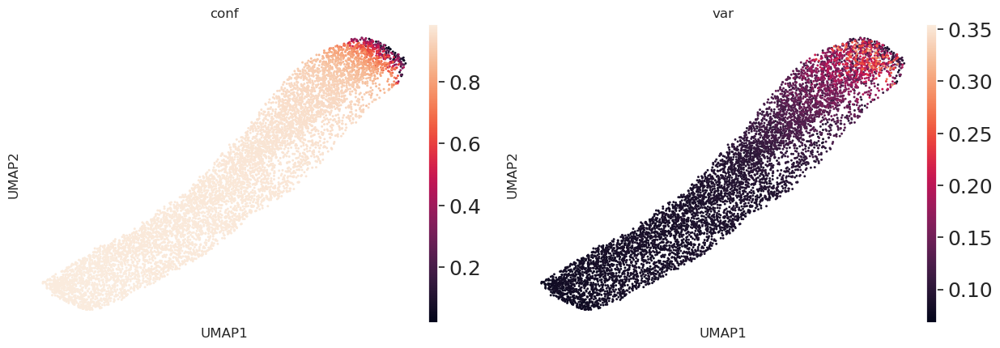

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


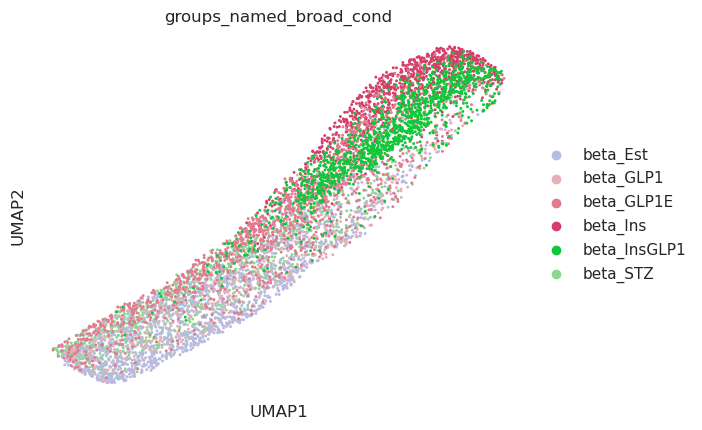

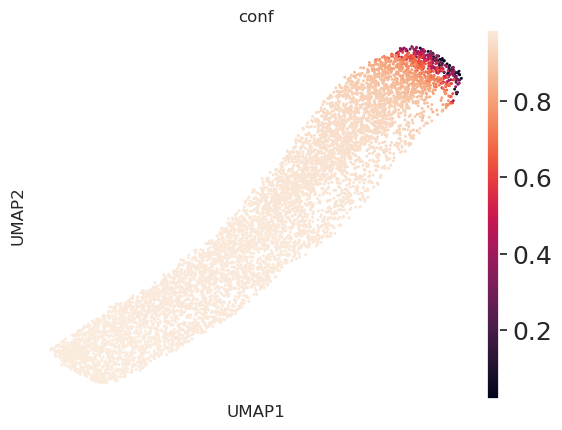

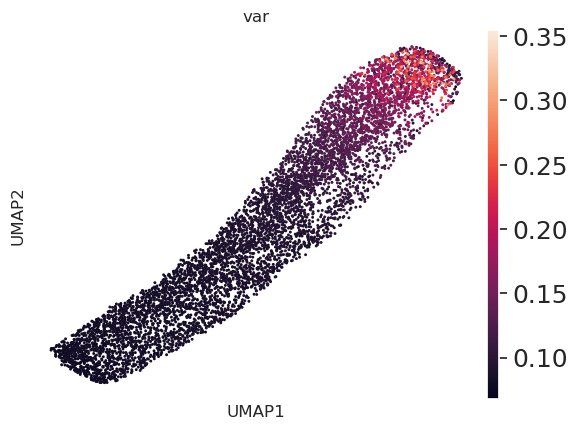

In [829]:

adata_beta_stz_for_graph = adata_beta_stz.copy()

connectivities_graph , distance_graph  = metrics.make_conf_graph(adata_beta_stz_for_graph.copy(), alpha=0.65 , k=15)

adata_beta_stz_for_graph.obsp['connectivities']=sparse.csr_matrix(connectivities_graph)
sc.tl.umap(adata_beta_stz_for_graph)
sc.pl.umap(adata_beta_stz_for_graph, color=['conf','var'])
sc.pl.umap(adata_beta_stz_for_graph,color=['groups_named_broad_cond'])
sc.pl.umap(adata_beta_stz_for_graph,color=['conf'])
sc.pl.umap(adata_beta_stz_for_graph,color=['var'])
# sc.pl.umap(adata_beta_stz_for_graph,color=['annotation'])


sorted_indices_conf = np.argsort(adata_beta_stz_for_graph.obs['conf'])
positions_conf = np.empty_like(sorted_indices_conf)
positions_conf[sorted_indices_conf] = np.arange(len((adata_beta_stz_for_graph.obs['conf'])))
n = len(sorted_indices_conf)

mean_distance_conf = metrics.mean_absolute_distance(n)





sorted_indices_var = np.argsort(adata_beta_stz_for_graph.obs['var'])
positions_var = np.empty_like(sorted_indices_var)
positions_var[sorted_indices_var] = np.arange(len((adata_beta_stz_for_graph.obs['var'])))





adata_beta_stz_for_graph.obs['var_position'] = positions_var/mean_distance_conf
adata_beta_stz_for_graph.obs['conf_position'] = positions_conf/mean_distance_conf
    # for i in range(n):


In [830]:

sorted_indices_conf = np.argsort(adata_stz_ctrl.obs['conf'])
positions_conf = np.empty_like(sorted_indices_conf)
positions_conf[sorted_indices_conf] = np.arange(len((adata_stz_ctrl.obs['conf'])))
n = len(sorted_indices_conf)

mean_distance_conf = metrics.mean_absolute_distance(n)





sorted_indices_var = np.argsort(adata_stz_ctrl.obs['var'])
positions_var = np.empty_like(sorted_indices_var)
positions_var[sorted_indices_var] = np.arange(len((adata_stz_ctrl.obs['var'])))


adata_stz_ctrl.obs['var_position'] = positions_var/mean_distance_conf
adata_stz_ctrl.obs['conf_position'] = positions_conf/mean_distance_conf

In [831]:
# mean_distance_conf = metrics.mean_absolute_distance(n)
#
# sorted_indices_conf = np.argsort(adata_beta_stz_for_graph.obs['conf'])
# positions_conf = np.empty_like(sorted_indices_conf)
# positions_conf[sorted_indices_conf] = np.arange(len((adata_beta_stz_for_graph.obs['conf'])))
# n = len(sorted_indices_conf)
#
#
#
# sorted_indices_var = np.argsort(adata_beta_stz_for_graph.obs['var'])
# positions_var = np.empty_like(sorted_indices_var)
# positions_var[sorted_indices_var] = np.arange(len((adata_beta_stz_for_graph.obs['var'])))
#
#
#
#
#
# adata_beta_stz_for_graph.obs['var_position'] = positions_var/mean_distance_conf
# adata_beta_stz_for_graph.obs['conf_position'] = positions_conf/mean_distance_conf
#
# sc.pl.umap(adata_beta_stz_for_graph,color=['var_position'])
# sc.pl.umap(adata_beta_stz_for_graph,color=['conf_position'])


<Figure size 640x480 with 0 Axes>

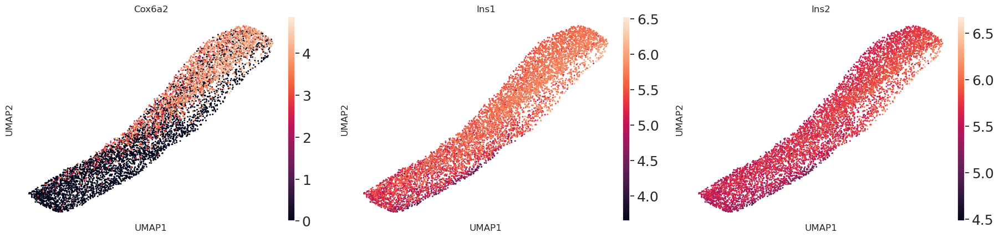

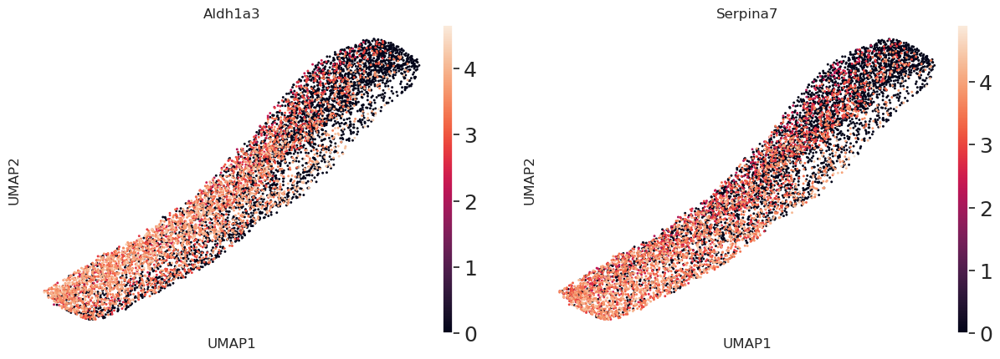

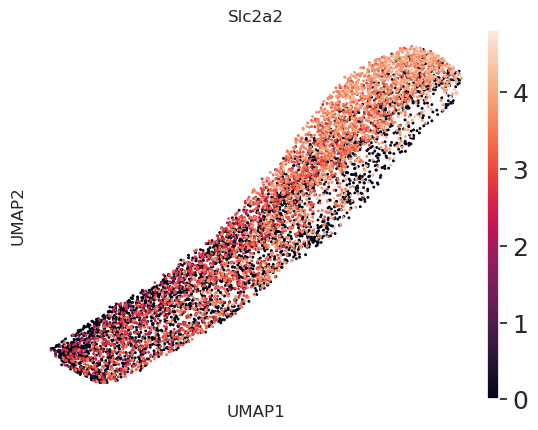

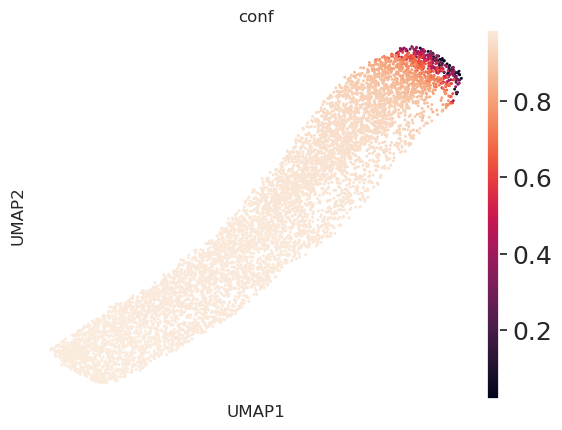

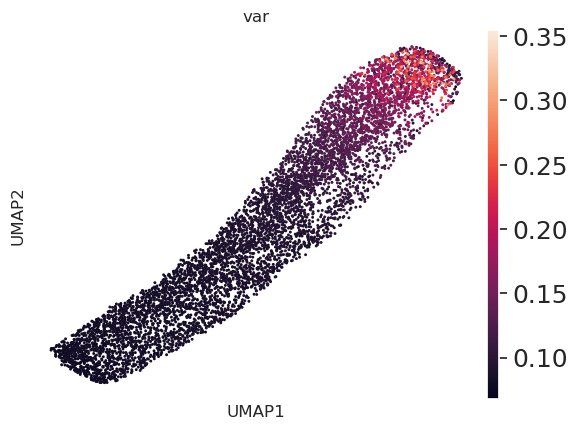

...

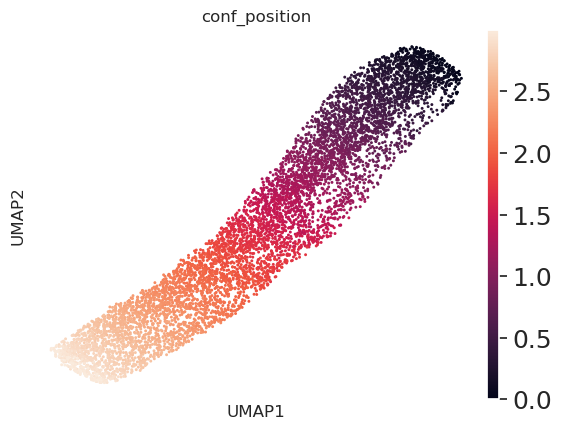

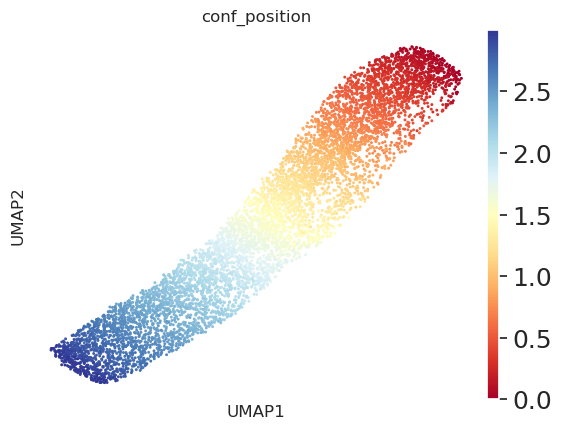

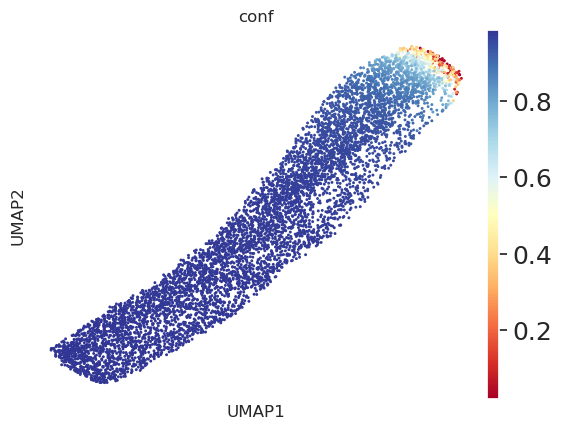

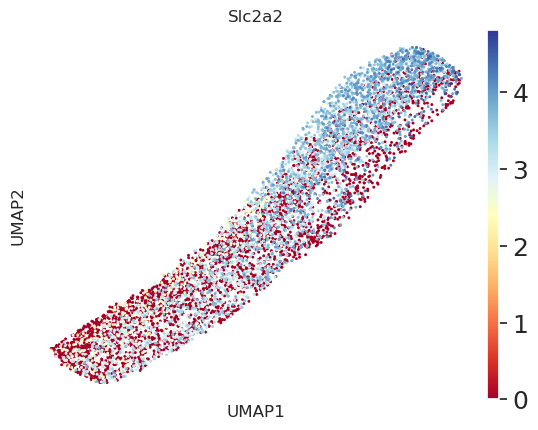

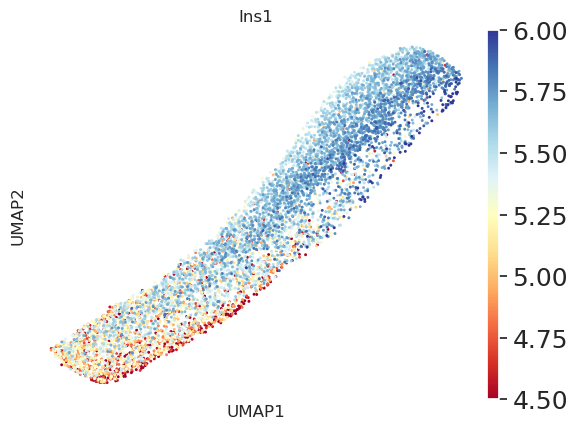

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


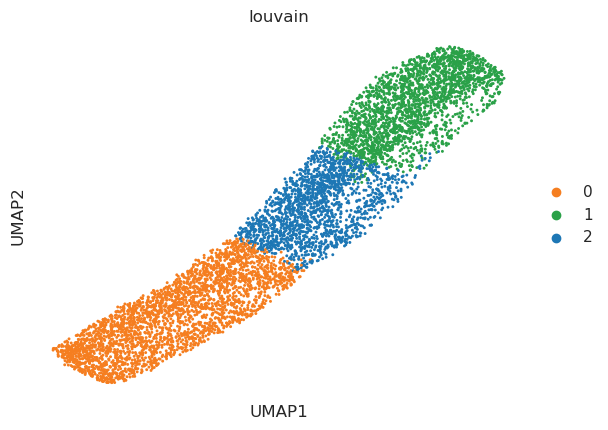

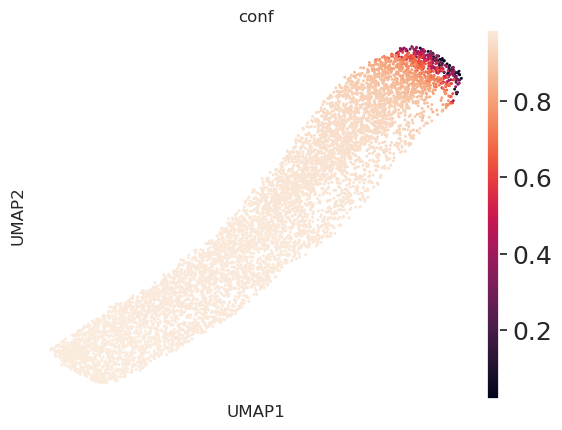

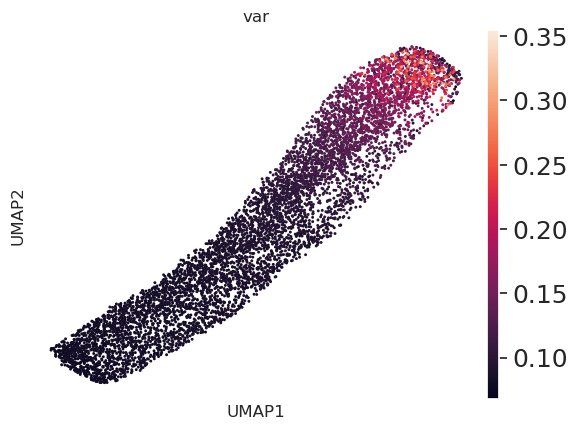

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


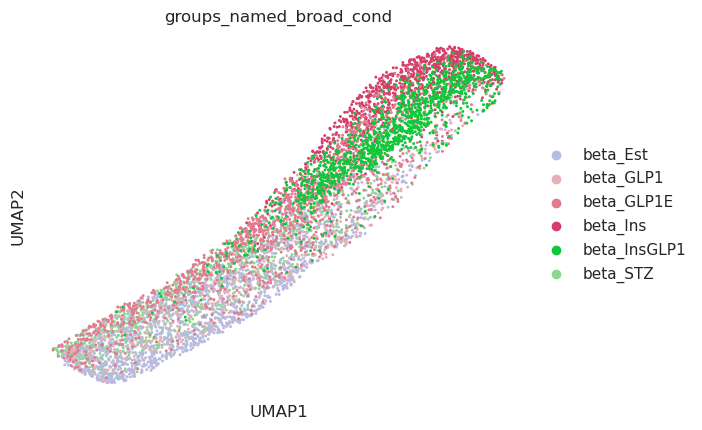

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


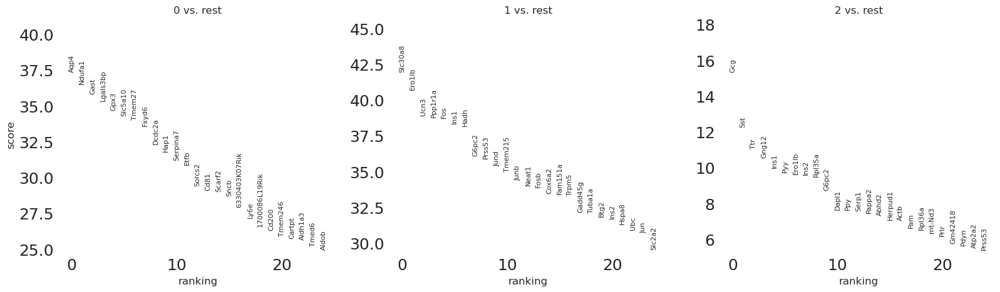

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


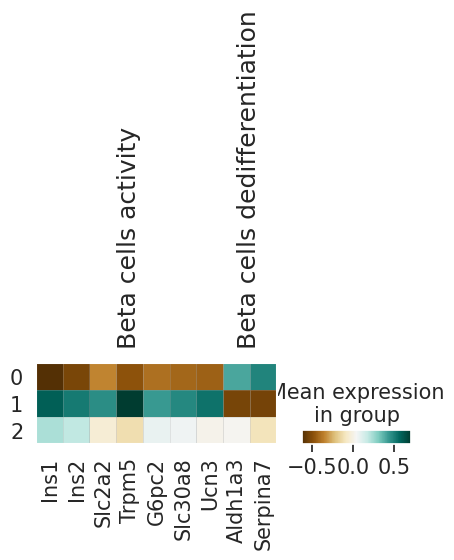

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


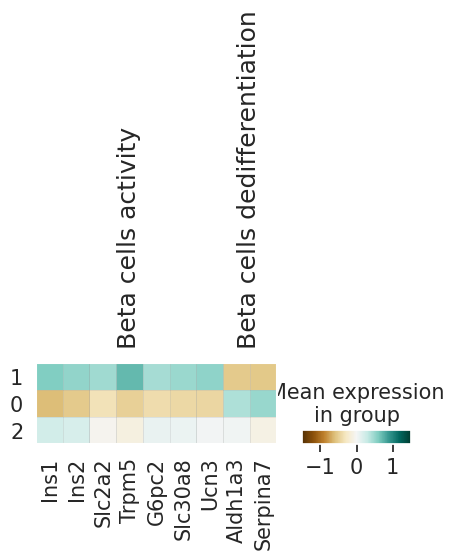

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


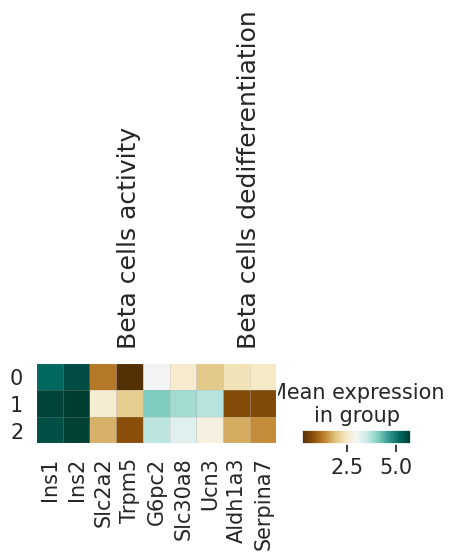

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' 

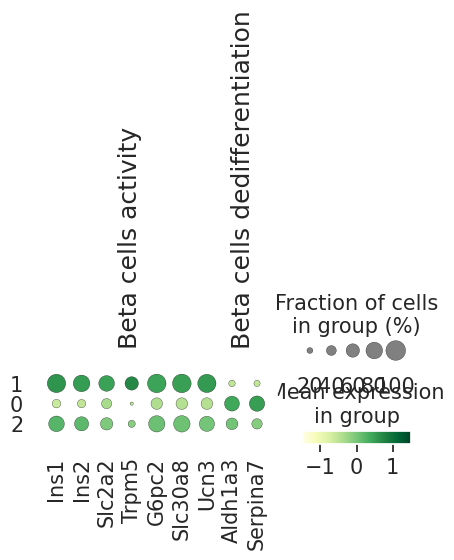

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


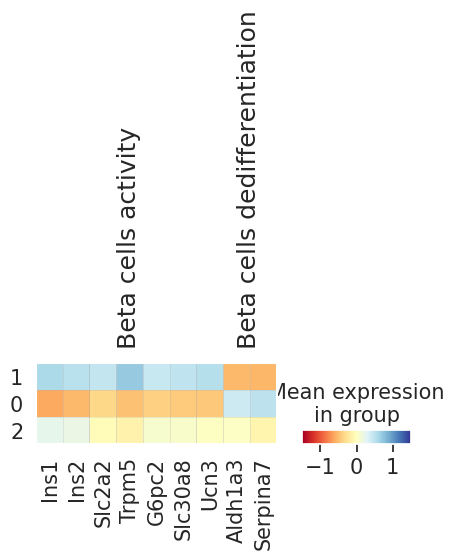

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


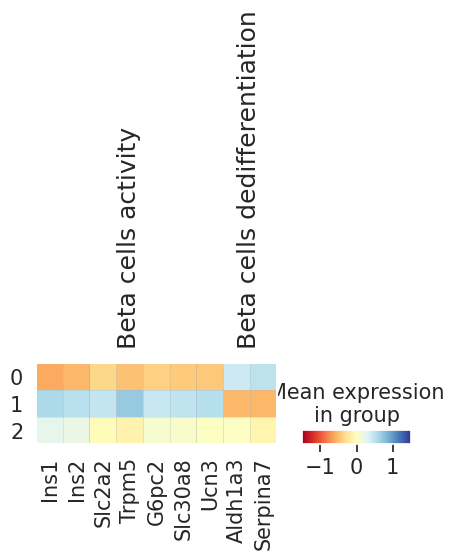

graph
0
-1.7517338
Slc2a2
0
-3.621963
Trpm5
0
-2.0052705
Ucn3
0
-0.28910407
Ins2
0
-1.293232
G6pc2
0
-1.5045501
Slc30a8
0
-0.58459914
Ins1
$$$$$$
Mean of embedded graph logfold change: -1.5786362
1
1.4810512
Slc30a8
1
2.1004915
Ucn3
1
0.49325415
Ins1
1
1.2338128
G6pc2
1
3.538809
Trpm5
1
0.2465891
Ins2
1
1.955505
Slc2a2
$$$$$$
Mean of embedded graph logfold change: 1.5785018
2
0.17029427
Ins1
2
0.08125514
Ins2
2
0.2031769
G6pc2
2
0.17489083
Slc30a8
2
0.05633627
Ucn3
2
-0.15494362
Slc2a2
2
-0.6233802
Trpm5
$$$$$$
Mean of embedded graph logfold change: -0.01319577
0
2.6233432
Serpina7
0
2.11562
Aldh1a3
$$$$$$
Mean of embedded graph logfold change: 2.3694816
1
-2.7345147
Aldh1a3
1
-2.831438
Serpina7
$$$$$$
Mean of embedded graph logfold change: -2.7829764
2
0.12850793
Aldh1a3
2
-0.43727806
Serpina7
$$$$$$
Mean of embedded graph logfold change: -0.15438506


In [853]:
sns.despine()

sc.pl.umap(adata_beta_stz_for_graph,color=['Cox6a2','Ins1','Ins2'])
sc.pl.umap(adata_beta_stz_for_graph,color=['Aldh1a3','Serpina7'])
sc.pl.umap(adata_beta_stz_for_graph,color=['Slc2a2'])
sc.pl.umap(adata_beta_stz_for_graph,color=['conf'])
sc.pl.umap(adata_beta_stz_for_graph,color=['var'])
sc.pl.umap(adata_beta_stz_for_graph,color=['var_position'])
sc.pl.umap(adata_beta_stz_for_graph,color=['conf_position'])


sc.pl.umap(adata_beta_stz_for_graph,color=['conf_position'],cmap='RdYlBu',save='v5_conf_position.png')
sc.pl.umap(adata_beta_stz_for_graph,color=['conf'],cmap='RdYlBu',save='v5_conf.png')
sc.pl.umap(adata_beta_stz_for_graph,color=['Slc2a2'],cmap='RdYlBu',save='v5_Slc2a2.png')
sc.pl.umap(adata_beta_stz_for_graph,color=['Ins1'],cmap='RdYlBu',vmin=4.5,vmax=6,save='v5_Ins1.png')

colors_dict = {
    'green': '#2AA148',
    'blue': '#1D77B5',
    'orange': '#F57E20'
}
# costum_colors = [colors_dict['orange'],colors_dict['blue'],colors_dict['green']]
costum_colors = [colors_dict['orange'],colors_dict['green'],colors_dict['blue']]




# sc.tl.louvain(adata_beta_stz_for_graph, resolution=0.2)
sc.tl.louvain(adata_beta_stz_for_graph, resolution=0.2)
sc.pl.umap(adata_beta_stz_for_graph,color=['louvain'],save='v5_cluster_umap.png',palette=costum_colors)
sc.pl.umap(adata_beta_stz_for_graph,color=['conf'])
sc.pl.umap(adata_beta_stz_for_graph,color=['var'])
sc.pl.umap(adata_beta_stz_for_graph,color=['groups_named_broad_cond'])
adata_beta_stz_graph = adata_beta_stz_for_graph[adata_beta_stz_for_graph.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_GLP1','beta_Ins','beta_InsGLP1','beta_Est','beta_GLP1E'])].copy()
sc.tl.rank_genes_groups(adata_beta_stz_graph, 'louvain' ,method='wilcoxon')
sc.pl.rank_genes_groups(adata_beta_stz_graph, n_genes=25, sharey=False)
adata_beta_stz_for_graph_scaled = adata_beta_stz_for_graph.copy()
sc.pp.scale(adata_beta_stz_for_graph_scaled)

ax = sc.pl.matrixplot(adata_beta_stz_for_graph_scaled, beta_cells_genes_dict, groupby='louvain',cmap='BrBG')


ax = sc.pl.matrixplot(adata_beta_stz_for_graph_scaled, beta_cells_genes_dict, groupby='louvain',cmap='BrBG',vmin=-1.5,vmax=1.5,categories_order=['1','0','2'])
ax = sc.pl.matrixplot(adata_beta_stz_for_graph, beta_cells_genes_dict, groupby='louvain',cmap='BrBG')
ax = sc.pl.dotplot(adata_beta_stz_for_graph_scaled, beta_cells_genes_dict, groupby='louvain',cmap='YlGn',categories_order=['1','0','2'],vmin=-1.5,vmax=1.5)

ax = sc.pl.matrixplot(adata_beta_stz_for_graph_scaled, beta_cells_genes_dict, groupby='louvain',cmap='RdYlBu',categories_order=['1','0','2'],vmin=-1.5,vmax=1.5)
# adata_ctrl
ax = sc.pl.matrixplot(adata_beta_stz_for_graph_scaled, beta_cells_genes_dict, groupby='louvain',cmap='RdYlBu',vmin=-1.5,vmax=1.5)




b_cells_activity = ['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2', 'Slc30a8', 'Ucn3']


print("graph")
for cluster_num in range(3):
    b_cells_activity_graph = []
    for i , j  in enumerate(adata_beta_stz_graph.uns['rank_genes_groups']['names']):
        if j[cluster_num] in b_cells_activity:
            print(cluster_num)
            print(adata_beta_stz_graph.uns['rank_genes_groups']['logfoldchanges'][i][cluster_num])
            print(j[cluster_num])
            b_cells_activity_graph.append(adata_beta_stz_graph.uns['rank_genes_groups']['logfoldchanges'][i][cluster_num])
    print("$$$$$$")

    print("Mean of embedded graph logfold change: " + str(np.mean(np.array(b_cells_activity_graph))))
dedef = ['Aldh1a3', 'Serpina7']
for cluster_num in range(3):
    b_cells_activity_graph = []
    for i , j  in enumerate(adata_beta_stz_graph.uns['rank_genes_groups']['names']):
        if j[cluster_num] in dedef:
            print(cluster_num)
            print(adata_beta_stz_graph.uns['rank_genes_groups']['logfoldchanges'][i][cluster_num])
            print(j[cluster_num])
            b_cells_activity_graph.append(adata_beta_stz_graph.uns['rank_genes_groups']['logfoldchanges'][i][cluster_num])
    print("$$$$$$")

    print("Mean of embedded graph logfold change: " + str(np.mean(np.array(b_cells_activity_graph))))
average_expression_values_activity_dict = {}
average_expression_dediffy_dict ={}
# Loop through each gene in the list





/tmp/ipykernel_48085/2297550949.py:4: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
/tmp/ipykernel_48085/2297550949.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
/tmp/ipykernel_48085/2297550949.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always b

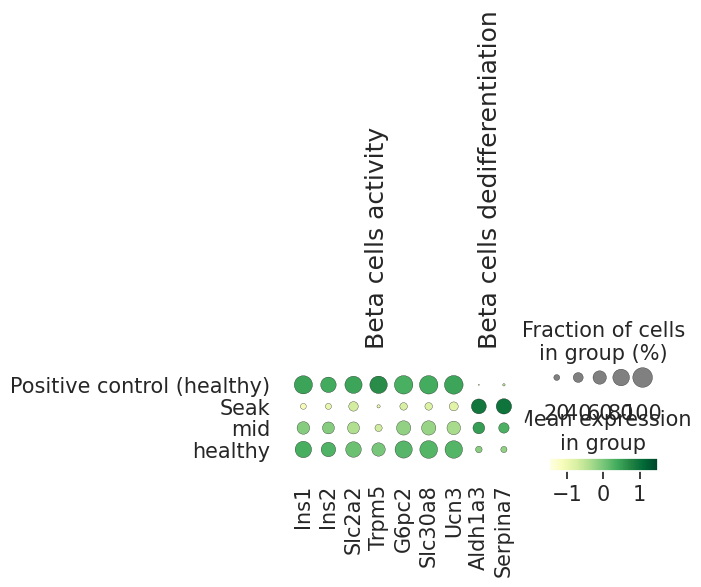

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


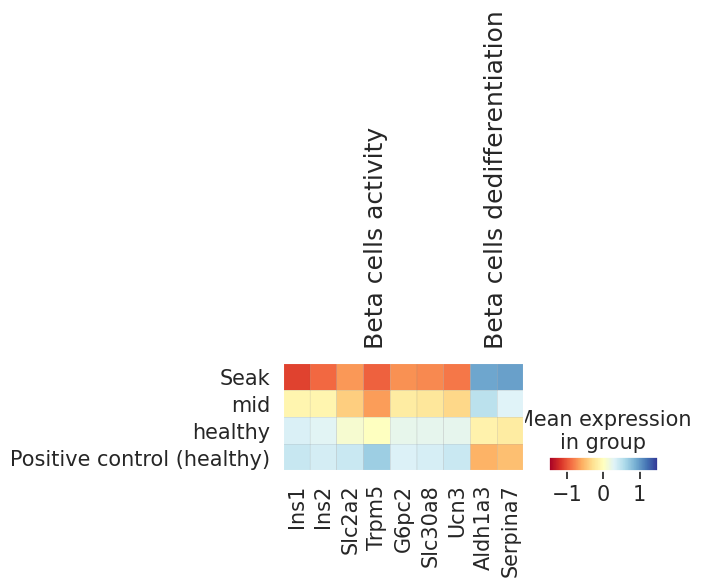

In [843]:
#fig c and j 
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
corr_classified_list = []
# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
    if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
        corr_classified_list.append('Positive control (healthy)')
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
        corr_classified_list.append("healthy")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
        corr_classified_list.append("Seak")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
        corr_classified_list.append("mid")
temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list
sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)
ax = sc.pl.dotplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='YlGn',categories_order=['Positive control (healthy)',"Seak","mid","healthy"],vmin=-1.5,vmax=1.5)

# ax = sc.pl.matrixplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',
#                       categories_order=['Positive control (healthy)',"Seak","mid","healthy"],vmin=-1.5,vmax=1.5,save='beta_cells_c.png')

ax = sc.pl.matrixplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',
                      categories_order=["Seak","mid","healthy",'Positive control (healthy)'],vmin=-1.5,vmax=1.5,save='beta_cells_c.png')
#
# temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp[temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'].isin(["beta_Ins","beta_InsGLP1","beta_Ctrl"])]
# temp_ = temp[temp.obs['annotation'].isin(['Positive control (healthy)',"mid","healthy"])]
#
#
#
#
# ax = sc.pl.dotplot(temp_, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,save='beta_cells_j_ins_only.png',categories_order=["mid","healthy",'Positive control (healthy)'])
# ax = sc.pl.matrixplot(temp_, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5)
#
# temp_v = temp[temp.obs['annotation'].isin(["mid"])]
# print(temp_v)
# temp_v = temp[temp.obs['annotation'].isin(["healthy"])]
# print(temp_v)
# temp_v = temp[temp.obs['annotation'].isin(["Seak"])]


In [834]:
all=818+1431+10
print("mid",818/all)
print("healthy",1431/all)
print("Seak",10/all)




mid 0.3621071270473661
healthy 0.6334661354581673
Seak 0.004426737494466578


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


AnnData object with n_obs × n_vars = 2780 × 2319
    obs: 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'groups', 'treatment', 'groups_named_broad', 'S_score', 'G2M_score', 'phase', 'proliferation', 'proliferation_man', 'doublet_score', 'groups_named_fine', 'groups_named_beta_dpt', 'Ins-Gcg-Sst', 'groups_named_broad_cond', 'cond', 'batch', 'conf', 'var', 'var_position', 'conf_position', 'louvain', 'annotation'
    var: 'n_cells', 'highly_variable_genes', 'means', 'dispersions', 'dispersions_norm', 'n_counts', 'mean', 'std'
    obsm: 'X_umap', 'X_pca'
Seak
AnnData object with n_obs × n_vars = 1752 × 2319
    obs: 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'groups', 'treatment', 'groups_named_broad', 'S_score', 'G2M_score', 'phase', 'proliferation', 'proliferation_man', 'doublet_score', 'groups_named_fine', 'groups_named_beta_dpt', 'Ins-Gcg-Sst', 'groups_named_broad_cond', 'cond', 'batch', 'conf', 'var', 'var_position', 'conf_position', 'louvain', 'annotation'
    va

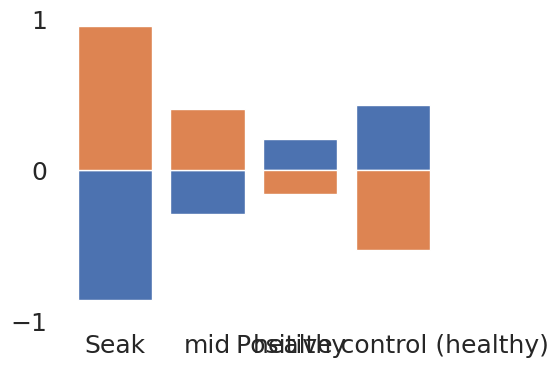

AnnData object with n_obs × n_vars = 12414 × 2319
    obs: 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'groups', 'treatment', 'groups_named_broad', 'S_score', 'G2M_score', 'phase', 'proliferation', 'proliferation_man', 'doublet_score', 'groups_named_fine', 'groups_named_beta_dpt', 'Ins-Gcg-Sst', 'groups_named_broad_cond', 'cond', 'batch', 'conf', 'var', 'var_position', 'conf_position', 'louvain', 'annotation'
    var: 'n_cells', 'highly_variable_genes', 'means', 'dispersions', 'dispersions_norm', 'n_counts', 'mean', 'std'
    obsm: 'X_umap', 'X_pca'

In [844]:
average_expression_values_activity_dict = {}
average_expression_dediffy_dict ={}

for cluster in ["Seak", "mid", "healthy", "Positive control (healthy)"]:
    #if cluster key is not in the dictionary, add it
    if cluster not in average_expression_values_activity_dict:
        average_expression_values_activity_dict[cluster] = []
    if cluster not in average_expression_dediffy_dict:
        average_expression_dediffy_dict[cluster] = []
    temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp[temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation'].isin([cluster])].copy()
    print(temp)
    print(cluster)
    for gene in b_cells_activity:
        gene_index = temp.var_names.get_loc(gene)
        gene_expression_values = temp.X[:, gene_index]
        average_expression_values_activity_dict[cluster].append(np.mean(gene_expression_values))
    for gene in dedef:
        gene_index = temp.var_names.get_loc(gene)
        gene_expression_values = temp.X[:, gene_index]
        average_expression_dediffy_dict[cluster].append(np.mean(gene_expression_values))

# Calculate the final average of the average gene expression values

print(average_expression_values_activity_dict)
print(average_expression_dediffy_dict)
#convert the dictionary so that each list will be the mean value of the gene expression values
for cluster in average_expression_values_activity_dict:
    average_expression_values_activity_dict[cluster] = np.mean(average_expression_values_activity_dict[cluster])
    average_expression_dediffy_dict[cluster] = np.mean(average_expression_dediffy_dict[cluster])
print(average_expression_values_activity_dict)
print(average_expression_dediffy_dict)
#plot bott dicts in the same plot and change order of the bars
fig, ax = plt.subplots(figsize=(5,4))
# the order 1,0,2 is the order of the clusters
# ax.bar(average_expression_values_activity_dict.keys(), average_expression_values_activity_dict.values(), label='activity/maturation')
ax.bar(average_expression_values_activity_dict.keys(), average_expression_values_activity_dict.values())

# ax.bar(average_expression_dediffy_dict.keys(), average_expression_dediffy_dict.values(), label='dedifferentiation')
ax.bar(average_expression_dediffy_dict.keys(), average_expression_dediffy_dict.values())

plt.yticks([-1, 0, 1])
ax.legend()
plt.legend(frameon=False)
plt.savefig('figures/d_v4.png', dpi=600, bbox_inches='tight')
plt.savefig('figures/d_v4.svg', format='svg', dpi=600)
plt.show()
temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp

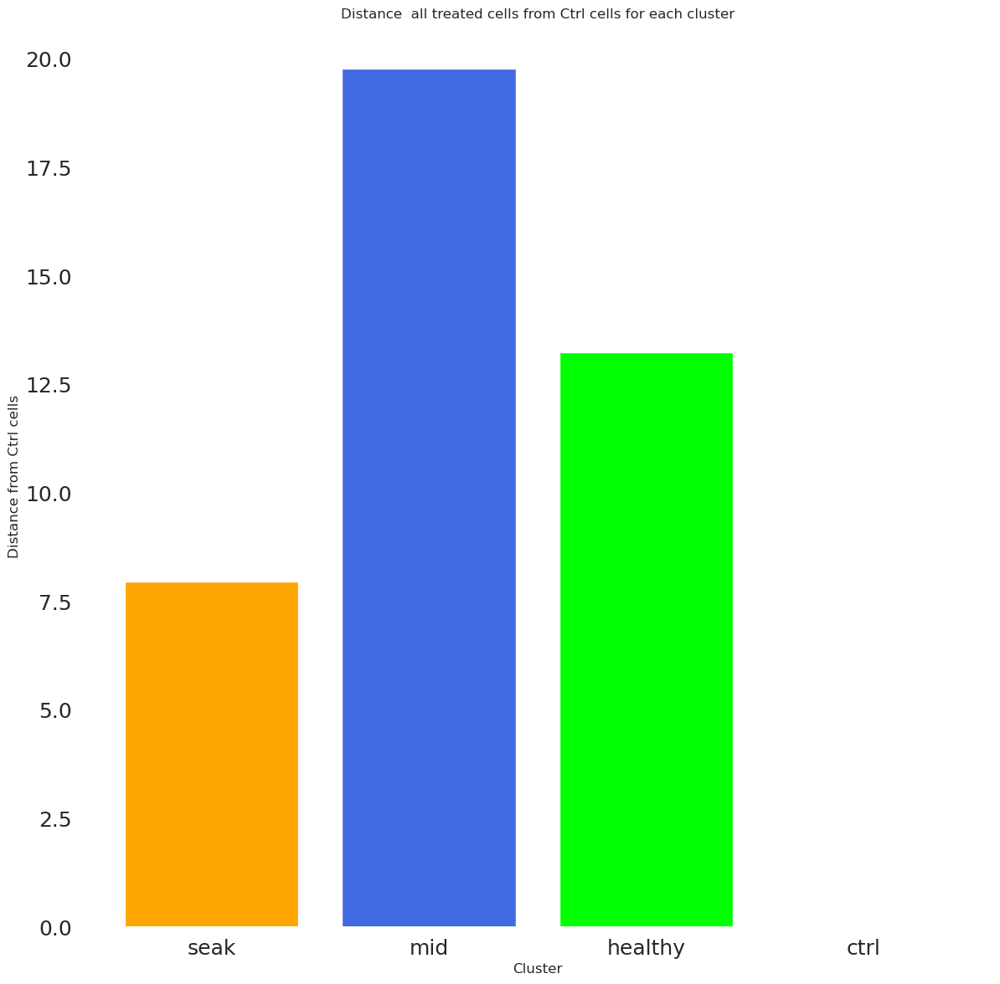

7.958415 19.793554 13.244141


In [836]:

ctrl_mean = np.mean(adata_beta_ctrl.X.toarray(), axis=0)
all_treated_list = []
for cluster in ['0','1','2']:
    temp = adata_beta_stz_for_graph[adata_beta_stz_for_graph.obs["louvain"].isin([cluster])].copy()


    adata_beta_only_all_treated_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]


    all_treated_mean_temp = np.mean(adata_beta_only_all_treated_temp.X.toarray(), axis=0)



    all_treated_list.append(np.linalg.norm(ctrl_mean-all_treated_mean_temp))


#plot the cluster and all_treated_dist as a bar graph
plt.figure(figsize=(14,14))
plt.bar(np.arange(0,4), [all_treated_list[1],all_treated_list[0],all_treated_list[2],0],color =['orange','royalblue','lime','darkgreen'])
plt.xticks(np.arange(0,4), ['seak','mid','healthy','ctrl'])
plt.xlabel('Cluster')
plt.ylabel('Distance from Ctrl cells')
plt.title('Distance  all treated cells from Ctrl cells for each cluster')
# plt.savefig(f'figures/e_up.png')
plt.show()
print(all_treated_list[1],all_treated_list[0],all_treated_list[2])

0 stz
1 ins
2 glp1
3 Insglp1
4 Est
5 glp1e
6 all_treated


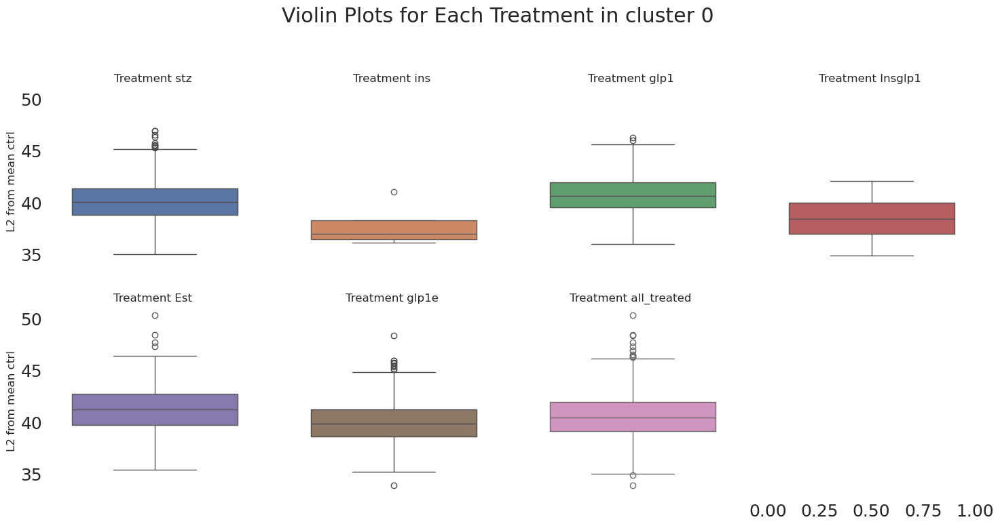

0 stz
1 ins
2 glp1
3 Insglp1
4 Est
5 glp1e
6 all_treated


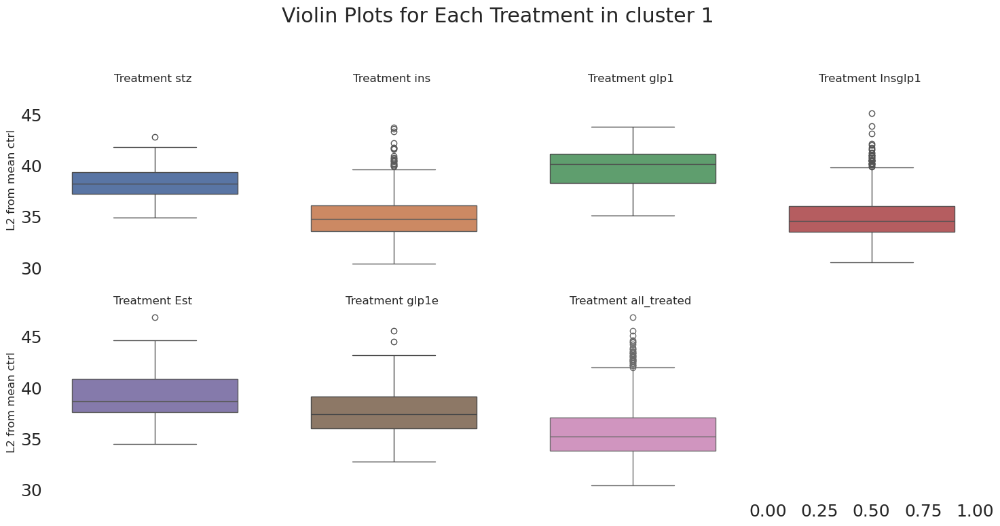

0 stz
1 ins
2 glp1
3 Insglp1
4 Est
5 glp1e
6 all_treated


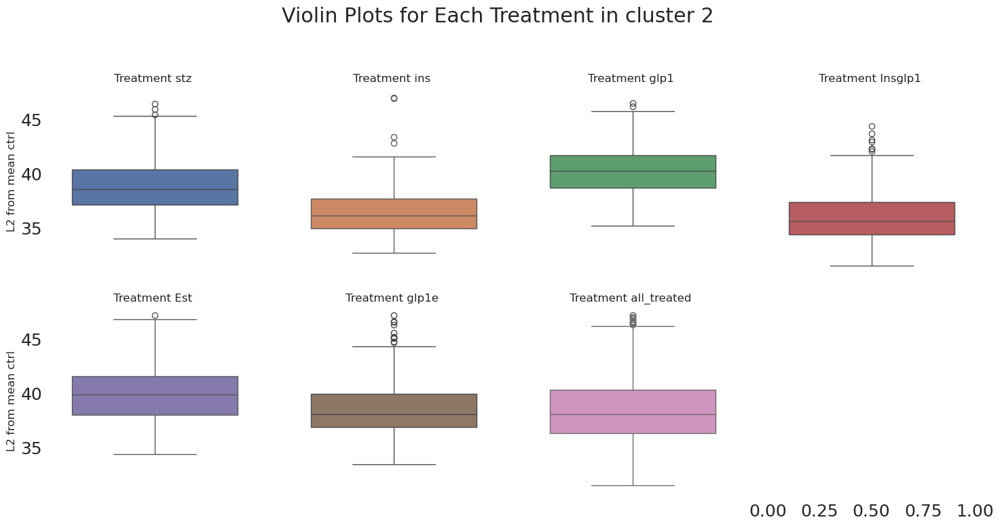

/tmp/ipykernel_48085/1781340214.py:59: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['seak','mid','healthy like','ctrl'])


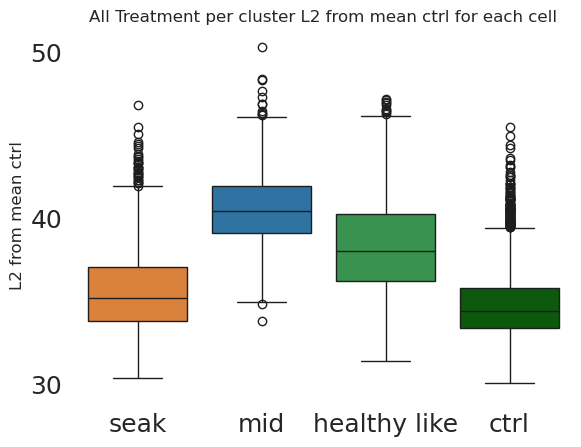

/tmp/ipykernel_48085/1781340214.py:68: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['seak','mid','healthy like','ctrl'])


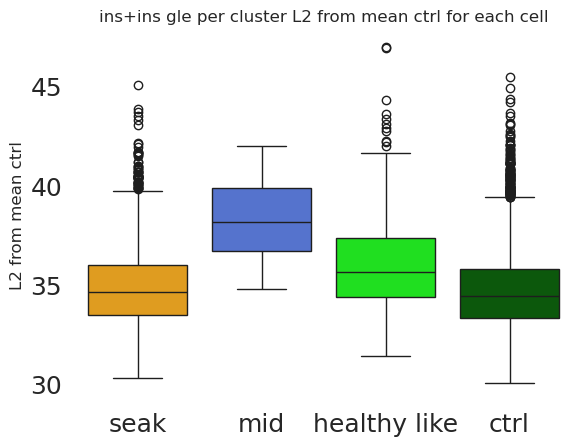

In [837]:

all_treated_per_cluster = []
all_treated_per_cluster_ins = []
ctrl_mean = np.mean(adata_beta_ctrl.X.toarray(), axis=0)
for cluster in ['0','1','2']:
    temp = adata_beta_stz_for_graph[adata_beta_stz_for_graph.obs["louvain"].isin([cluster])].copy()
    adata_beta_only_stz_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_STZ'])]
    adata_beta_only_ins_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_Ins'])]
    adata_beta_only_glp1_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_GLP1'])]
    adata_beta_only_Insglp1_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_InsGLP1'])]
    adata_beta_only_Est_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_Est'])]
    adata_beta_only_glp1e_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_GLP1E'])]

    adata_beta_all_ins = temp[temp.obs['groups_named_broad_cond'].isin(['beta_Ins','beta_InsGLP1'])]

    adata_beta_only_all_treated_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]
    test_stz = np.linalg.norm(adata_beta_only_stz_temp.X.toarray() - ctrl_mean, axis=1)
    #
    test_ins = np.linalg.norm(adata_beta_only_ins_temp.X.toarray() - ctrl_mean, axis=1)
    test_glp1 = np.linalg.norm(adata_beta_only_glp1_temp.X.toarray() - ctrl_mean, axis=1)
    test_Insglp1 = np.linalg.norm(adata_beta_only_Insglp1_temp.X.toarray() - ctrl_mean, axis=1)
    test_Est = np.linalg.norm(adata_beta_only_Est_temp.X.toarray() - ctrl_mean, axis=1)
    test_glp1e = np.linalg.norm(adata_beta_only_glp1e_temp.X.toarray() - ctrl_mean, axis=1)
    test_all_treated = np.linalg.norm(adata_beta_only_all_treated_temp.X.toarray() - ctrl_mean, axis=1)
    all_treated_per_cluster.append(test_all_treated)
    arrays = [test_stz,test_ins,test_glp1,test_Insglp1,test_Est,test_glp1e,test_all_treated]
    all_ins_temp = np.linalg.norm(adata_beta_all_ins.X.toarray() - ctrl_mean, axis=1)
    all_treated_per_cluster_ins.append(all_ins_temp)
    names = ['stz', 'ins', 'glp1', 'Insglp1', 'Est', 'glp1e', 'all_treated']

    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(15, 8), sharey=True)
    fig.suptitle(f'Violin Plots for Each Treatment in cluster {cluster}')


    colors =['orange','blue','lime','darkgreen']
    for i, (array, ax) in enumerate(zip(arrays, axes.flatten()), 0):
        print(i,names[i])


        sns.boxplot(y=array, ax=ax, color=f'C{i}')

        ax.set_title(f'Treatment {names[i]} ')
        ax.set_ylabel('L2 from mean ctrl')

    plt.tight_layout(rect=[0, 0, 1, 0.96])

    plt.show()

colors_dict = {
    'green': '#2AA148',
    'blue': '#1D77B5',
    'orange': '#F57E20'
}
# costum_colors = [colors_dict['orange'],colors_dict['blue'],colors_dict['green']]
costum_colors = [colors_dict['orange'],colors_dict['blue'],colors_dict['green'],'darkgreen']
test_ctrl = np.linalg.norm(adata_beta_ctrl.X.toarray() - ctrl_mean, axis=1)
to_plot = [all_treated_per_cluster[1],all_treated_per_cluster[0],all_treated_per_cluster[2],test_ctrl]
ax = sns.boxplot(data=to_plot,palette=costum_colors)
ax.set_title('All Treatment per cluster L2 from mean ctrl for each cell')
ax.set_xticklabels(['seak','mid','healthy like','ctrl'])
ax.set_ylabel('L2 from mean ctrl')
plt.yticks([30, 40, 50])
plt.savefig('figures/e_v4.png', dpi=600, bbox_inches='tight')
plt.savefig('figures/e_v4.svg', format='svg', dpi=600)
plt.show()
to_plot =[all_treated_per_cluster_ins[1],all_treated_per_cluster_ins[0],all_treated_per_cluster_ins[2],test_ctrl]
ax = sns.boxplot(data=to_plot,palette=['orange','royalblue','lime','darkgreen'])
ax.set_title('ins+ins gle per cluster L2 from mean ctrl for each cell')
ax.set_xticklabels(['seak','mid','healthy like','ctrl'])
ax.set_ylabel('L2 from mean ctrl')

#save fig

plt.show()


In [838]:


from scipy.sparse import csr_matrix
from scipy.sparse.linalg import norm
from sklearn.metrics import roc_auc_score , pairwise_distances

# Assuming 'adata' is your AnnData object
# Convert the data matrix to a sparse matrix
data_sparse = csr_matrix(adata_beta_ctrl.X)

# Compute pairwise distances
# distances = np.zeros((adata_beta_ctrl.X.shape[0], adata_beta_ctrl.X.shape[0]))
# for i in range(adata_beta_ctrl.X.shape[0]):
#     print(i)
#     for j in range(i+1, adata_beta_ctrl.X.shape[0]):
#         distances[i, j] = norm(data_sparse[i] - data_sparse[j])
#         distances[j, i] = distances[i, j]
distances = pairwise_distances(adata_beta_ctrl.X,metric='l2')

# Calculate sum of distances for each cell
sum_distances = np.sum(distances, axis=1)
print(sum_distances)
# Find the index of the cell with the minimum sum of distances
medoid_idx = np.argmin(sum_distances)

# Access the medoid cell
medoid_cell = adata_beta_ctrl.obs_names[medoid_idx]

print("Medoid cell:", medoid_cell)




[272428.84 271615.75 279132.62 ... 283788.1  277159.94 267918.  ]
Medoid cell: TGCGGGTAGGGTCGAT-1_G1-1


In [839]:
distances[medoid_idx]
medoid_idx
values = distances[(distances > 0) & (distances < 40)]
values

array([39.642494, 39.736824, 39.408943, 39.889362, 39.94307 , 38.654556,
       39.830612, 39.90742 , 39.52002 , 39.706886, 39.816982, 39.47666 ,
       39.99121 , 39.882977, 39.619675, 39.396626, 39.746254, 39.700035,
       39.660007, 39.75646 , 39.456837, 39.738525, 39.94307 , 38.825356,
       39.948227, 39.761314, 39.66852 , 38.603916, 39.970715, 39.090107,
       39.215405, 39.877567, 39.88593 , 39.528175, 39.031796, 39.727707,
       39.865284, 39.924564, 39.938934, 39.98976 , 39.93968 , 39.939823,
       39.666756, 39.81317 , 39.85988 , 39.663803, 39.5898  , 39.50862 ,
       39.3024  , 39.597523, 39.341663, 39.828312, 39.757664, 39.708893,
       39.90191 , 39.889362, 39.706886, 39.47666 , 39.738525, 38.825356,
       39.93968 , 39.757664, 39.96878 , 39.82716 , 38.38103 , 39.71525 ,
       39.282356, 39.53308 , 39.563404, 38.63545 , 39.994892, 39.878716,
       39.76145 , 39.107998, 39.43979 , 39.890636, 39.77901 , 39.876865,
       39.865284, 39.629017, 39.088997, 39.82746 , 

0 stz
1 ins
2 glp1
3 Insglp1
4 Est
5 glp1e
6 all_treated


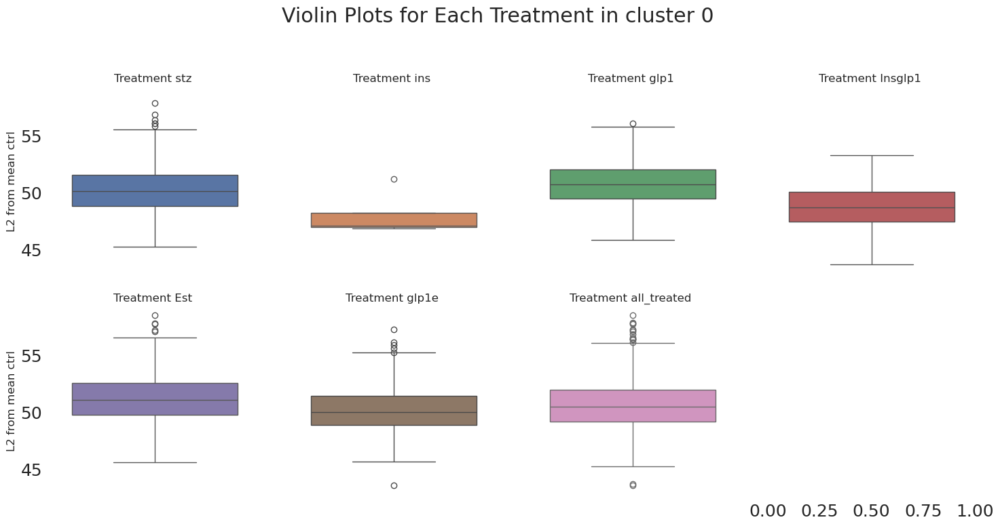

0 stz
1 ins
2 glp1
3 Insglp1
4 Est
5 glp1e
6 all_treated


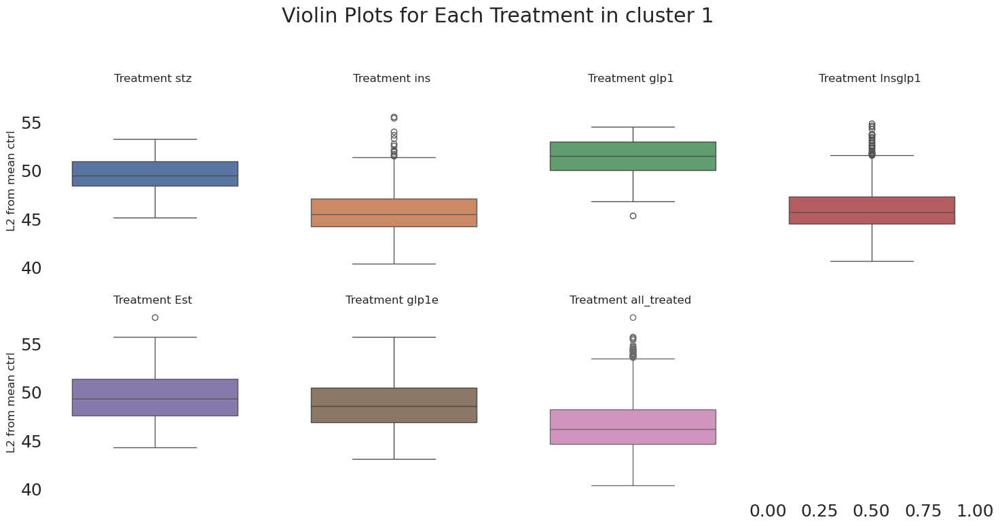

0 stz
1 ins
2 glp1
3 Insglp1
4 Est
5 glp1e
6 all_treated


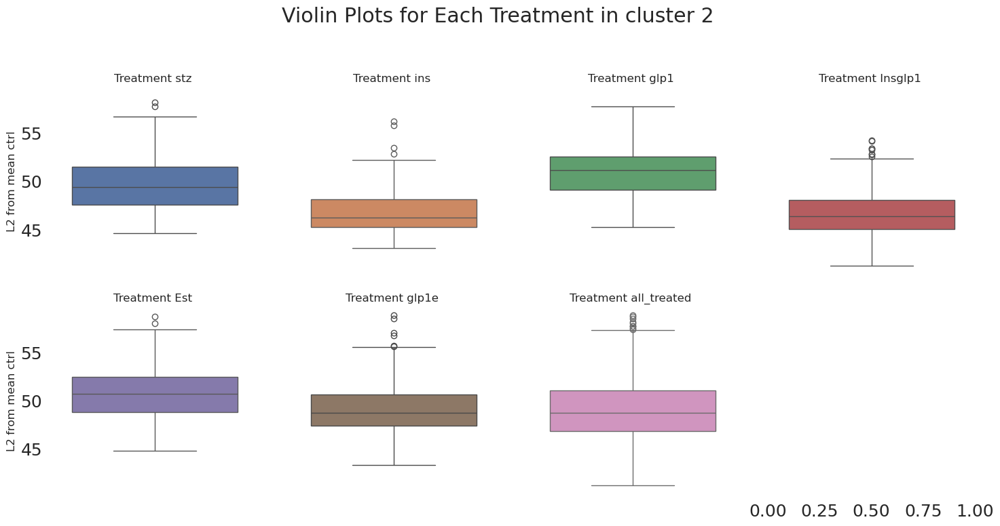

/tmp/ipykernel_48085/824016104.py:60: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['seak','mid','healthy like','ctrl'])


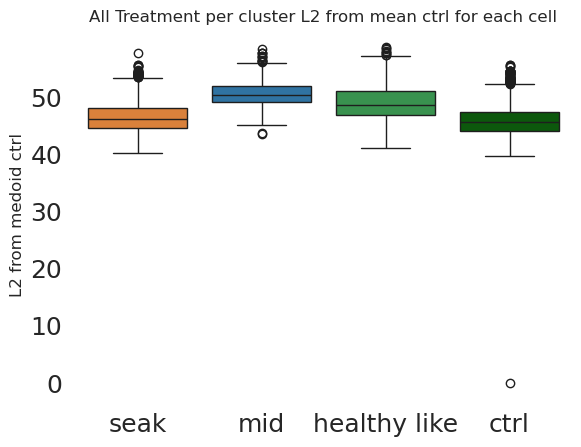

/tmp/ipykernel_48085/824016104.py:69: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['seak','mid','healthy like','ctrl'])


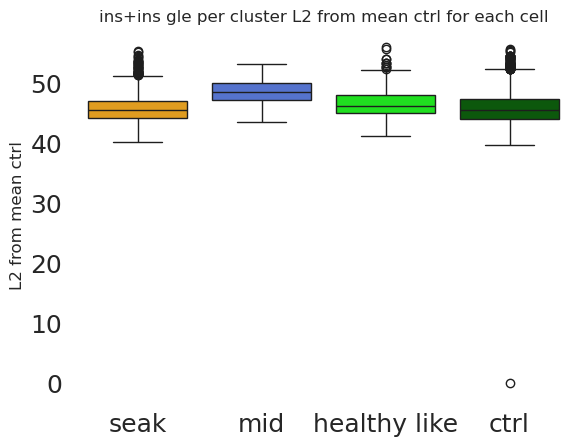

In [840]:

all_treated_per_cluster = []
all_treated_per_cluster_ins = []
ctrl_mean = np.mean(adata_beta_ctrl.X.toarray(), axis=0)
ctrl_mean = adata_beta_ctrl.X.toarray()[medoid_idx]
for cluster in ['0','1','2']:
    temp = adata_beta_stz_for_graph[adata_beta_stz_for_graph.obs["louvain"].isin([cluster])].copy()
    adata_beta_only_stz_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_STZ'])]
    adata_beta_only_ins_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_Ins'])]
    adata_beta_only_glp1_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_GLP1'])]
    adata_beta_only_Insglp1_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_InsGLP1'])]
    adata_beta_only_Est_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_Est'])]
    adata_beta_only_glp1e_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_GLP1E'])]

    adata_beta_all_ins = temp[temp.obs['groups_named_broad_cond'].isin(['beta_Ins','beta_InsGLP1'])]

    adata_beta_only_all_treated_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]
    test_stz = np.linalg.norm(adata_beta_only_stz_temp.X.toarray() - ctrl_mean, axis=1)
    #
    test_ins = np.linalg.norm(adata_beta_only_ins_temp.X.toarray() - ctrl_mean, axis=1)
    test_glp1 = np.linalg.norm(adata_beta_only_glp1_temp.X.toarray() - ctrl_mean, axis=1)
    test_Insglp1 = np.linalg.norm(adata_beta_only_Insglp1_temp.X.toarray() - ctrl_mean, axis=1)
    test_Est = np.linalg.norm(adata_beta_only_Est_temp.X.toarray() - ctrl_mean, axis=1)
    test_glp1e = np.linalg.norm(adata_beta_only_glp1e_temp.X.toarray() - ctrl_mean, axis=1)
    test_all_treated = np.linalg.norm(adata_beta_only_all_treated_temp.X.toarray() - ctrl_mean, axis=1)
    all_treated_per_cluster.append(test_all_treated)
    arrays = [test_stz,test_ins,test_glp1,test_Insglp1,test_Est,test_glp1e,test_all_treated]
    all_ins_temp = np.linalg.norm(adata_beta_all_ins.X.toarray() - ctrl_mean, axis=1)
    all_treated_per_cluster_ins.append(all_ins_temp)
    names = ['stz', 'ins', 'glp1', 'Insglp1', 'Est', 'glp1e', 'all_treated']

    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(15, 8), sharey=True)
    fig.suptitle(f'Violin Plots for Each Treatment in cluster {cluster}')


    colors =['orange','blue','lime','darkgreen']
    for i, (array, ax) in enumerate(zip(arrays, axes.flatten()), 0):
        print(i,names[i])


        sns.boxplot(y=array, ax=ax, color=f'C{i}')

        ax.set_title(f'Treatment {names[i]} ')
        ax.set_ylabel('L2 from mean ctrl')

    plt.tight_layout(rect=[0, 0, 1, 0.96])

    plt.show()

colors_dict = {
    'green': '#2AA148',
    'blue': '#1D77B5',
    'orange': '#F57E20'
}
# costum_colors = [colors_dict['orange'],colors_dict['blue'],colors_dict['green']]
costum_colors = [colors_dict['orange'],colors_dict['blue'],colors_dict['green'],'darkgreen']
test_ctrl = np.linalg.norm(adata_beta_ctrl.X.toarray() - ctrl_mean, axis=1)
to_plot = [all_treated_per_cluster[1],all_treated_per_cluster[0],all_treated_per_cluster[2],test_ctrl]
ax = sns.boxplot(data=to_plot,palette=costum_colors)
ax.set_title('All Treatment per cluster L2 from mean ctrl for each cell')
ax.set_xticklabels(['seak','mid','healthy like','ctrl'])
ax.set_ylabel('L2 from medoid ctrl')
plt.yticks([0,10,20,30, 40, 50])
plt.savefig('temp.png', dpi=600, bbox_inches='tight')
# plt.savefig('figures/e_v4.svg', format='svg', dpi=600)
plt.show()
to_plot =[all_treated_per_cluster_ins[1],all_treated_per_cluster_ins[0],all_treated_per_cluster_ins[2],test_ctrl]
ax = sns.boxplot(data=to_plot,palette=['orange','royalblue','lime','darkgreen'])
ax.set_title('ins+ins gle per cluster L2 from mean ctrl for each cell')
ax.set_xticklabels(['seak','mid','healthy like','ctrl'])
ax.set_ylabel('L2 from mean ctrl')

#save fig

plt.show()


/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


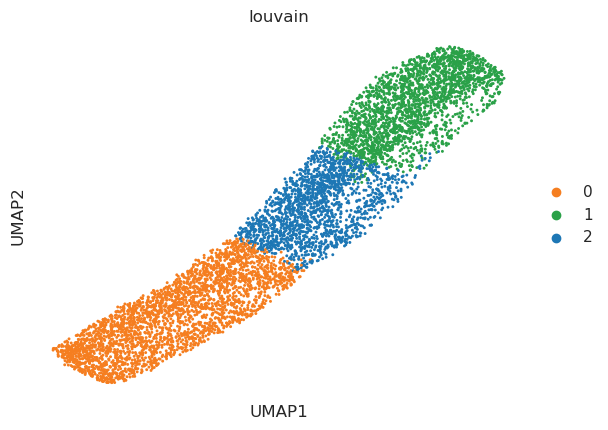

/tmp/ipykernel_48085/2301653620.py:3: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
/tmp/ipykernel_48085/2301653620.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
/tmp/ipykernel_48085/2301653620.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `s

12414
['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2', 'Slc30a8', 'Ucn3', 'Aldh1a3', 'Serpina7', 'Gcg', 'Sst', 'Pyy']


/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


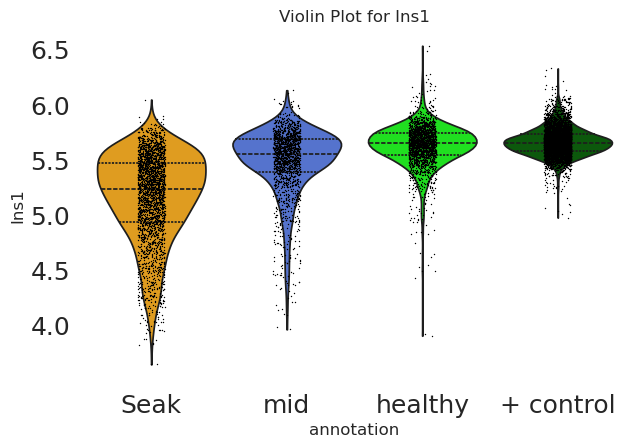

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


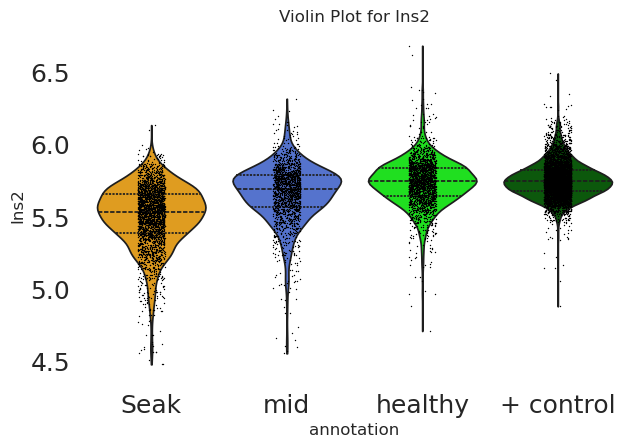

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


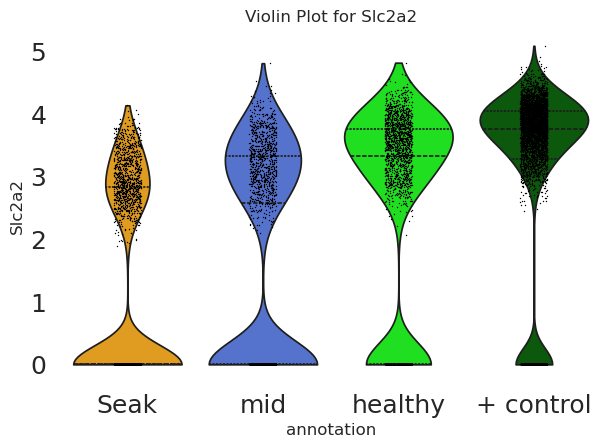

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


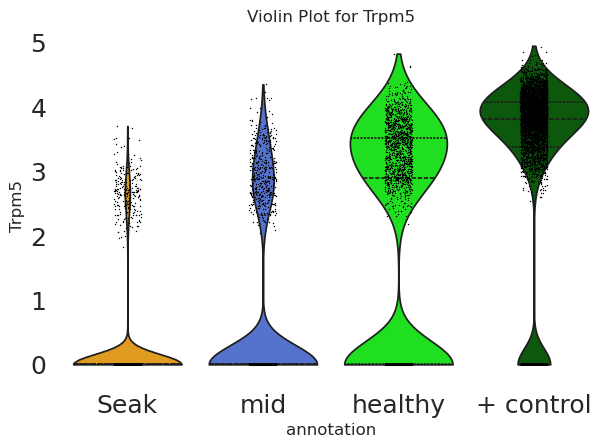

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


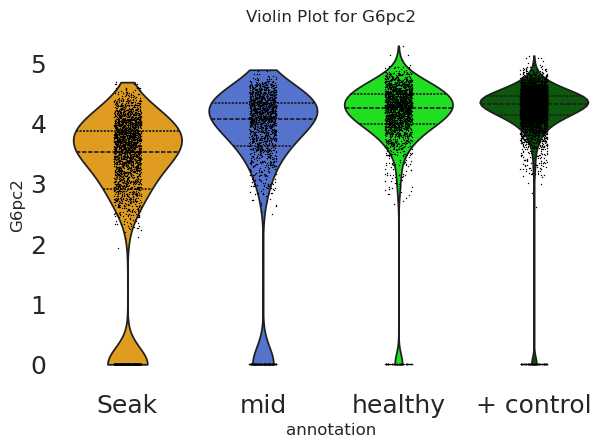

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


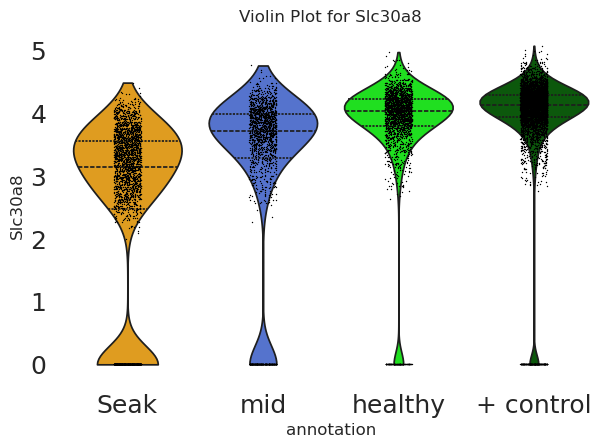

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


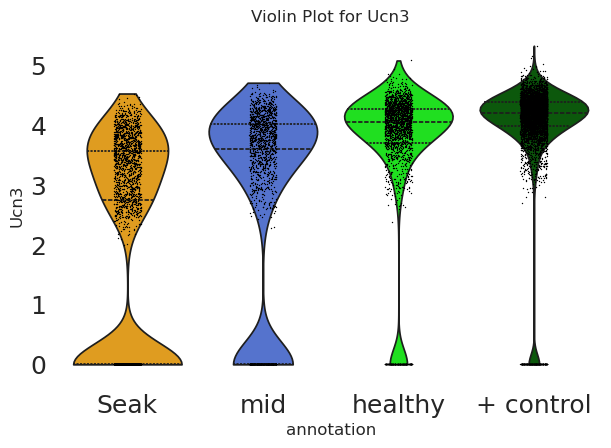

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


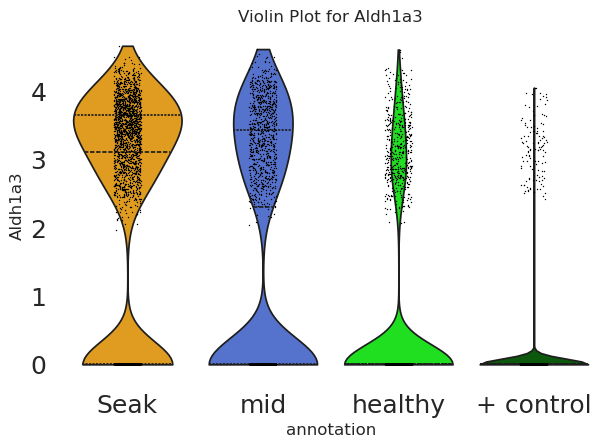

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


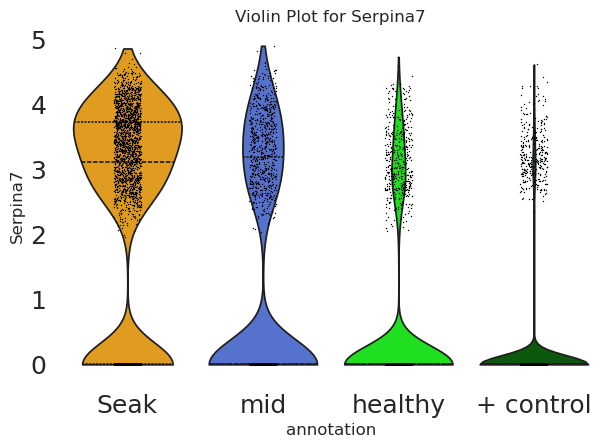

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


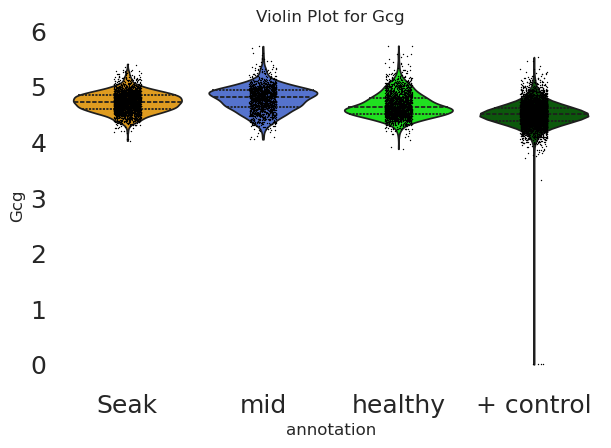

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


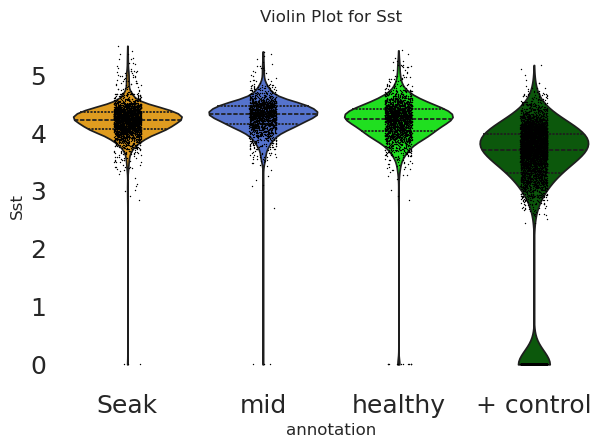

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


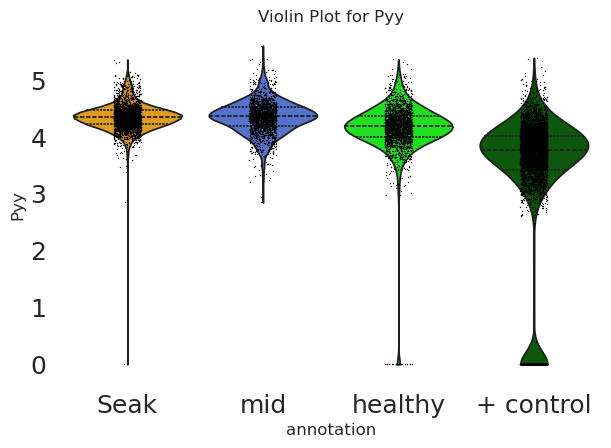

In [854]:
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()
sc.pl.umap(temp_adata_beta_stz_for_graph_scaled_with_ctrl,color=['louvain'])
temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
corr_classified_list = []
for i in range(temp.n_obs):
    if temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
        corr_classified_list.append('+ control')
    elif temp.obs['louvain'][i]=='0':
        corr_classified_list.append("Seak")
    elif temp.obs['louvain'][i]=='2':
        corr_classified_list.append("mid")
    elif temp.obs['louvain'][i]=='1':
        corr_classified_list.append("healthy")
    else:
        print(temp.obs['louvain'][i])
print(len(corr_classified_list))
temp.obs['annotation']=corr_classified_list

genes = sum(list(beta_cells_genes_dict.values()), [])+['Gcg','Sst','Pyy']
print(genes)

for gene in genes:
    sc.pl.violin(temp, gene, groupby='annotation', cmap='BrBG', show=False, order=['Seak','mid','healthy','+ control'],palette = ['orange','royalblue','lime','darkgreen'],inner='quartile')
    plt.title(f'Violin Plot for {gene}')
    plt.savefig(f'figures/violin_plot_{gene}_e_f.png',dpi=900)
    # plt.savefig(f'figures/c_v3_sup.png',dpi=600)







    plt.show()





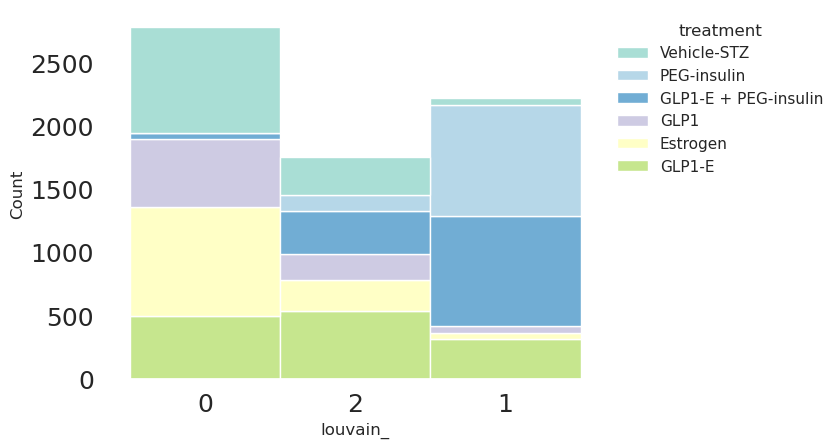

/tmp/ipykernel_48085/4068768685.py:57: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  result_df = df.groupby(['louvain_', 'treatment']).size().unstack(fill_value=0)


treatment  Estrogen  GLP1  GLP1-E  GLP1-E + PEG-insulin  PEG-insulin  \
louvain_                                                               
0               861   541     497                    42            4   
2               244   205     535                   346          121   
1                50    52     316                   868          878   

treatment  Vehicle-STZ  
louvain_                
0                  835  
2                  301  
1                   54  
Louvain Cluster 0:
  Estrogen: 30.97%
  GLP1: 19.46%
  GLP1-E: 17.88%
  GLP1-E + PEG-insulin: 1.51%
  PEG-insulin: 0.14%
  Vehicle-STZ: 30.04%
Louvain Cluster 2:
  Estrogen: 13.93%
  GLP1: 11.70%
  GLP1-E: 30.54%
  GLP1-E + PEG-insulin: 19.75%
  PEG-insulin: 6.91%
  Vehicle-STZ: 17.18%
Louvain Cluster 1:
  Estrogen: 2.25%
  GLP1: 2.34%
  GLP1-E: 14.25%
  GLP1-E + PEG-insulin: 39.13%
  PEG-insulin: 39.59%
  Vehicle-STZ: 2.43%


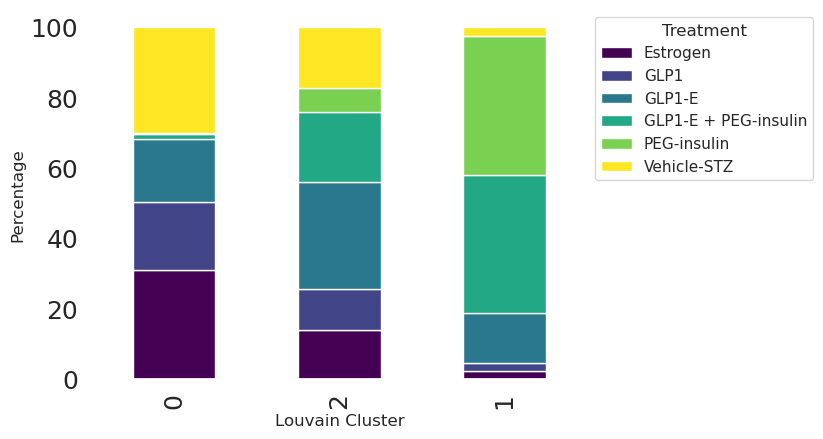

/tmp/ipykernel_48085/4068768685.py:81: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  result_df = df.groupby(['louvain_', 'treatment']).size().unstack(fill_value=0)


treatment  Estrogen  GLP1  GLP1-E  GLP1-E + PEG-insulin  PEG-insulin  \
louvain_                                                               
0               861   541     497                    42            4   
2               244   205     535                   346          121   
1                50    52     316                   868          878   

treatment  Vehicle-STZ  
louvain_                
0                  835  
2                  301  
1                   54  
treatment  Estrogen  GLP1  GLP1-E  GLP1-E + PEG-insulin  PEG-insulin  \
louvain_                                                               
0               861   541     497                    42            4   
2               244   205     535                   346          121   
1                50    52     316                   868          878   

treatment  Vehicle-STZ  
louvain_                
0                  835  
2                  301  
1                   54  
treatment   Estrogen       G

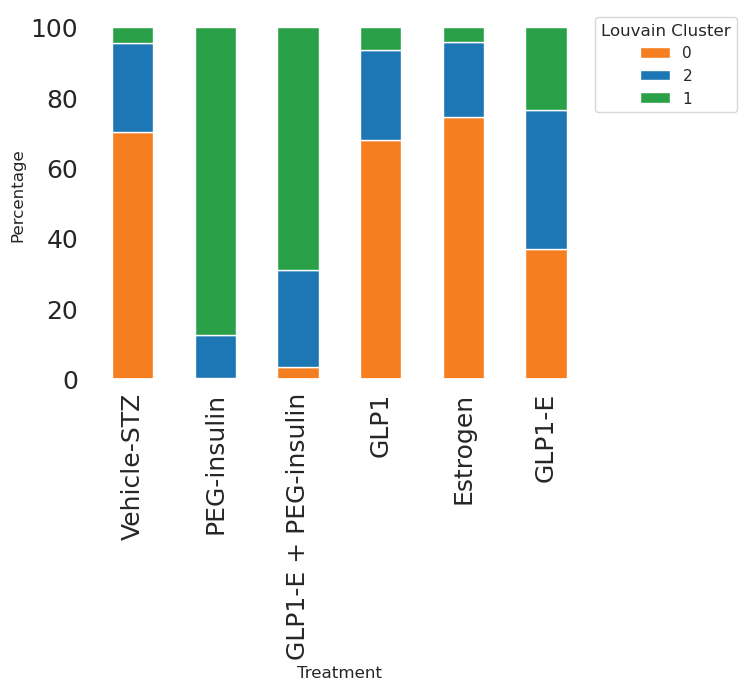

In [852]:
adata_beta_stz_for_graph_scaled_temp = adata_beta_stz_for_graph_scaled.copy()
df = adata_beta_stz_for_graph_scaled_temp.obs
df["louvain_"] =  pd.Categorical(df['louvain'], ['0','2','1'])

color_dict = {
    "color1": "#8dd3c7",
    "color2": "#ffffb3",
    "color3": "#bebada",
    "color4": "#fb8072",
    "color5": "#80b1d3",
    "color6": "#fdb462",
    "color7": "#b3de69",
    "color8": "#fccde5",
    "color9": "#4292c6",
    "color10": "#9ecae1"
}
hue_order = ['Vehicle-STZ', 'PEG-insulin', 'GLP1-E + PEG-insulin','GLP1',
                       'Estrogen','GLP1-E']
#
# ax = sns.histplot(data=df, x="louvain_", hue="treatment", multiple="stack",palette=[color_dict["color1"],color_dict["color2"],color_dict["color3"],color_dict["color4"],color_dict["color6"],color_dict["color7"]],bins=20)
# sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.show()

ax = sns.histplot(data=df, x="louvain_", hue="treatment", multiple="stack",palette=[color_dict["color1"],color_dict["color10"],color_dict["color9"],color_dict["color3"],color_dict["color2"],color_dict["color7"]],hue_order=hue_order)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
# plt.legend(frameon=False)
leg = ax.get_legend()
leg.set_frame_on(False)
plt.savefig('figures/g_v3.png', dpi=600, bbox_inches='tight')
plt.savefig('figures/g_v3.svg', format='svg', dpi=600)
plt.show()

# # df["louvain_"] =  pd.Categorical(df['louvain'], ['1','0','2'])
# # hue_order = ['beta_STZ','beta_Ins','beta_InsGLP1','beta_GLP1','beta_Est','beta_GLP1E']
# hue_order = ['Vehicle-STZ', 'PEG-insulin', 'GLP1-E + PEG-insulin','GLP1',
#                        'Estrogen','GLP1-E']
# ax = sns.histplot(data=df, x="louvain", hue="treatment", multiple="stack",palette=[color_dict["color1"],color_dict["color2"],color_dict["color3"],color_dict["color9"],color_dict["color10"],color_dict["color7"]],hue_order=hue_order)
# sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
# # plt.legend(frameon=False)
# leg = ax.get_legend()
# leg.set_frame_on(False)
# plt.savefig('figures/g_v4.png', dpi=600, bbox_inches='tight')
# plt.savefig('figures/g_v4.svg', format='svg', dpi=600)
# plt.show()





# plt.savefig('figures/k.png', dpi=600, bbox_inches='tight')
# sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
# count_nmber
# ax = sns.barplot(data=adata_beta_stz_for_graph_scaled.obs, x="louvain", y="conf", hue="treatment",order=["1","0", "2"])
# Calculate and display the fractions as text annotations
# Calculate the fraction of each treatment in each louvain cluster
# Calculate the fraction of each treatment in each louvain cluster
result_df = df.groupby(['louvain_', 'treatment']).size().unstack(fill_value=0)
print(result_df)
result_df = result_df.div(result_df.sum(axis=1), axis=0) * 100

# Plot the fractions as a bar plot
ax = result_df.plot(kind='bar', stacked=True, colormap='viridis', edgecolor='white')

# Add legend and labels
ax.legend(title='Treatment', bbox_to_anchor=(1, 1))
ax.set_xlabel('Louvain Cluster')
ax.set_ylabel('Percentage')

# Print the percentages for each treatment and each louvain cluster
for index, row in result_df.iterrows():
    print(f"Louvain Cluster {index}:")
    for treatment, percentage in row.items():
        print(f"  {treatment}: {percentage:.2f}%")

# Show the plot

plt.show()


# Calculate the fraction of each treatment in each louvain cluster
result_df = df.groupby(['louvain_', 'treatment']).size().unstack(fill_value=0)
# result_df = df.groupby(['louvain', 'treatment']).size().unstack(fill_value=0)
print(result_df)
print(result_df)
result_df = result_df.div(result_df.sum(axis=0), axis=1) * 100
print(result_df)

# # Normalize percentages within each treatment group to sum to 100
# result_df = result_df.div(result_df.sum(axis=0), axis=1) * 100
# print(result_df)
#
#change the order of the columns
result_df = result_df[['Vehicle-STZ', 'PEG-insulin', 'GLP1-E + PEG-insulin','GLP1',
                       'Estrogen','GLP1-E']]  # Replace with desired column order
#
# print(result_df)


# Set custom colors
# custom_colors = ['orange', 'lightblue', 'lightgreen']
# custom_colors = ['orange', 'royalblue','lime']
colors_dict = {
    'green': '#2AA148',
    'blue': '#1D77B5',
    'orange': '#F57E20'
}
costum_colors = [colors_dict['orange'],colors_dict['blue'],colors_dict['green']]
#make the fig bigger
# plt.figure(figsize=(20, 12))
# Plot the fractions as a bar plot with custom colors
ax = result_df.T.plot(kind='bar', stacked=True, color=costum_colors, edgecolor='white')

# Add legend and labels
ax.legend(title='Louvain Cluster', bbox_to_anchor=(1, 1))
ax.set_xlabel('Treatment')
ax.set_ylabel('Percentage')

# Print the percentages for each louvain cluster and each treatment
for column, values in result_df.items():
    print(f"Louvain Cluster {column}:")
    for treatment, percentage in values.items():
        print(f"  {treatment}: {percentage:.2f}%")
plt.savefig('figures/k_v2.png', dpi=600, bbox_inches='tight')
plt.savefig('figures/k_v2.svg', format='svg', dpi=600)
plt.show()
# print(result_df)

/tmp/ipykernel_48085/2644343905.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  result_df = df.groupby(['louvain_', 'treatment']).size().unstack(fill_value=0)


Louvain Cluster Estrogen:
  0: 32.38%
  2: 13.64%
  1: 2.29%
Louvain Cluster GLP1:
  0: 19.85%
  2: 12.35%
  1: 2.11%
Louvain Cluster GLP1-E:
  0: 17.10%
  2: 31.70%
  1: 13.70%
Louvain Cluster GLP1-E + PEG-insulin:
  0: 0.99%
  2: 17.20%
  1: 40.13%
Louvain Cluster PEG-insulin:
  0: 0.11%
  2: 5.55%
  1: 39.52%
Louvain Cluster Vehicle-STZ:
  0: 29.56%
  2: 19.57%
  1: 2.25%


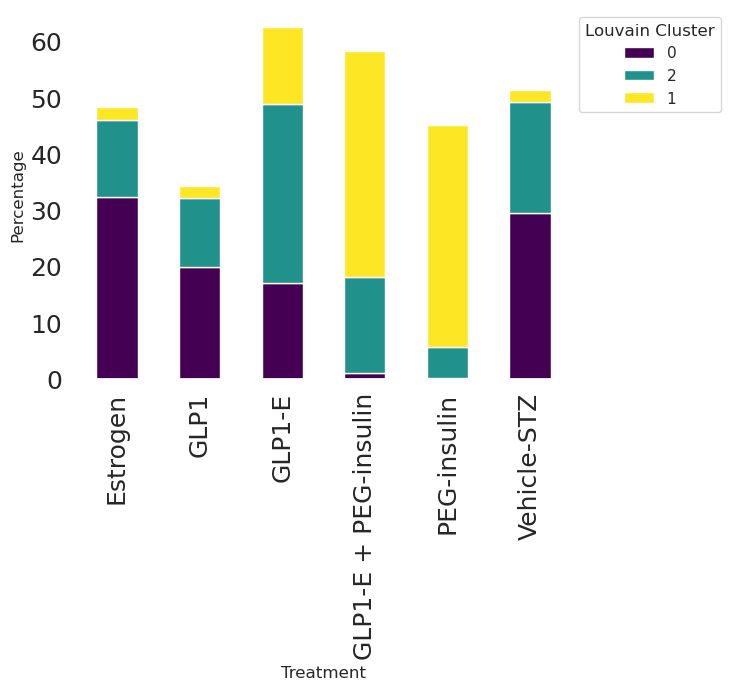

In [822]:
result_df = df.groupby(['louvain_', 'treatment']).size().unstack(fill_value=0)
result_df = result_df.div(result_df.sum(axis=1), axis=0) * 100

# Plot the fractions
# as a bar plot
ax = result_df.T.plot(kind='bar', stacked=True, colormap='viridis', edgecolor='white')

# Add legend and labels
ax.legend(title='Louvain Cluster', bbox_to_anchor=(1, 1))
ax.set_xlabel('Treatment')
ax.set_ylabel('Percentage')

# Print the percentages for each louvain cluster and each treatment
for column, values in result_df.items():
    print(f"Louvain Cluster {column}:")
    for treatment, percentage in values.items():
        print(f"  {treatment}: {percentage:.2f}%")

# Show the plot
plt.show()

treatment   Estrogen       GLP1     GLP1-E  GLP1-E + PEG-insulin  PEG-insulin  \
louvain_                                                                        
0          32.380952  19.847619  17.104762              0.990476     0.114286   
2          13.638814  12.345013  31.698113             17.196765     5.552561   
1           2.290749   2.114537  13.700441             40.132159    39.515419   

treatment  Vehicle-STZ  
louvain_                
0            29.561905  
2            19.568733  
1             2.246696  


/tmp/ipykernel_48085/1228959423.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  result_df = df.groupby(['louvain_', 'treatment']).size().unstack(fill_value=0)


Louvain Cluster Vehicle-STZ:
  0: 57.54%
  2: 38.09%
  1: 4.37%
Louvain Cluster PEG-insulin:
  0: 0.25%
  2: 12.29%
  1: 87.46%
Louvain Cluster GLP1-E + PEG-insulin:
  0: 1.70%
  2: 29.49%
  1: 68.81%
Louvain Cluster GLP1:
  0: 57.85%
  2: 35.98%
  1: 6.16%
Louvain Cluster Estrogen:
  0: 67.03%
  2: 28.23%
  1: 4.74%
Louvain Cluster GLP1-E:
  0: 27.37%
  2: 50.71%
  1: 21.92%


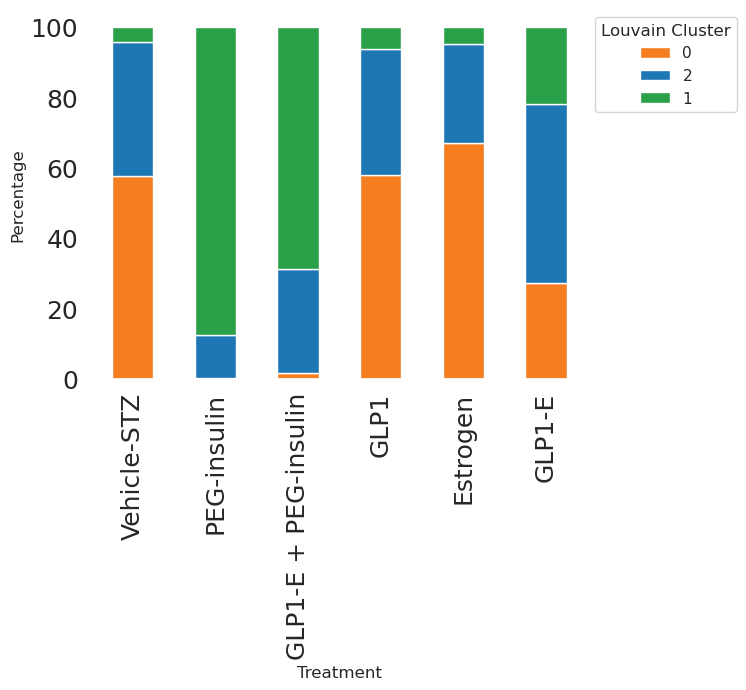

In [823]:
# Calculate the fraction of each treatment in each louvain cluster
result_df = df.groupby(['louvain_', 'treatment']).size().unstack(fill_value=0)
result_df = result_df.div(result_df.sum(axis=1), axis=0) * 100
print(result_df)
# Normalize percentages within each treatment group to sum to 100
result_df = result_df.div(result_df.sum(axis=0), axis=1) * 100

#change the order of the columns
result_df = result_df[['Vehicle-STZ', 'PEG-insulin', 'GLP1-E + PEG-insulin','GLP1',
                       'Estrogen','GLP1-E']]  # Replace with desired column order



# Set custom colors
# custom_colors = ['orange', 'lightblue', 'lightgreen']
# custom_colors = ['orange', 'royalblue','lime']
colors_dict = {
    'green': '#2AA148',
    'blue': '#1D77B5',
    'orange': '#F57E20'
}
costum_colors = [colors_dict['orange'],colors_dict['blue'],colors_dict['green']]
#make the fig bigger
# plt.figure(figsize=(20, 12))
# Plot the fractions as a bar plot with custom colors
ax = result_df.T.plot(kind='bar', stacked=True, color=costum_colors, edgecolor='white')

# Add legend and labels
ax.legend(title='Louvain Cluster', bbox_to_anchor=(1, 1))
ax.set_xlabel('Treatment')
ax.set_ylabel('Percentage')

# Print the percentages for each louvain cluster and each treatment
for column, values in result_df.items():
    print(f"Louvain Cluster {column}:")
    for treatment, percentage in values.items():
        print(f"  {treatment}: {percentage:.2f}%")

#save fig as svm file

# Show the plot
plt.show()

In [824]:
adata_beta_ctrl = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_Ctrl'])]


/tmp/ipykernel_48085/1489443853.py:52: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if adata_beta_stz_temp.obs['groups_named_broad_cond'][i]=='beta_Ins' or adata_beta_stz_temp.obs['groups_named_broad_cond'][i]=='beta_InsGLP1':


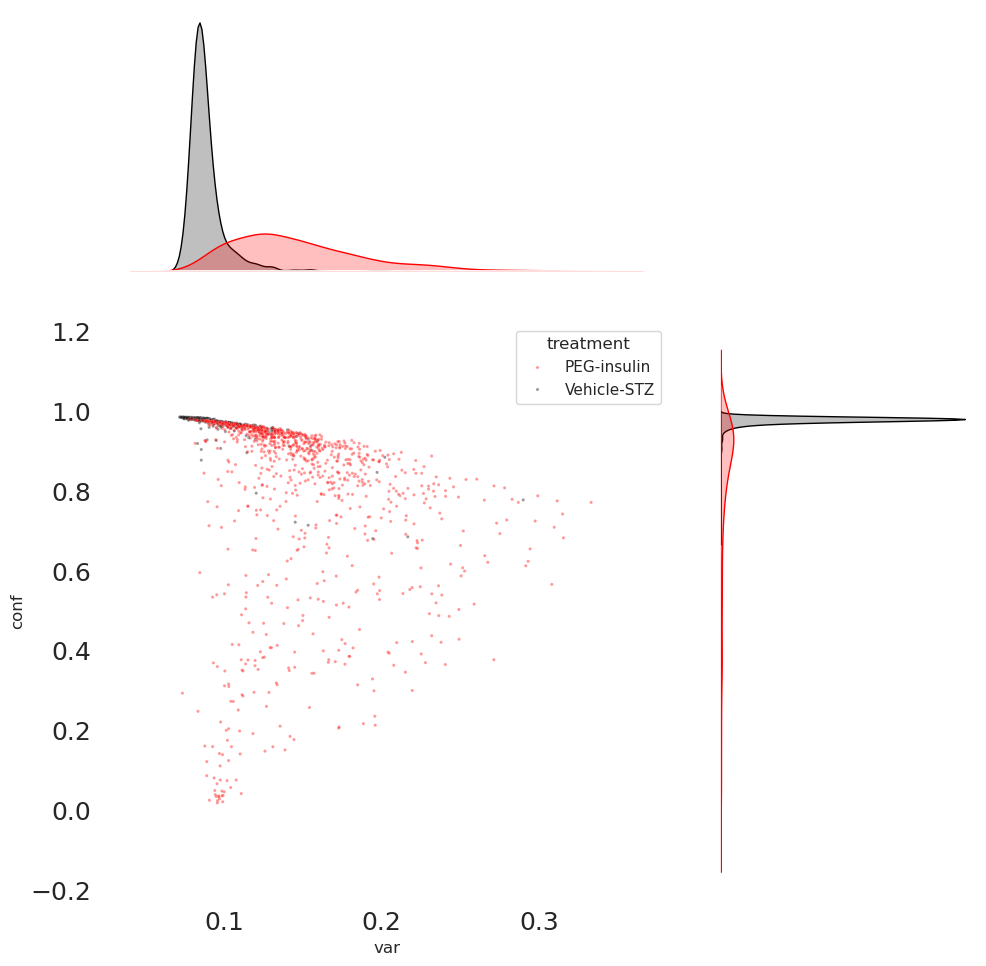

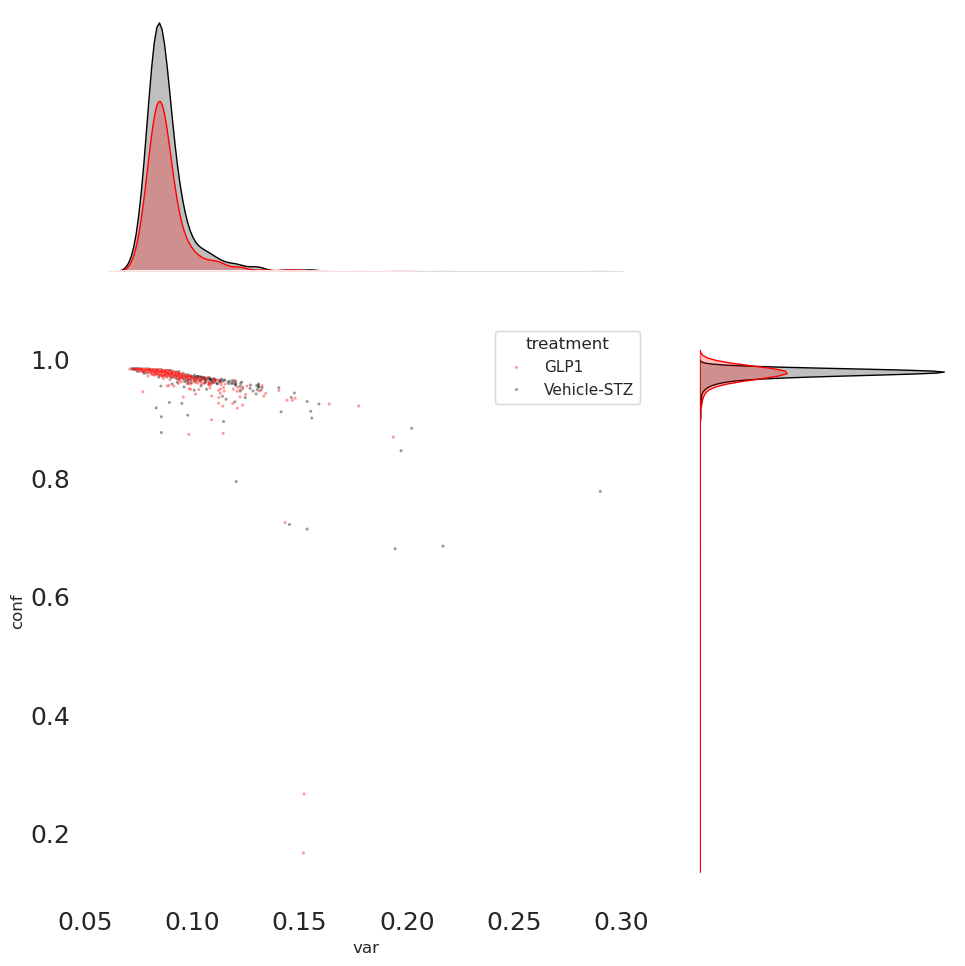

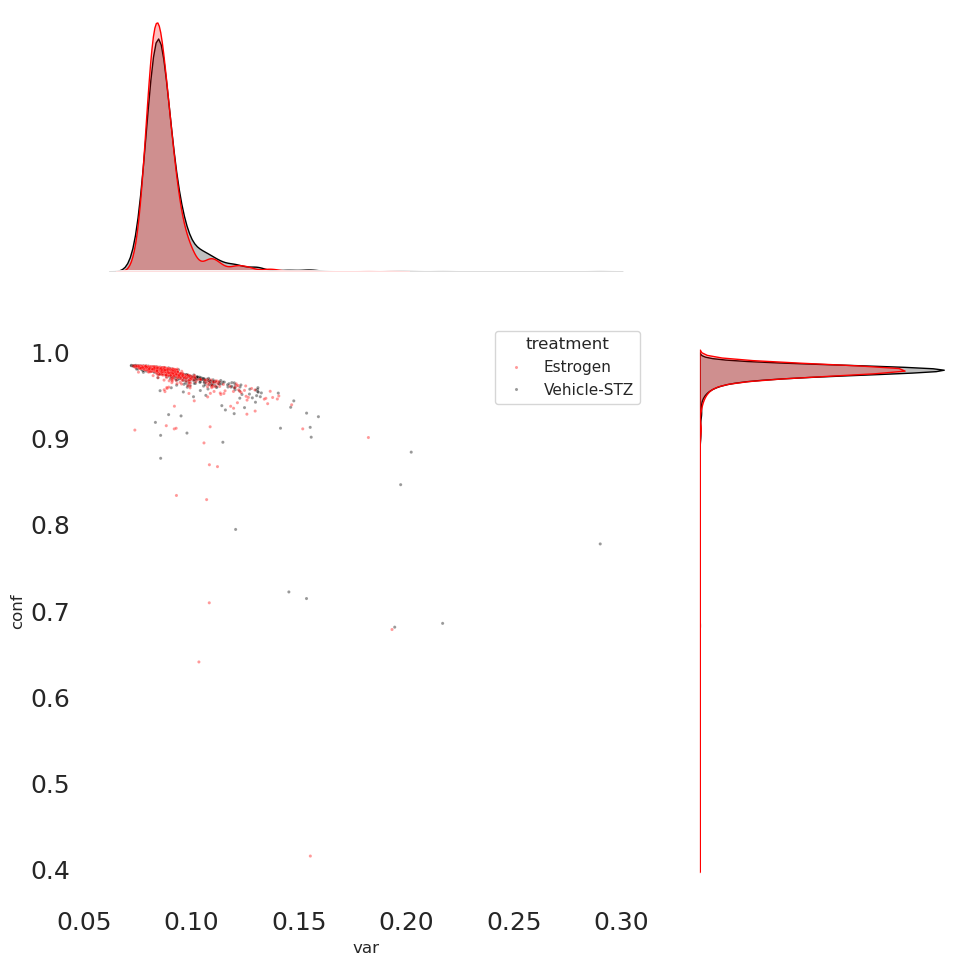

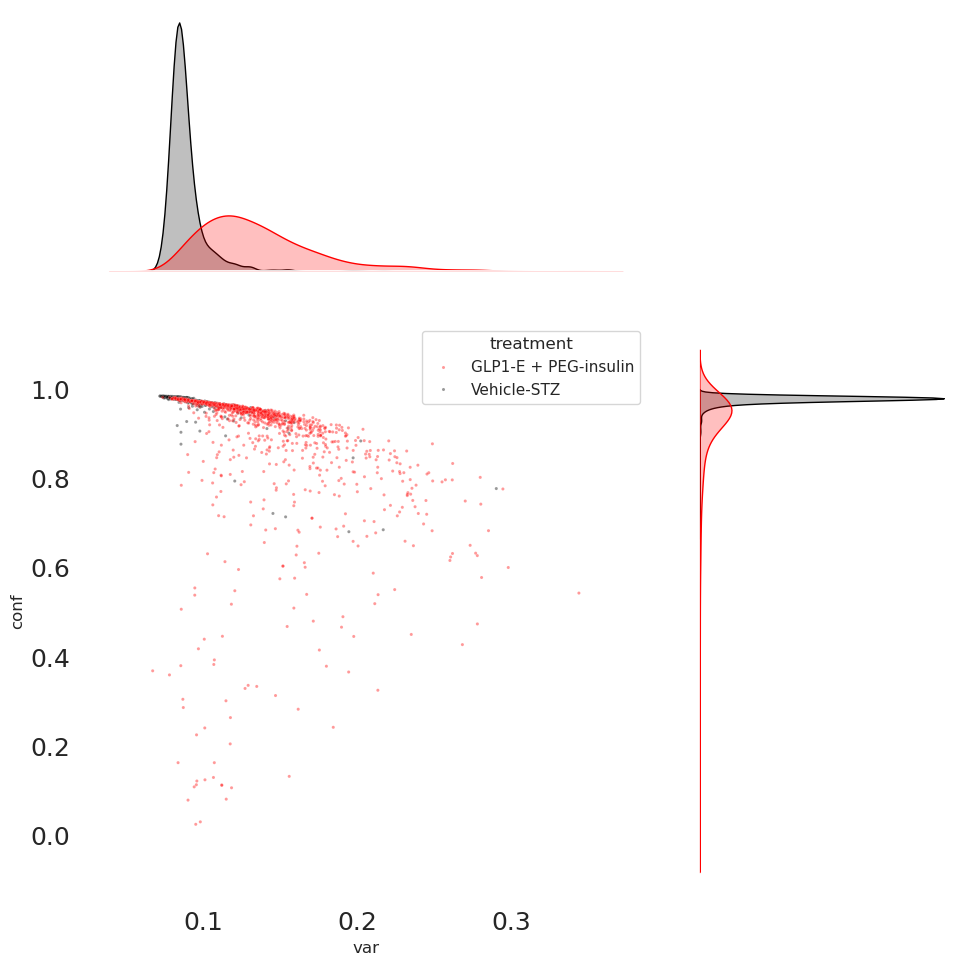

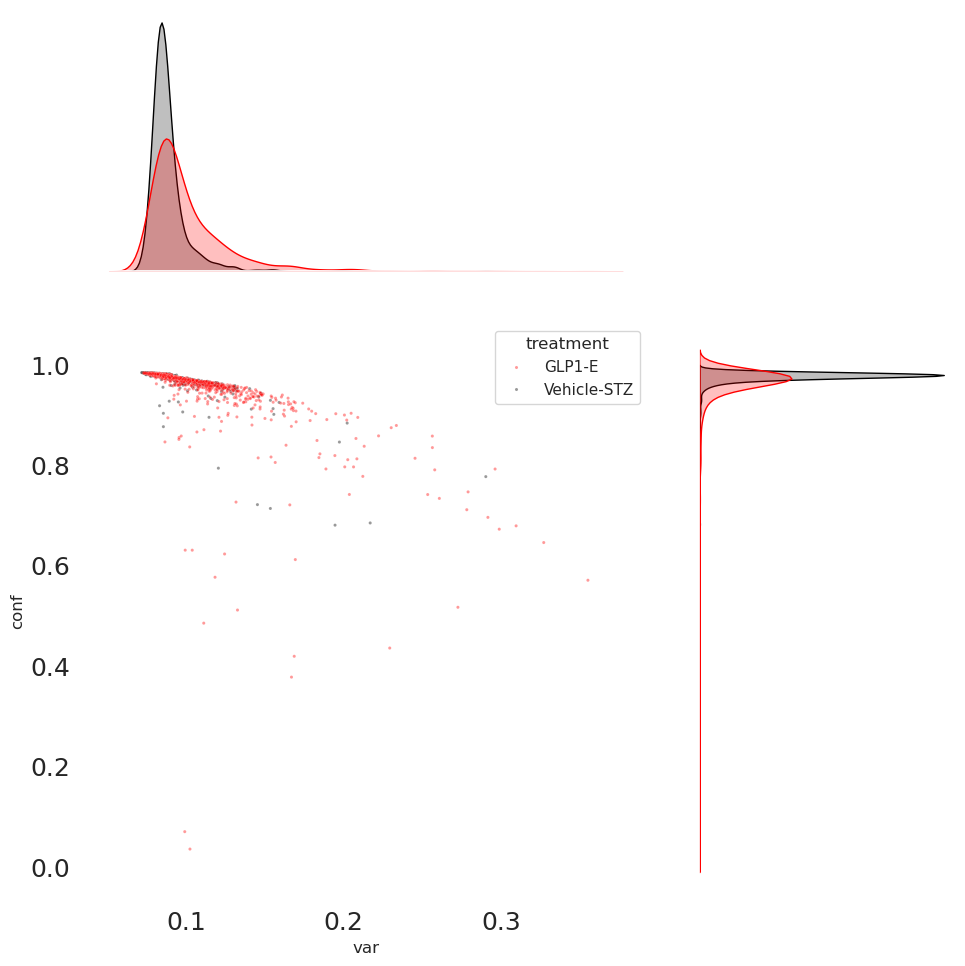

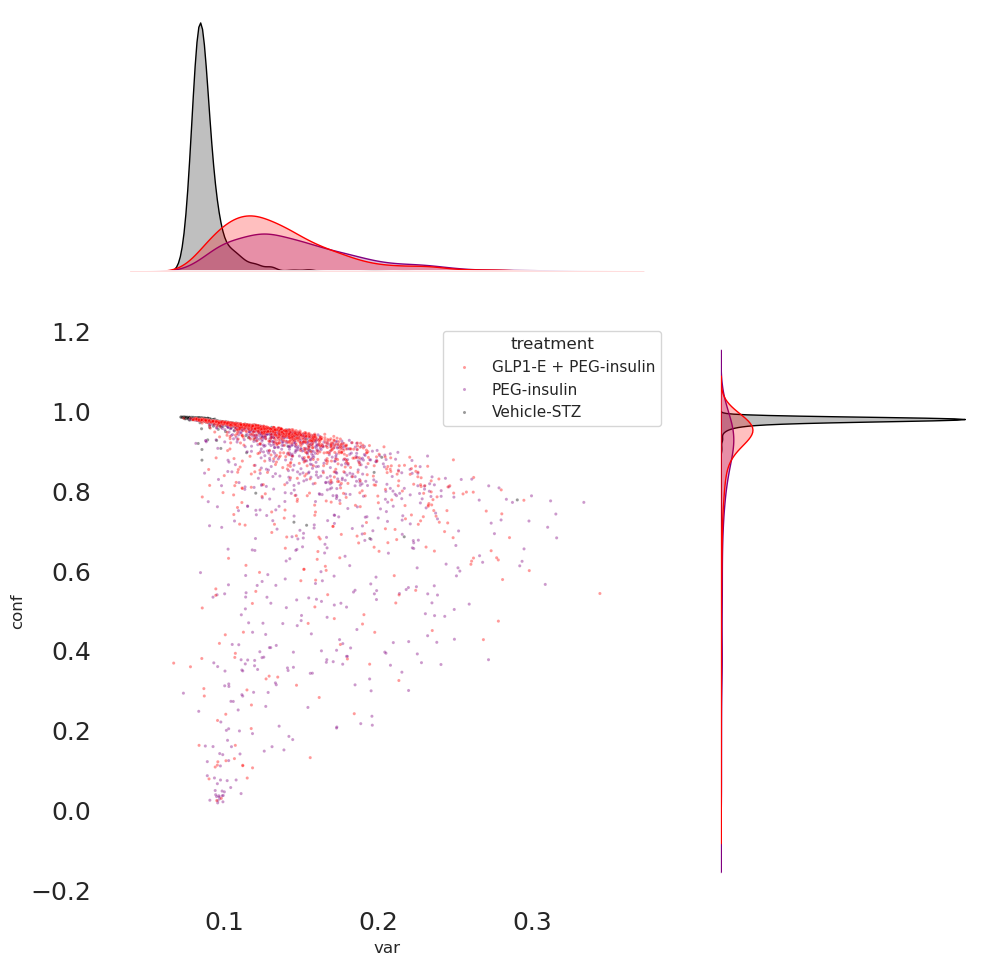

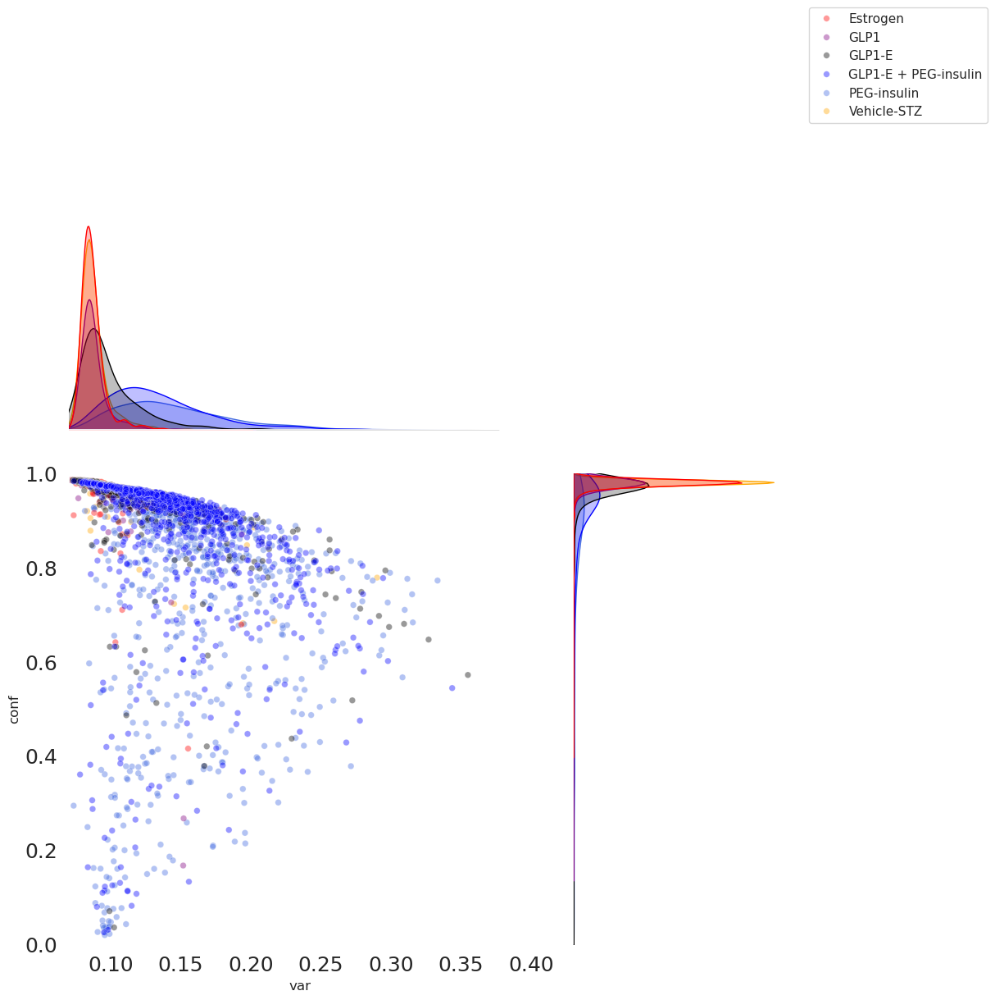

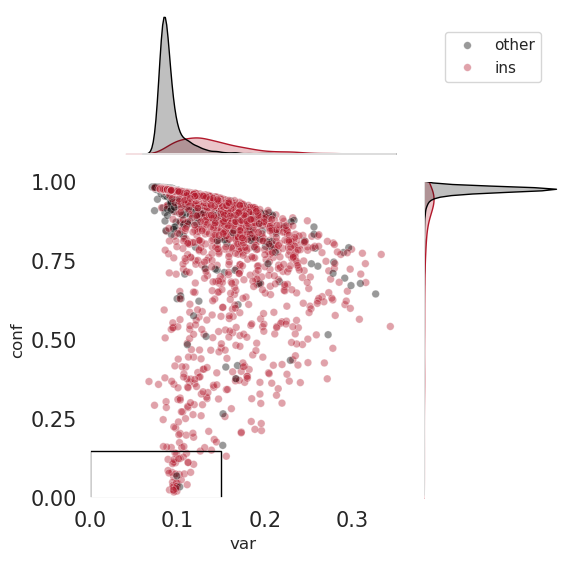

In [825]:
#adata_beta_stz_ins = adata_stz[adata_stz.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_GLP1','beta_Ins','beta_InsGLP1','beta_Est','beta_GLP1E'])]
# sns.set(style="whitegrid")  # Optional: Set the style of the plot
#
# # Adjust the figure size to fit a small panel
# plt.figure(figsize=(6, 4))

# Create the joint plot with specified parameters


adata_beta_stz_ins = adata_stz[adata_stz.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins'])]
adata_beta_stz_glp = adata_stz[adata_stz.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_GLP1'])]
adata_beta_stz_est = adata_stz[adata_stz.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Est'])]
adata_beta_stz_insglp = adata_stz[adata_stz.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_InsGLP1'])]
adata_beta_stz_glpe = adata_stz[adata_stz.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_GLP1E'])]


adata_beta_stz_ins_all = adata_stz[adata_stz.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_InsGLP1'])]

adata_beta_stz_all = adata_stz[adata_stz.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_InsGLP1','beta_GLP1','beta_Est','beta_GLP1E'])]

# ,palette=['orange','blue','lime','darkgreen']

sns.jointplot(data=adata_beta_stz_ins.obs, x="var", y="conf", hue='treatment',height=10, alpha=0.4, s=5, ratio=2,palette=['red','black'])
# plt.savefig(f'figures/i_ins.png',dpi=600)
sns.jointplot(data=adata_beta_stz_glp.obs, x="var", y="conf", hue='treatment',height=10, alpha=0.4, s=5, ratio=2,palette=['red','black'])
# plt.savefig(f'figures/i_glp.png',dpi=600)
sns.jointplot(data=adata_beta_stz_est.obs, x="var", y="conf", hue='treatment',height=10, alpha=0.4, s=5, ratio=2,palette=['red','black'])
# plt.savefig(f'figures/i_est.png',dpi=600)
sns.jointplot(data=adata_beta_stz_insglp.obs, x="var", y="conf", hue='treatment',height=10, alpha=0.4, s=5, ratio=2,palette=['red','black'])
# plt.savefig(f'figures/i_insglp.png',dpi=600)
sns.jointplot(data=adata_beta_stz_glpe.obs, x="var", y="conf", hue='treatment',height=10, alpha=0.4, s=5, ratio=2,palette=['red','black'])
# plt.savefig(f'figures/i_glpe.png',dpi=600)
sns.jointplot(data=adata_beta_stz_ins_all.obs, x="var", y="conf", hue='treatment',height=10, alpha=0.4, s=5, ratio=2,palette=['red','purple','black'])
# plt.savefig(f'figures/i_ins_all.png',dpi=600)

sns.jointplot(data=adata_beta_stz_all.obs, x="var", y="conf", hue='treatment',height=10, alpha=0.4, s=30, ratio=2,palette=['red','purple','black','blue','royalblue','orange'])
#move the legend
plt.legend(loc='upper right', bbox_to_anchor=(2, 2))
plt.ylim(0, 1)
plt.xlim(0.07, 0.4)



adata_beta_stz_temp = adata_stz[adata_stz.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])].copy()




corr_classified_list = []
# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
for i in range(adata_beta_stz_temp.n_obs):
    if adata_beta_stz_temp.obs['groups_named_broad_cond'][i]=='beta_Ins' or adata_beta_stz_temp.obs['groups_named_broad_cond'][i]=='beta_InsGLP1':
        corr_classified_list.append('ins')
    else:
        corr_classified_list.append('other')
adata_beta_stz_temp.obs['annotation']=corr_classified_list


# plt.figure(figsize=(5, 4))
joint_plot=sns.jointplot(data=adata_beta_stz_temp.obs, x="var", y="conf", hue='annotation',height=6, alpha=0.4, s=30, ratio=2,palette=['black','#b2182b'])
#move the legend
plt.legend(loc='upper right', bbox_to_anchor=(1.5, 1.5))
plt.ylim(0, 1)
plt.xlim(0.00, 0.35)
#show less ticks
# joint_plot.ax_joint.xaxis.set_major_locator(plt.MaxNLocator(5))
# joint_plot.ax_joint.yaxis.set_major_locator(plt.MaxNLocator(5))

plt.xticks(ticks=[0, 0.1, 0.2,0.3])
plt.yticks(ticks=[0, 0.25, 0.5,0.75,1])
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
# Create a rectangle patch
import matplotlib.patches as patches
rect = patches.Rectangle((0, 0), 0.15, 0.15, linewidth=1, edgecolor='black', facecolor='none')

# Add the rectangle patch to the axis
joint_plot.ax_joint.add_patch(rect)

# Show the plot
plt.savefig('figures/i_v3.png', dpi=600, bbox_inches='tight')
plt.savefig('figures/i_v3.svg', format='svg', dpi=600)

# Set the style to white background
# sns.set_style("white")



# # Create the joint plot with specified parameters
# sns.jointplot(
#     data=adata_beta_stz_temp.obs,
#     x="var",
#     y="conf",
#     hue='annotation',
#     height=6,  # Adjust the height to fit the small panel
#     alpha=0.4,
#     s=10,
#     ratio=2,
#     palette=['black', '#b2182b']
# )
#
# # Adjust the x and y tick parameters for larger ticks
# plt.xticks(fontsize=10)
# plt.yticks(fontsize=10)
#
# # Show the plot
# # plt.savefig('figures/i_v3.png', dpi=600, bbox_inches='tight')
plt.show()


/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


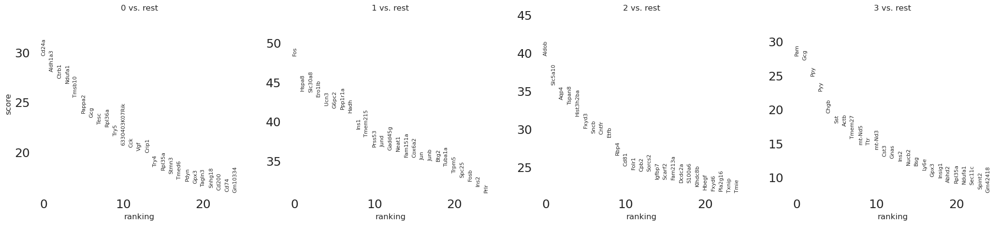

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


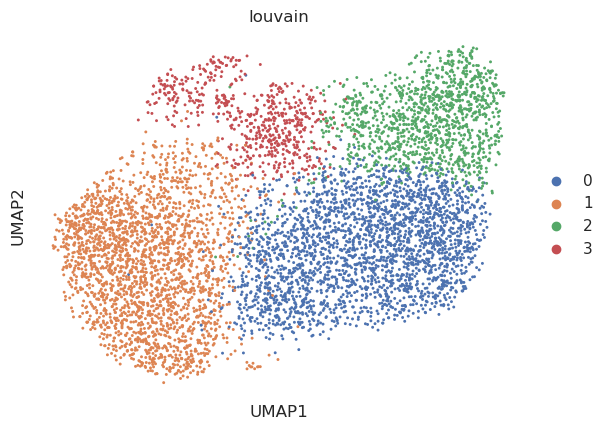

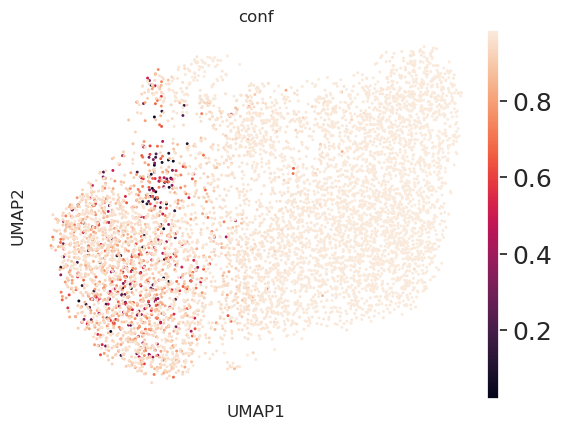

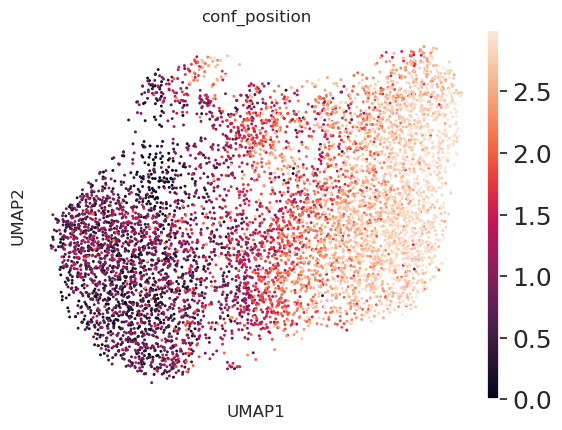

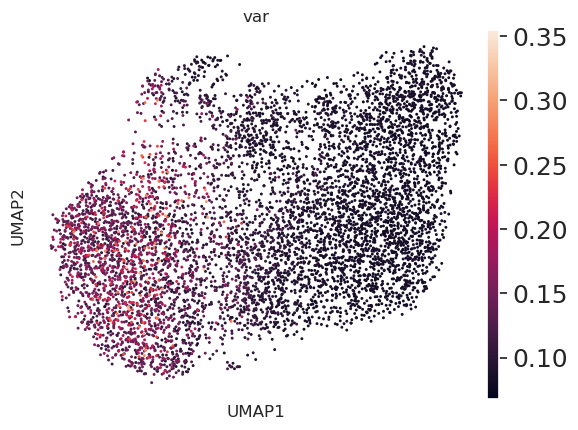

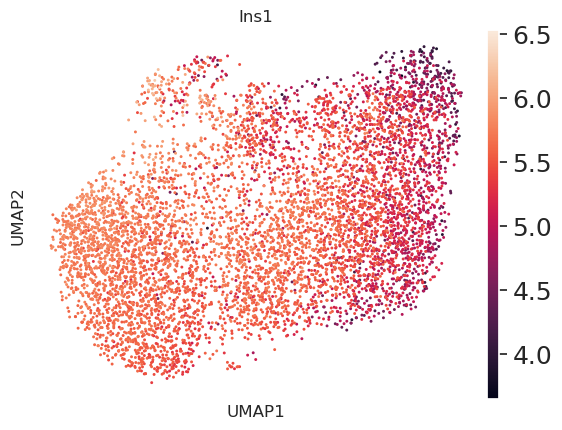

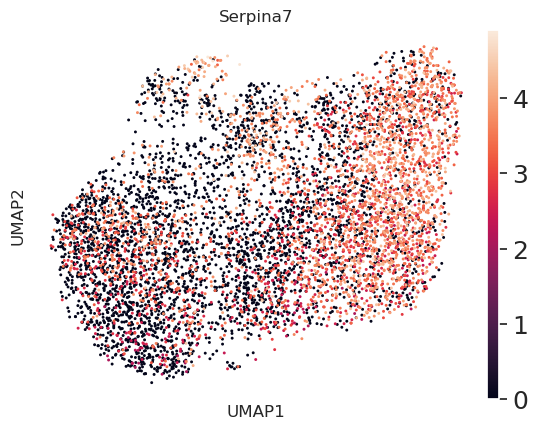

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


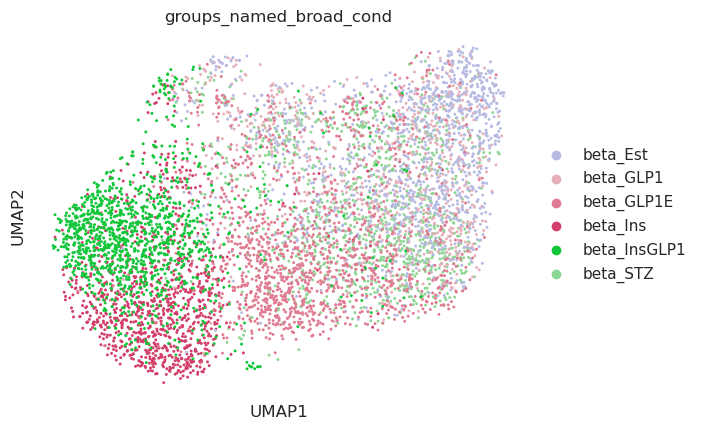

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


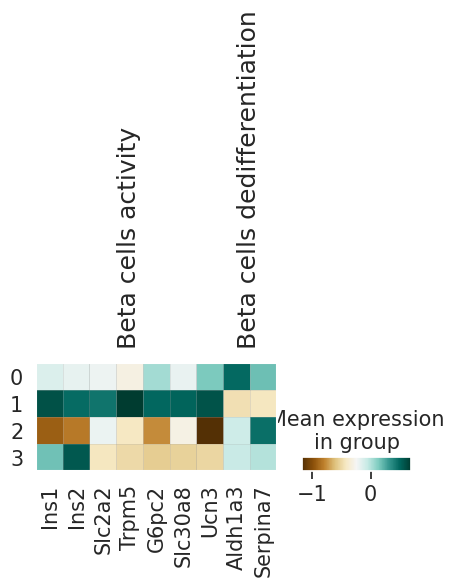

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


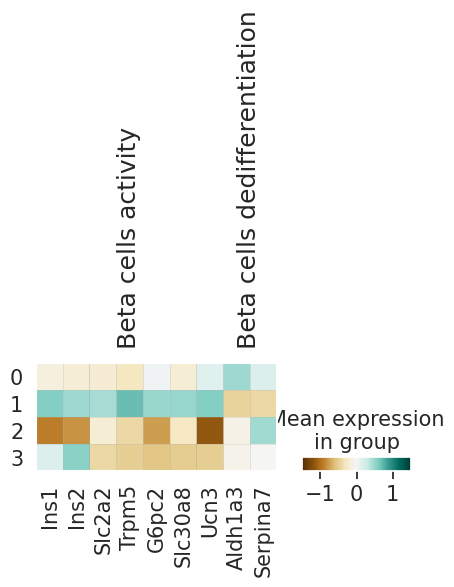

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


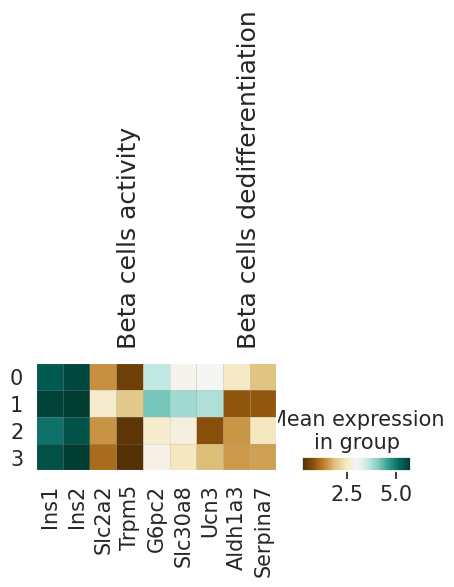

sanc py
0
0.57829165
j Ucn3
0
0.12502685
j G6pc2
0
-0.0942139
j Ins2
0
-0.12379528
j Ins1
0
-0.9794738
j Slc2a2
0
-1.9130737
j Trpm5
0
-0.64466095
j Slc30a8
$$$$$$
Mean of embedded graph logfold change: -0.4359856
1
1.5814868
j Slc30a8
1
2.331486
j Ucn3
1
1.4235044
j G6pc2
1
0.49397862
j Ins1
1
3.580039
j Trpm5
1
0.23514697
j Ins2
1
1.902759
j Slc2a2
$$$$$$
Mean of embedded graph logfold change: 1.6497715
2
-0.7163194
j Slc2a2
2
-2.3586333
j Trpm5
2
-0.7688329
j Slc30a8
2
-0.31958774
j Ins2
2
-1.7985398
j G6pc2
2
-0.6201625
j Ins1
2
-4.354365
j Ucn3
$$$$$$
Mean of embedded graph logfold change: -1.5623486
0
2.3545623
j Aldh1a3
0
0.8767152
j Serpina7
$$$$$$
Mean of embedded graph logfold change: 1.6156387
1
-2.2171283
j Serpina7
1
-2.3817997
j Aldh1a3
$$$$$$
Mean of embedded graph logfold change: -2.299464
2
1.6652158
j Serpina7
2
-0.323991
j Aldh1a3
$$$$$$
Mean of embedded graph logfold change: 0.67061245


In [826]:
# naive scanpy gragh  
temp_naive = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])].copy()
sc.pp.pca(temp_naive)
sc.pp.neighbors(temp_naive)
sc.tl.umap(temp_naive)
# temp_naive = adata_beta_stz_for_graph.copy()
sc.tl.louvain(temp_naive, resolution=0.3)
sc.tl.rank_genes_groups(temp_naive, 'louvain' ,method='wilcoxon')
sc.pl.rank_genes_groups(temp_naive, n_genes=25, sharey=False)
sc.pl.umap(temp_naive,color=['louvain'])
sc.pl.umap(temp_naive,color=['conf'])
sc.pl.umap(temp_naive,color=['conf_position'])
sc.pl.umap(temp_naive,color=['var'])
sc.pl.umap(temp_naive,color=['Ins1'])
sc.pl.umap(temp_naive,color=['Serpina7'])
sc.pl.umap(temp_naive,color=['groups_named_broad_cond'])
# adata_beta_stz_for_graph_scaled = adata_beta_stz_for_graph.copy()


adata_beta_stz_for_graph_scaled = temp_naive.copy()
sc.pp.scale(adata_beta_stz_for_graph_scaled)
ax = sc.pl.matrixplot(adata_beta_stz_for_graph_scaled, beta_cells_genes_dict, groupby='louvain',cmap='BrBG')
ax = sc.pl.matrixplot(adata_beta_stz_for_graph_scaled, beta_cells_genes_dict, groupby='louvain',cmap='BrBG',vmin=-1.5,vmax=1.5)

ax = sc.pl.matrixplot(temp_naive, beta_cells_genes_dict, groupby='louvain',cmap='BrBG')

# Check the version of louvain
# louvain_version = getattr(louvain, '__version__', '0.9.0')
# print(f"Louvain version: {louvain_version}")
ax = sns.histplot(data=temp_naive.obs, x="louvain", hue="treatment", multiple="stack")
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))


b_cells_activity = ['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2', 'Slc30a8', 'Ucn3']

print("sanc py")
for cluster_num in range(3):
    b_cells_activity_graph = []
    for i , j  in enumerate(temp_naive.uns['rank_genes_groups']['names']):
        if j[cluster_num] in b_cells_activity:
            print(cluster_num)
            print(temp_naive.uns['rank_genes_groups']['logfoldchanges'][i][cluster_num])
            print("j",j[cluster_num])
            b_cells_activity_graph.append(temp_naive.uns['rank_genes_groups']['logfoldchanges'][i][cluster_num])
    print("$$$$$$")

    print("Mean of embedded graph logfold change: " + str(np.mean(np.array(b_cells_activity_graph))))
dedef = ['Aldh1a3', 'Serpina7']
for cluster_num in range(3):
    b_cells_activity_graph = []
    for i , j  in enumerate(temp_naive.uns['rank_genes_groups']['names']):
        if j[cluster_num] in dedef:
            print(cluster_num)
            print(temp_naive.uns['rank_genes_groups']['logfoldchanges'][i][cluster_num])
            print("j",j[cluster_num])
            b_cells_activity_graph.append(temp_naive.uns['rank_genes_groups']['logfoldchanges'][i][cluster_num])
    print("$$$$$$")

    print("Mean of embedded graph logfold change: " + str(np.mean(np.array(b_cells_activity_graph))))


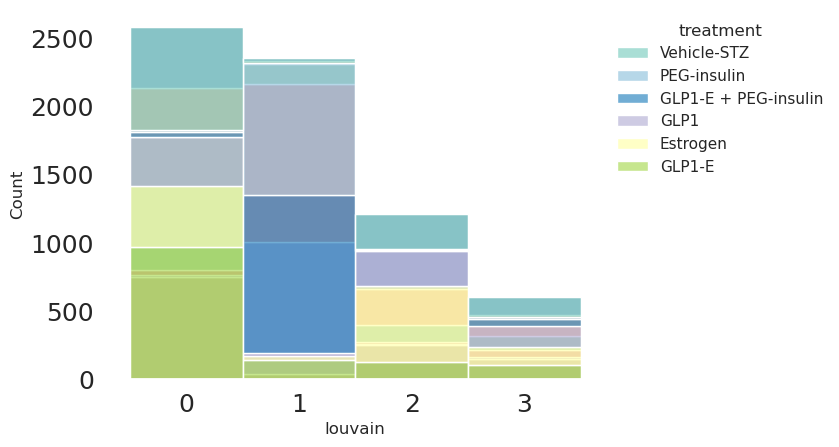

/tmp/ipykernel_48085/3152181182.py:37: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  result_df = df.groupby(['louvain', 'treatment']).size().unstack(fill_value=0)


treatment  Estrogen  GLP1  GLP1-E  GLP1-E + PEG-insulin  PEG-insulin  \
louvain                                                                
0               443   362     972                    36           17   
1                28    22     142                  1160          964   
2               550   260     130                    10            7   
3               134   154     104                    50           15   

treatment  Vehicle-STZ  
louvain                 
0                  750  
1                   41  
2                  253  
3                  146  
treatment   Estrogen       GLP1     GLP1-E  GLP1-E + PEG-insulin  PEG-insulin  \
louvain                                                                         
0          38.354978  45.363409  72.106825              2.866242     1.694915   
1           2.424242   2.756892  10.534125             92.356688    96.111665   
2          47.619048  32.581454   9.643917              0.796178     0.697906   
3          1

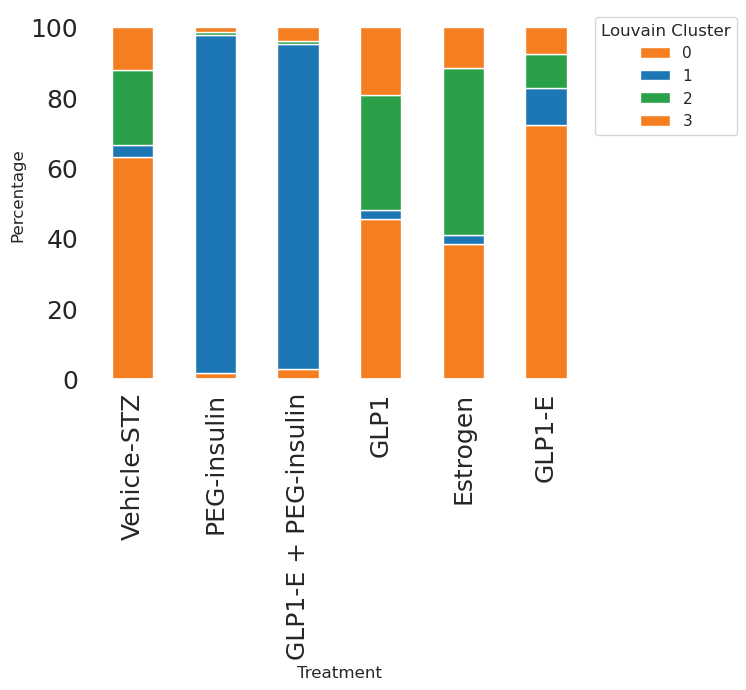

In [827]:
# # naive scanpy gragh
# temp_naive = adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])].copy()
# sc.pp.pca(temp_naive)
# sc.pp.neighbors(temp_naive)
# sc.tl.umap(temp_naive)
# # temp_naive = adata_beta_stz_for_graph.copy()
# sc.tl.louvain(temp_naive, resolution=0.3)
# Calculate the fraction of each treatment in each louvain cluster
# adata_beta_stz_for_graph_scaled_temp = temp_naive.copy()\
color_dict = {
    "color1": "#8dd3c7",
    "color2": "#ffffb3",
    "color3": "#bebada",
    "color4": "#fb8072",
    "color5": "#80b1d3",
    "color6": "#fdb462",
    "color7": "#b3de69",
    "color8": "#fccde5",
    "color9": "#4292c6",
    "color10": "#9ecae1"
}
df = temp_naive.obs
# df["louvain_"] =  pd.Categorical(df['louvain'], ['1','0','2'])
# hue_order = ['beta_STZ','beta_Ins','beta_InsGLP1','beta_GLP1','beta_Est','beta_GLP1E']
hue_order = ['Vehicle-STZ', 'PEG-insulin', 'GLP1-E + PEG-insulin','GLP1',
                       'Estrogen','GLP1-E']
ax = sns.histplot(data=df, x="louvain", hue="treatment", multiple="stack",palette=[color_dict["color1"],color_dict["color10"],color_dict["color9"],color_dict["color3"],color_dict["color2"],color_dict["color7"]],hue_order=hue_order)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
# plt.legend(frameon=False)
leg = ax.get_legend()
leg.set_frame_on(False)
plt.savefig('figures/g_v4.png', dpi=900, bbox_inches='tight')
plt.savefig('figures/g_v4.svg', format='svg', dpi=600)
plt.show()

# Calculate the fraction of each treatment in each louvain cluster
result_df = df.groupby(['louvain', 'treatment']).size().unstack(fill_value=0)
print(result_df)
result_df = result_df.div(result_df.sum(axis=0), axis=1) * 100
print(result_df)

# # Normalize percentages within each treatment group to sum to 100
# result_df = result_df.div(result_df.sum(axis=0), axis=1) * 100
# print(result_df)
#
#change the order of the columns
result_df = result_df[['Vehicle-STZ', 'PEG-insulin', 'GLP1-E + PEG-insulin','GLP1',
                       'Estrogen','GLP1-E']]  # Replace with desired column order
#
# print(result_df)


# Set custom colors
# custom_colors = ['orange', 'lightblue', 'lightgreen']
# custom_colors = ['orange', 'royalblue','lime']
colors_dict = {
    'green': '#2AA148',
    'blue': '#1D77B5',
    'orange': '#F57E20'
}
costum_colors = [colors_dict['orange'],colors_dict['blue'],colors_dict['green']]
#make the fig bigger
# plt.figure(figsize=(20, 12))
# Plot the fractions as a bar plot with custom colors
ax = result_df.T.plot(kind='bar', stacked=True, color=costum_colors, edgecolor='white')

# Add legend and labels
ax.legend(title='Louvain Cluster', bbox_to_anchor=(1, 1))
ax.set_xlabel('Treatment')
ax.set_ylabel('Percentage')

# Print the percentages for each louvain cluster and each treatment
for column, values in result_df.items():
    print(f"Louvain Cluster {column}:")
    for treatment, percentage in values.items():
        print(f"  {treatment}: {percentage:.2f}%")
plt.savefig('figures/k_v2_SUP.png', dpi=600, bbox_inches='tight')
plt.savefig('figures/k_v2_SUP.svg', format='svg', dpi=600)
#save fig as svm file

# Show the plot
plt.show()

In [828]:
temp_adata_beta_stz_for_graph_scaled_with_ctrl = temp_naive.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
corr_classified_list = []
# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
    if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
        corr_classified_list.append('Positive control (healthy)')
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
        corr_classified_list.append("0")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
        corr_classified_list.append("1")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
        corr_classified_list.append("2")
temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list


sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)
average_expression_values_activity_dict = {}
average_expression_dediffy_dict ={}

for cluster in ["0", "1", "2", "Positive control (healthy)"]:
    #if cluster key is not in the dictionary, add it
    if cluster not in average_expression_values_activity_dict:
        average_expression_values_activity_dict[cluster] = []
    if cluster not in average_expression_dediffy_dict:
        average_expression_dediffy_dict[cluster] = []
    temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp[temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation'].isin([cluster])].copy()
    print(temp)
    print(cluster)
    for gene in b_cells_activity:
        gene_index = temp.var_names.get_loc(gene)
        gene_expression_values = temp.X[:, gene_index]
        average_expression_values_activity_dict[cluster].append(np.mean(gene_expression_values))
    for gene in dedef:
        gene_index = temp.var_names.get_loc(gene)
        gene_expression_values = temp.X[:, gene_index]
        average_expression_dediffy_dict[cluster].append(np.mean(gene_expression_values))

# Calculate the final average of the average gene expression values

print(average_expression_values_activity_dict)
print(average_expression_dediffy_dict)
#convert the dictionary so that each list will be the mean value of the gene expression values
for cluster in average_expression_values_activity_dict:
    average_expression_values_activity_dict[cluster] = np.mean(average_expression_values_activity_dict[cluster])
    average_expression_dediffy_dict[cluster] = np.mean(average_expression_dediffy_dict[cluster])
print(average_expression_values_activity_dict)
print(average_expression_dediffy_dict)
#plot bott dicts in the same plot and change order of the bars
fig, ax = plt.subplots()
# the order 1,0,2 is the order of the clusters
ax.bar(average_expression_values_activity_dict.keys(), average_expression_values_activity_dict.values(), label='Activity/maturation')
ax.bar(average_expression_dediffy_dict.keys(), average_expression_dediffy_dict.values(), label='Dedifferentiation')
ax.legend()
#move the legend out of the plot
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))


plt.show()
temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
print()

/tmp/ipykernel_48085/3613728790.py:3: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
/tmp/ipykernel_48085/3613728790.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
/tmp/ipykernel_48085/3613728790.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

ValueError: Length of values (11811) does not match length of index (12414)

In [ ]:
ctrl_mean = np.mean(adata_beta_ctrl.X.toarray(), axis=0)
all_treated_list = []
for cluster in ['0','1','2']:
    temp = temp_naive[temp_naive.obs["louvain"].isin([cluster])].copy()


    adata_beta_only_all_treated_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_Ins','beta_GLP1','beta_InsGLP1','beta_Est','beta_GLP1E'])]


    all_treated_mean_temp = np.mean(adata_beta_only_all_treated_temp.X.toarray(), axis=0)

    adata_beta_only_all_treated_temp = temp[temp.obs['groups_named_broad_cond'].isin(['beta_Ins','beta_InsGLP1'])]
    print("cluster: " + cluster)
    print(adata_beta_only_all_treated_temp)




    all_treated_list.append(np.linalg.norm(ctrl_mean-all_treated_mean_temp))
plt.figure(figsize=(14,14))
plt.bar(np.arange(0,3), all_treated_list)
plt.xticks(np.arange(0,3), ['0','1','2'])
plt.xlabel('Cluster')
plt.ylabel('Distance from Ctrl cells')
plt.title('Distance  all treated cells from Ctrl cells for each cluster')
plt.show()

In [ ]:
# import pandas as pd
# from sklearn.preprocessing import LabelEncoder
# import scanpy as sc
#
# # Assuming adata is your AnnData object and 'category_column' is the categorical column
# category_column = adata_beta_stz_for_graph_scaled.obs['louvain']
#
# # Create a pandas DataFrame with the category column
# df = pd.DataFrame({'category_column': category_column})
#
# # Create a LabelEncoder
# label_encoder = LabelEncoder()
#
# # Fit and transform the categorical column
# df['numeric_values'] = label_encoder.fit_transform(df['category_column'])
#
# # Add the numeric values back to the AnnData object
# adata_beta_stz_for_graph_scaled.obs['numeric_values'] = df['numeric_values']
# gene_index = adata_beta_stz_for_graph_scaled.var_names.get_loc('Ins1')
# gene_expression_values_ins1 = adata_beta_stz_for_graph_scaled.X[:, gene_index]
#
# gene_index = adata_beta_stz_for_graph_scaled.var_names.get_loc('Ins2')
# gene_expression_values_ins2 = adata_beta_stz_for_graph_scaled.X[:, gene_index]
#
# plt.scatter(gene_expression_values_ins1, gene_expression_values_ins1, c=adata_beta_stz_for_graph_scaled.obs['numeric_values'][:],s=10,cmap='viridis')
# # plt.show()
# adata_beta_stz_for_graph_scaled.obs['louvain']

In [ ]:
# # sc.pl.scatter(adata, x='some_x_axis_variable', y='some_y_axis_variable', color='louvain', show=False)
# # plt.show()
# sc.pl.scatter(adata, x='Ins1', y='Ins1', color='louvain')

In [ ]:
# gene1 = 'Ins1'
# gene2 = 'Ins2'
# list1,list2 = list(beta_cells_genes_dict.values())
# genes = sum(list(beta_cells_genes_dict.values()), [])
#
# for gene1 in genes:
#     for gene2 in genes:
#         if gene1 == gene2:
#             continue
#         gene_index = adata_beta_stz_for_graph_scaled.var_names.get_loc(gene1)
#         gene_expression_values_ins1 = adata_beta_stz_for_graph_scaled.X[:, gene_index]
#
#         gene_index = adata_beta_stz_for_graph_scaled.var_names.get_loc(gene2)
#         gene_expression_values_ins2 = adata_beta_stz_for_graph_scaled.X[:, gene_index]
#
#         plt.scatter(gene_expression_values_ins1, gene_expression_values_ins2, c=adata_beta_stz_for_graph_scaled.obs['numeric_values'][:],s=1)
#         plt.title(f'Violin Plot for {gene1} and {gene2}')
#         #show color bar
#         plt.colorbar()
#         plt.xlabel(gene1)
#         plt.ylabel(gene2)
#         plt.show()


In [ ]:
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
corr_classified_list = []
# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
    if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
        corr_classified_list.append('Positive control (healthy)')
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
        corr_classified_list.append("Seak")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
        corr_classified_list.append("mid")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
        corr_classified_list.append("healthy")
temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list
sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)
ax = sc.pl.dotplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='YlGn',categories_order=["Seak","mid","healthy",'Positive control (healthy)'],vmin=-1.5,vmax=1.5)

ax = sc.pl.matrixplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',categories_order=["Seak","mid","healthy",'Positive control (healthy)'],vmin=-1.5,vmax=1.5,save='beta_cells_c_v2.png')


temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp[temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'].isin(["beta_Ins","beta_InsGLP1","beta_Ctrl"])]
temp_ = temp[temp.obs['annotation'].isin(['Positive control (healthy)',"mid","healthy"])]




# corr_classified_list = []
#
# for i in range(temp_.n_obs):
#     if temp_.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
#         corr_classified_list.append('Positive control (healthy)')
#     # elif temp.obs['louvain'][i]=='1':
#     #     corr_classified_list.append("Seak")
#     elif temp_.obs['louvain'][i]=='0':
#         corr_classified_list.append("mid")
#     elif temp_.obs['louvain'][i]=='2':
#         corr_classified_list.append("healthy")
#
# temp_.obs['annotation']=corr_classified_list
# sc.pp.scale(temp_)
ax = sc.pl.dotplot(temp_, beta_cells_genes_dict, groupby='annotation',cmap='YlGn',vmin=-1.5,vmax=1.5)
ax = sc.pl.matrixplot(temp_, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5)


In [ ]:
adata_beta_stz_for_graph

In [ ]:
sc.tl.louvain(adata_beta_stz_for_graph, resolution=0.4)
sc.pl.umap(adata_beta_stz_for_graph,color=['louvain'])
sc.pl.umap(adata_beta_stz_for_graph,color=['conf'])
sc.pl.umap(adata_beta_stz_for_graph,color=['var'])
sc.pl.umap(adata_beta_stz_for_graph,color=['conf_position'])
sc.pl.umap(adata_beta_stz_for_graph,color=['var_position'])
sc.pl.umap(adata_beta_stz_for_graph,color=['groups_named_broad_cond'])
adata_beta_stz_for_graph_scaled = adata_beta_stz_for_graph.copy()
sc.pp.scale(adata_beta_stz_for_graph_scaled)
# adata_beta_stz_for_graph_scaled = adata_beta_stz_for_graph_scaled.obs['groups_named_broad_cond'].isin['beta_STZ','beta_Ins']
#
# adata_stz = adata[adata.obs['groups_named_broad_cond'].isin(['beta_STZ','beta_GLP1','beta_Ins','beta_InsGLP1','beta_Est','beta_GLP1E',
#                                                              'alpha_STZ','alpha_GLP1','alpha_Ins','alpha_InsGLP1','alpha_Est','alpha_GLP1E',
#                                                              'delta_STZ','delta_GLP1','delta_Ins','delta_InsGLP1','delta_Est','delta_GLP1E',])]


# ax = sc.pl.matrixplot(adata_beta_stz_for_graph_scaled, beta_cells_genes_dict, groupby='louvain',cmap='BrBG')
# ax = sns.histplot(data=adata_beta_stz_for_graph_scaled.obs, x="louvain", hue="treatment", multiple="stack")
# sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

In [ ]:
#fig c and j
beta_cells_genes_dict= {
    'Beta cells activity':['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2',  'Slc30a8', 'Ucn3'],
    'Beta cells dedifferentiation':['Aldh1a3', 'Serpina7']
                   }
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
corr_classified_list = []
# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
# for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
#     if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
#         corr_classified_list.append('Positive control (healthy)')
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
#         corr_classified_list.append("Seak")
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
#         corr_classified_list.append("mid")
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
#         corr_classified_list.append("healthy")
# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list
order= ['3',"4","1","2","0"]
sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)
ax = sc.pl.dotplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='louvain',cmap='RdYlBu',vmin=-1.5,vmax=1.5,
                    categories_order=order)
ax = sc.pl.matrixplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='louvain',cmap='RdYlBu',vmin=-1.5,vmax=1.5,
                      categories_order=order)
sc.tl.louvain(adata_beta_stz_for_graph, resolution=0.4)
sc.pl.umap(adata_beta_stz_for_graph, color=['louvain'])
sc.pl.umap(adata_beta_stz_for_graph, color=['conf'])
sc.pl.umap(adata_beta_stz_for_graph, color=['var'])
sc.pl.umap(adata_beta_stz_for_graph, color=['conf_position'])
sc.pl.umap(adata_beta_stz_for_graph, color=['var_position'])
sc.pl.umap(adata_beta_stz_for_graph, color=['groups_named_broad_cond'])
adata_beta_stz_for_graph_scaled = adata_beta_stz_for_graph.copy()
sc.pp.scale(adata_beta_stz_for_graph_scaled)

In [ ]:
adata_beta_stz_for_graph = adata_beta_stz.copy()

connectivities_graph , distance_graph  = metrics.make_conf_graph(adata_beta_stz_for_graph.copy(), alpha=0.65 , k=15)

adata_beta_stz_for_graph.obsp['connectivities']=sparse.csr_matrix(connectivities_graph)
sc.tl.umap(adata_beta_stz_for_graph)
sc.pl.umap(adata_beta_stz_for_graph, color=['conf','var'])
sc.pl.umap(adata_beta_stz_for_graph,color=['groups_named_broad_cond'])
sc.pl.umap(adata_beta_stz_for_graph,color=['conf'])
sc.pl.umap(adata_beta_stz_for_graph,color=['conf'],color_map='RdYlBu',save="conf_beta_stz.svg")
sc.pl.umap(adata_beta_stz_for_graph,color=['var'])
# sc.pl.umap(adata_beta_stz_for_graph,color=['annotation'])


sorted_indices_conf = np.argsort(adata_beta_stz_for_graph.obs['conf'])
positions_conf = np.empty_like(sorted_indices_conf)
positions_conf[sorted_indices_conf] = np.arange(len((adata_beta_stz_for_graph.obs['conf'])))
n = len(sorted_indices_conf)

mean_distance_conf = metrics.mean_absolute_distance(n)





sorted_indices_var = np.argsort(adata_beta_stz.obs['var'])
positions_var = np.empty_like(sorted_indices_var)
positions_var[sorted_indices_var] = np.arange(len((adata_beta_stz.obs['var'])))





adata_beta_stz.obs['var_position'] = positions_var/mean_distance_conf
adata_beta_stz.obs['conf_position'] = positions_conf/mean_distance_conf

/tmp/ipykernel_48085/2359216787.py:7: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarn

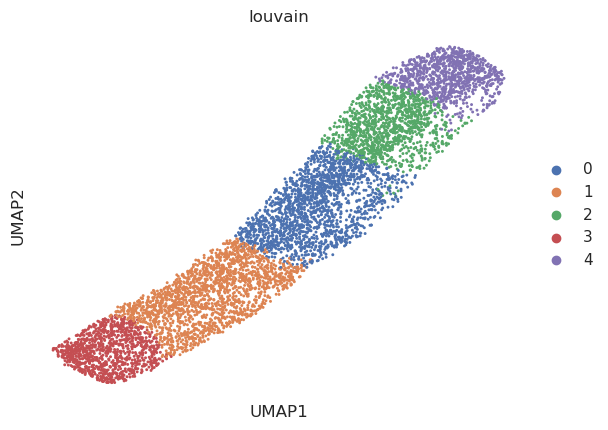

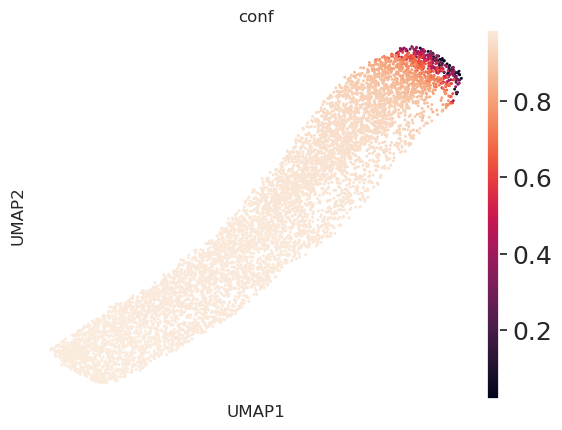

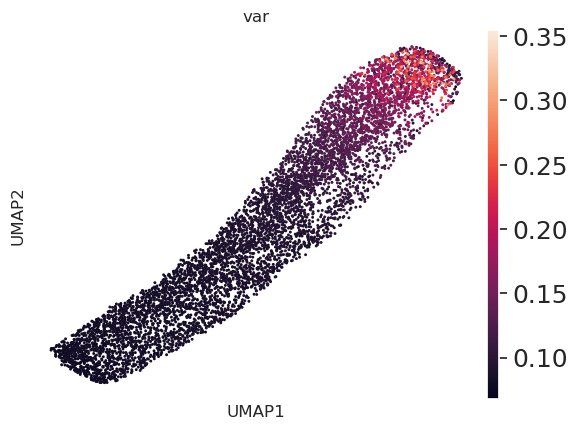

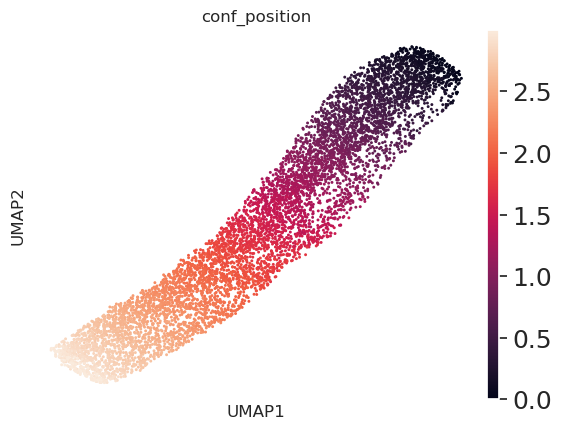

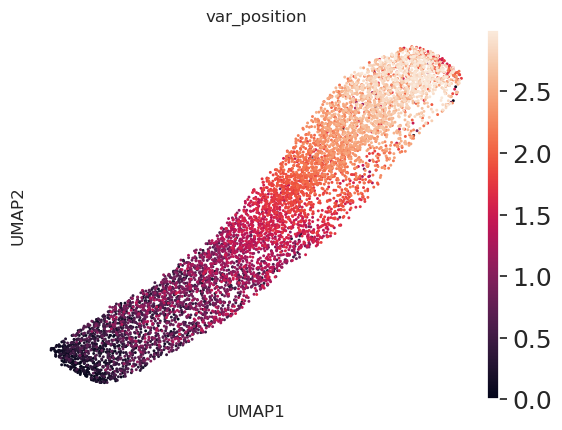

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


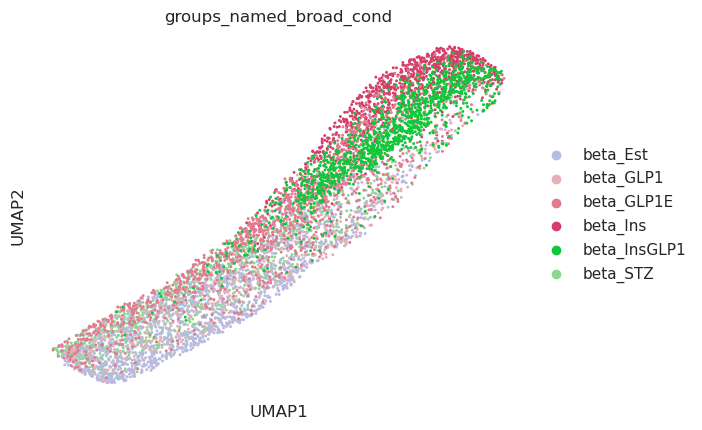

In [846]:
beta_cells_genes_dict= {
    'Beta cells activity':['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2',  'Slc30a8', 'Ucn3'],
    'Beta cells dedifferentiation':['Aldh1a3', 'Serpina7']
                   }
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])

# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
# for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
#     if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
#         corr_classified_list.append('Positive control (healthy)')
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
#         corr_classified_list.append("Seak")
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
#         corr_classified_list.append("mid")
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
#         corr_classified_list.append("healthy")
# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list
sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)

sc.tl.louvain(adata_beta_stz_for_graph, resolution=0.4)
sc.pl.umap(adata_beta_stz_for_graph, color=['louvain'])
sc.pl.umap(adata_beta_stz_for_graph, color=['conf'])
sc.pl.umap(adata_beta_stz_for_graph, color=['var'])
sc.pl.umap(adata_beta_stz_for_graph, color=['conf_position'])
sc.pl.umap(adata_beta_stz_for_graph, color=['var_position'])
sc.pl.umap(adata_beta_stz_for_graph, color=['groups_named_broad_cond'])

# ax = sc.pl.matrixplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='louvain',cmap='RdYlBu',vmin=-1.5,vmax=1.5)

/tmp/ipykernel_48085/60308591.py:8: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
/tmp/ipykernel_48085/60308591.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
/tmp/ipykernel_48085/60308591.py:14: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be tre

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' 

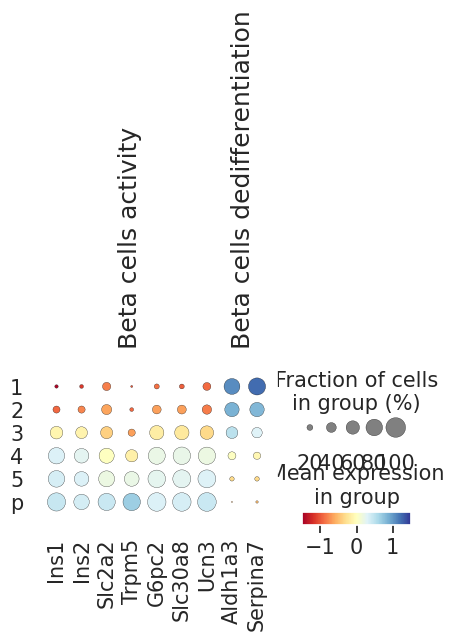

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


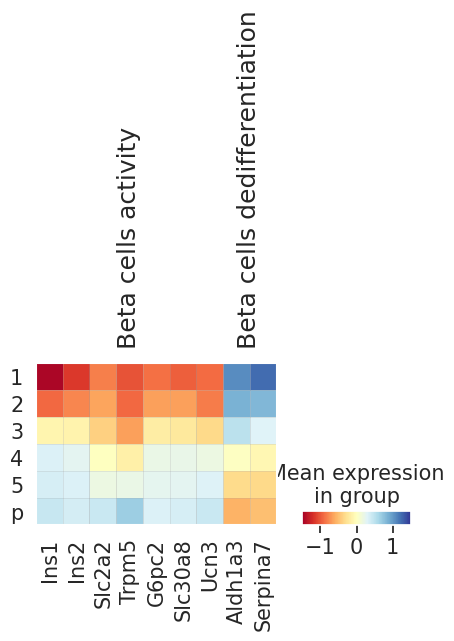

In [851]:
#fig c and j
beta_cells_genes_dict= {
    'Beta cells activity':['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2',  'Slc30a8', 'Ucn3'],
    'Beta cells dedifferentiation':['Aldh1a3', 'Serpina7']
                   }
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
corr_classified_list = []
temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
    if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
        corr_classified_list.append('p')
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='3':
        corr_classified_list.append("1")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
        corr_classified_list.append("2")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
        corr_classified_list.append("3")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
        corr_classified_list.append("4")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='4':
        corr_classified_list.append("5")
temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list
order= ['3',"1","0","2","4"]
order = ["1","2","3","4","5","p"]
sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)
ax = sc.pl.dotplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,
                    categories_order=order,save="beta_cells_genes_louvain_5_dot.png")
ax = sc.pl.matrixplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,
                      categories_order=order,save="beta_cells_genes_louvain_5.png")

/tmp/ipykernel_48085/2249129900.py:7: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])


/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


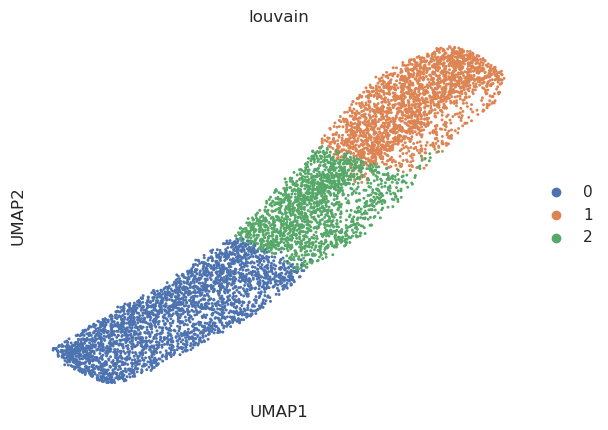

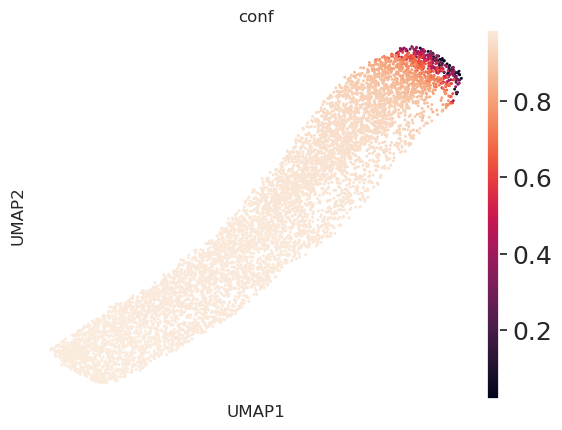

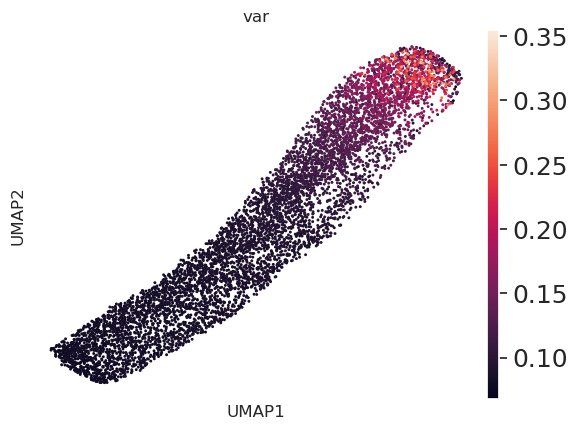

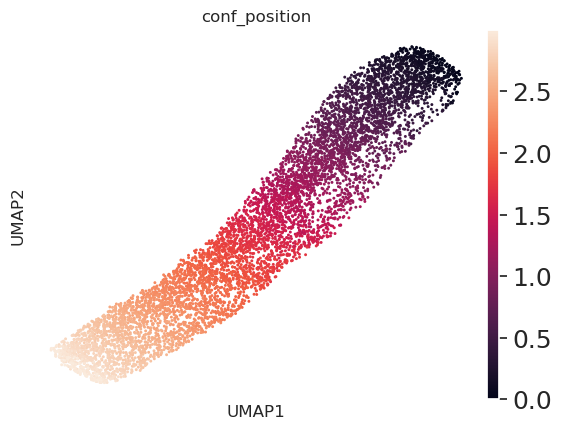

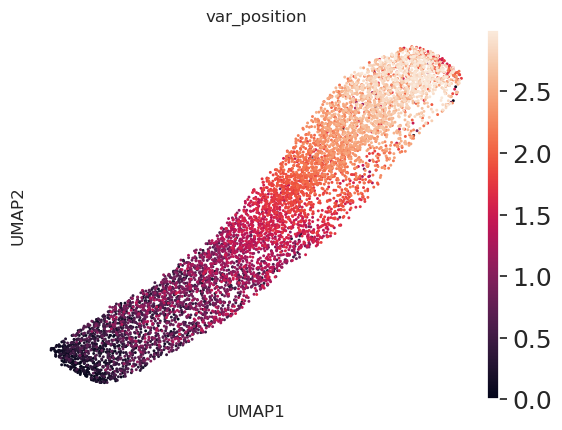

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


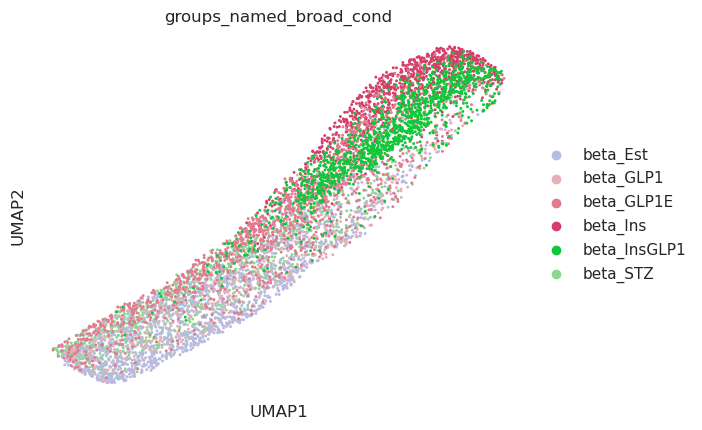

In [861]:
beta_cells_genes_dict= {
    'Beta cells activity':['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2',  'Slc30a8', 'Ucn3'],
    'Beta cells dedifferentiation':['Aldh1a3', 'Serpina7']
                   }
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])

# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
# for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
#     if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
#         corr_classified_list.append('Positive control (healthy)')
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
#         corr_classified_list.append("Seak")
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
#         corr_classified_list.append("mid")
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
#         corr_classified_list.append("healthy")
# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list
sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)

sc.tl.louvain(adata_beta_stz_for_graph, resolution=0.2)
sc.pl.umap(adata_beta_stz_for_graph, color=['louvain'],save="louvain_3_sup.png")
sc.pl.umap(adata_beta_stz_for_graph, color=['conf'])
sc.pl.umap(adata_beta_stz_for_graph, color=['var'])
sc.pl.umap(adata_beta_stz_for_graph, color=['conf_position'])
sc.pl.umap(adata_beta_stz_for_graph, color=['var_position'])
sc.pl.umap(adata_beta_stz_for_graph, color=['groups_named_broad_cond'])


/tmp/ipykernel_48085/47346114.py:8: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
/tmp/ipykernel_48085/47346114.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
/tmp/ipykernel_48085/47346114.py:14: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be tre

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


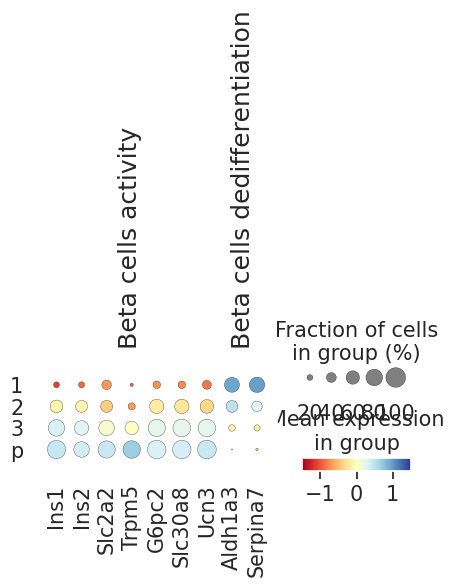

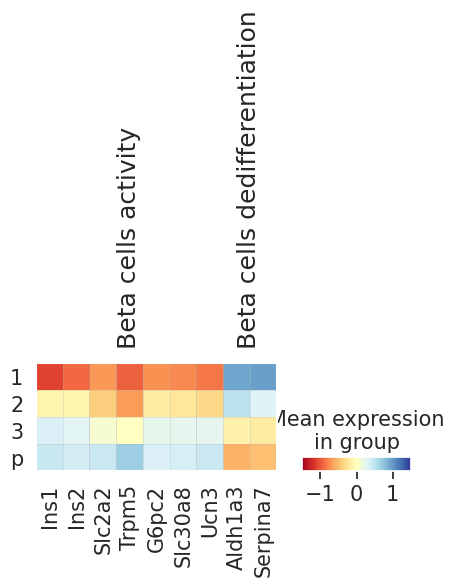

In [862]:
#fig c and j
beta_cells_genes_dict= {
    'Beta cells activity':['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2',  'Slc30a8', 'Ucn3'],
    'Beta cells dedifferentiation':['Aldh1a3', 'Serpina7']
                   }
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
corr_classified_list = []
temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
    if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
        corr_classified_list.append('p')
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
        corr_classified_list.append("1")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
        corr_classified_list.append("2")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
        corr_classified_list.append("3")

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list
order= ['3',"1","0","2","4"]
order = ["1","2","3","p"]
sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)
ax = sc.pl.dotplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,
                    categories_order=order,show=False)
# ax = sc.pl.dotplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,categories_order=order,show=False)
ax['mainplot_ax'].get_figure().savefig('figures/beta_cells_genes_louvain_3_sup_dot.png',dpi=600)
ax = sc.pl.matrixplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,
                      categories_order=order,save="beta_cells_genes_louvain_3_sup.png")

/tmp/ipykernel_48085/1529478540.py:7: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])


/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


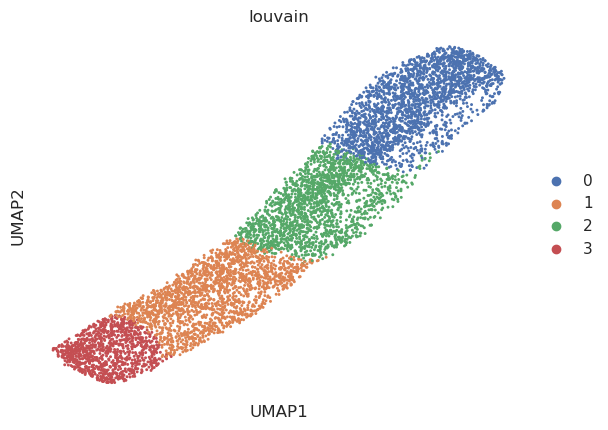

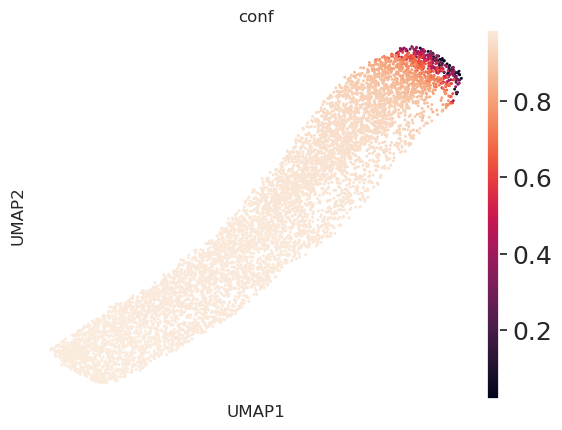

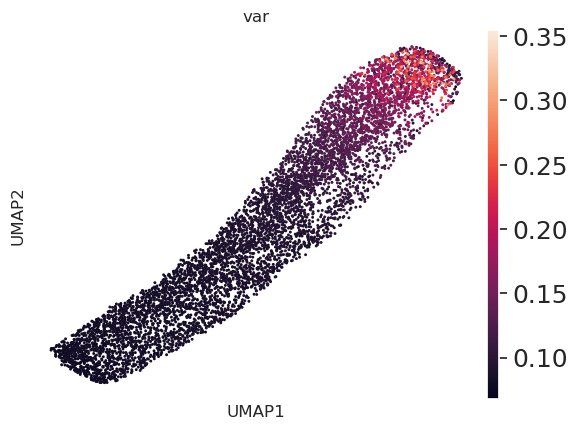

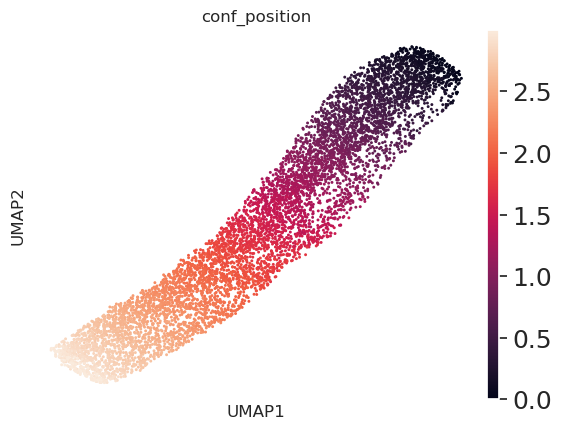

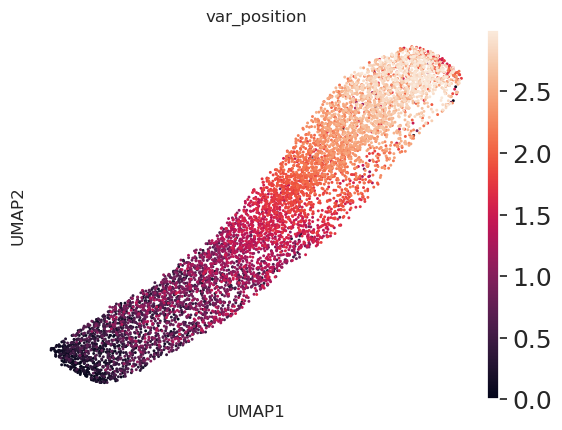

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


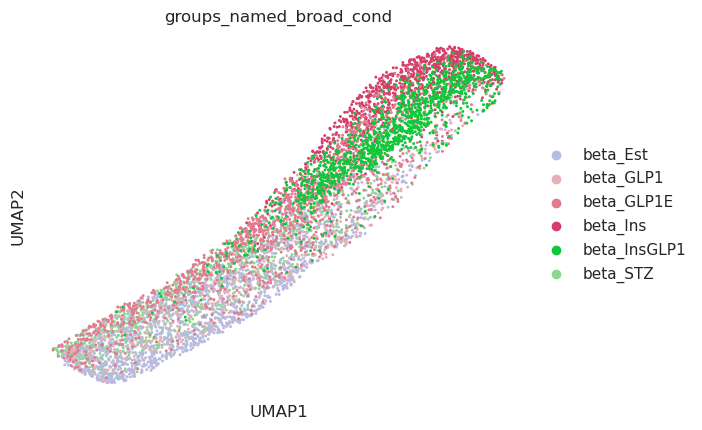

In [863]:
beta_cells_genes_dict= {
    'Beta cells activity':['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2',  'Slc30a8', 'Ucn3'],
    'Beta cells dedifferentiation':['Aldh1a3', 'Serpina7']
                   }
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])

# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
# for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
#     if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
#         corr_classified_list.append('Positive control (healthy)')
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
#         corr_classified_list.append("Seak")
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
#         corr_classified_list.append("mid")
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
#         corr_classified_list.append("healthy")
# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list
sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)

sc.tl.louvain(adata_beta_stz_for_graph, resolution=0.3)
sc.pl.umap(adata_beta_stz_for_graph, color=['louvain'],save="louvain_4_sup.png")
sc.pl.umap(adata_beta_stz_for_graph, color=['conf'])
sc.pl.umap(adata_beta_stz_for_graph, color=['var'])
sc.pl.umap(adata_beta_stz_for_graph, color=['conf_position'])
sc.pl.umap(adata_beta_stz_for_graph, color=['var_position'])
sc.pl.umap(adata_beta_stz_for_graph, color=['groups_named_broad_cond'])


/tmp/ipykernel_48085/4269571359.py:8: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
/tmp/ipykernel_48085/4269571359.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
/tmp/ipykernel_48085/4269571359.py:14: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always 

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


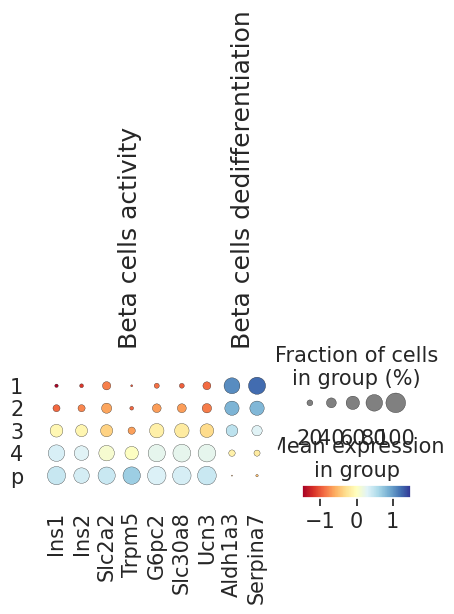

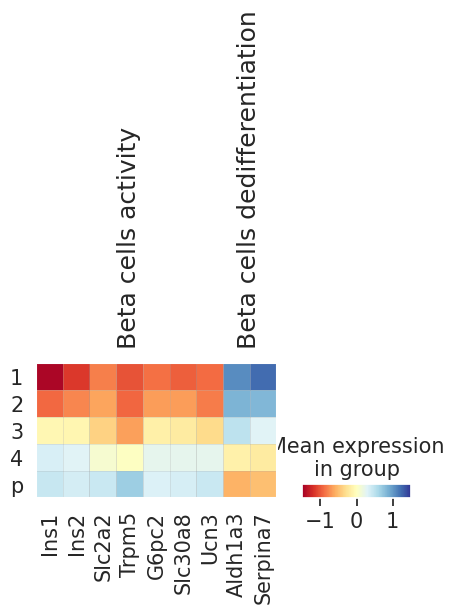

In [864]:
#fig c and j
beta_cells_genes_dict= {
    'Beta cells activity':['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2',  'Slc30a8', 'Ucn3'],
    'Beta cells dedifferentiation':['Aldh1a3', 'Serpina7']
                   }
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
corr_classified_list = []
temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
    if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
        corr_classified_list.append('p')
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='3':
        corr_classified_list.append("1")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
        corr_classified_list.append("2")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
        corr_classified_list.append("3")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
        corr_classified_list.append("4")


temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list
order= ['3',"1","0","2","4"]
order = ["1","2","3","4","p"]
sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)
ax = sc.pl.dotplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,
                    categories_order=order,show=False)
# ax = sc.pl.dotplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,categories_order=order,show=False)
ax['mainplot_ax'].get_figure().savefig('figures/beta_cells_genes_louvain_4_sup_dot.png',dpi=600)
ax = sc.pl.matrixplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,
                      categories_order=order,save="beta_cells_genes_louvain_4_sup.png")

In [869]:
beta_cells_genes_dict= {
    'Beta cells activity':['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2',  'Slc30a8', 'Ucn3'],
    'Beta cells dedifferentiation':['Aldh1a3', 'Serpina7']
                   }
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])

# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
# for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
#     if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
#         corr_classified_list.append('Positive control (healthy)')
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
#         corr_classified_list.append("Seak")
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
#         corr_classified_list.append("mid")
#     elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
#         corr_classified_list.append("healthy")
# temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list
sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)

sc.tl.louvain(adata_beta_stz_for_graph, resolution=0.4)
sc.pl.umap(adata_beta_stz_for_graph, color=['louvain'],save="louvain_5_sup.png")
sc.pl.umap(adata_beta_stz_for_graph, color=['conf'])
sc.pl.umap(adata_beta_stz_for_graph, color=['var'])
sc.pl.umap(adata_beta_stz_for_graph, color=['conf_position'])
sc.pl.umap(adata_beta_stz_for_graph, color=['var_position'])
sc.pl.umap(adata_beta_stz_for_graph, color=['groups_named_broad_cond'])


/tmp/ipykernel_48085/3770355661.py:7: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarn

AttributeError: PathCollection.set() got an unexpected keyword argument 'legend_order'

/tmp/ipykernel_48085/3388571459.py:8: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
/tmp/ipykernel_48085/3388571459.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
/tmp/ipykernel_48085/3388571459.py:14: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always 

/cs/labs/ravehb/reshem/miniconda3/envs/py39dy/lib/python3.9/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


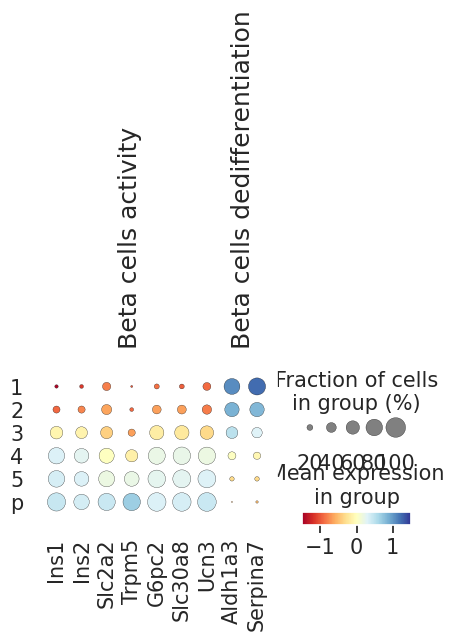

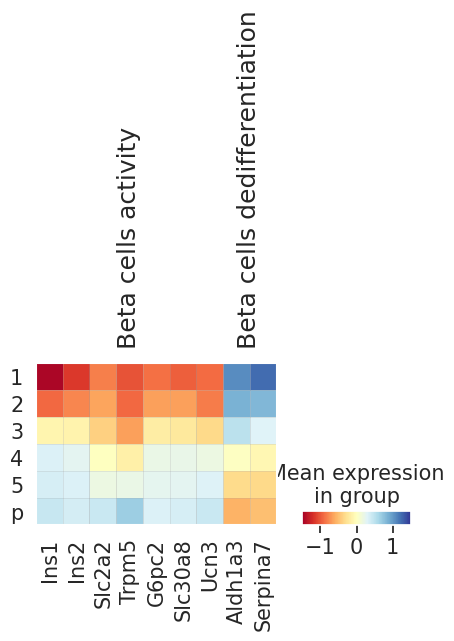

In [868]:
#fig c and j
beta_cells_genes_dict= {
    'Beta cells activity':['Ins1', 'Ins2', 'Slc2a2', 'Trpm5', 'G6pc2',  'Slc30a8', 'Ucn3'],
    'Beta cells dedifferentiation':['Aldh1a3', 'Serpina7']
                   }
temp_adata_beta_stz_for_graph_scaled_with_ctrl = adata_beta_stz_for_graph.copy()

temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp = temp_adata_beta_stz_for_graph_scaled_with_ctrl.concatenate(adata_stz_ctrl[adata_stz_ctrl.obs['groups_named_broad_cond'].isin(["beta_Ctrl"])])
corr_classified_list = []
temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp
for i in range(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.n_obs):
    if temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['groups_named_broad_cond'][i]=='beta_Ctrl':
        corr_classified_list.append('p')
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='3':
        corr_classified_list.append("1")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='1':
        corr_classified_list.append("2")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='0':
        corr_classified_list.append("3")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='2':
        corr_classified_list.append("4")
    elif temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['louvain'][i]=='4':
        corr_classified_list.append("5")


temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp.obs['annotation']=corr_classified_list
order= ['3',"1","0","2","4"]
order = ["1","2","3","4","5","p"]
sc.pp.scale(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp)
ax = sc.pl.dotplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,
                    categories_order=order,show=False)
# ax = sc.pl.dotplot(temp_annotation_scaled, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,categories_order=order,show=False)
ax['mainplot_ax'].get_figure().savefig('figures/beta_cells_genes_louvain_5_sup_dot.png',dpi=600)
ax = sc.pl.matrixplot(temp_adata_beta_stz_for_graph_scaled_with_ctrl_temp, beta_cells_genes_dict, groupby='annotation',cmap='RdYlBu',vmin=-1.5,vmax=1.5,
                      categories_order=order,save="beta_cells_genes_louvain_5_sup.png")